## Accounting Data

In [1]:
!pip install plotly==5.19.0

^C
ERROR: Operation cancelled by user


In [1]:
%load_ext autoreload
%autoreload 2

In [1]:
import sovai as sov
import pandas as pd
# Set the option to display all columns
pd.set_option('display.max_columns', None)

sov.basic_auth("your_email@example.com", "your_password")
# And then continue working with get some data from API and manipulating them

/breakout/median
Requesting URL: https://fastapi-sovai-y7o724zyfq-uc.a.run.app/breakout/median with params: None
Response Status: 200
Response Content-Type: application/json
tickers is None
None
tickers is: 
All ticker Initialized
https://s3.wasabisys.com/sovai-breakout-price/frames/df_test_summary_median.park?AWSAccessKeyId=KI07G4DK9XP5EC0NH1VU&Signature=tc1cOFg9sS3wwL00Tokx40zKvDI%3D&Expires=1709193292  (download link)
File is up-to-date, no need to download.


True

#### Processed Dataset

In [222]:
df_tickers = pd.read_parquet("data/tickers.parq")

In [230]:
ticks = df_tickers.drop_duplicates("ticker").sample(300)["ticker"].to_list()

In [231]:
tickers = ["DAL", "AAL", "AMZN", "A", "AAA", "MMM", "DDD", "MSFT", "TSLA", "META",
           "GOOGL", "AAPL", "IBM", "NFLX", "NVDA", "JPM", "BAC", "V", "PG", "KO"]

df_accounting = sov.data("accounting/weekly", tickers=ticks, purge_cache=True)

/accounting/weekly
Requesting URL: https://fastapi-sovai-y7o724zyfq-uc.a.run.app/accounting/weekly with params: {'tickers': 'RTW1,SETM,TXCCQ,ADVBQ,DECTF,CAPL,IPXX,BLDE,DAWKQ,GVT1,SVRA,RJF-PA,NCFT,INDZ,WFCF,JERT,GFNCP,SHV,VNSE,OPRT,FMBIP,CCS,SHSO,LDTCW,WHHT,NUSC,LOPX,HHLA.U,SANG1,NVS,BOSA,SWCB1,MCKC,SH1,PRXL,BDLSQ,APCB,FLNC,FRWAW,FLGC,VJV,SONG,JOJO,TNONW,HOSTQ,AJSB,BRR,SPYD,MGAM,KWT1,MLTC1,ZTAX,BLBX,ESIC,TADS,MAPSW,HSPOW,BRLS1,DSHK,EYEG,BPZRQ,DFCO1,MDII1,CRXA,LOUD,DSPT,EUCG,APMU,KMED,EWCZ,WNG1,VMI,HSPO,PANW,PYPT,UBNK1,CD,MYR1,SGL,BTCS,GGXY,PCOR,BSCL,CRRTQ,MUF,CSSEL,FKKY,FTXL,HBFW,BWC,SPMV,NLG,INCB,ADBE,CCXE,CPA,GHC,LAES,FISK,WEN,SOSO,IONR,CDTTW,PHH,ACII,FUSE.U,RURL,EP-PC,MOTV.U,LWNTF,VLYWW,BUNL,PNNT,SCHQ,CMPOW,CMTI,LCGI,FARO,SDOG,HYAC.WS,THACU,IJJ,SLR,PTN,NEO,HBI,ESMV,SGP,DSGR1,SDIV,YUM,DIVG,FNX,PCM,REVBU,VTAL,LOOP,KNTH,TDVG,FCVT,DSAQ.WS,MTIN,KENT,CLV1,SMFG,GLBL1,IGACW,KIM-PJ,VMCAU,ADGE,SSUTF,FMF,KYCHR,SB-PC,CWONQ,CVONW,FDM,DZK,SLRX,CBRGW,ARTG,CFTP,ROK,TBLAW,MDWT,IBER.U,PEO,RIVL,CHLD,LG

In [451]:
## Let's look at causality

In [ ]:
df_filtered = remove_ticks(df_accounting)
df_total_revenue = df_filtered.reset_index()[['date', 'ticker', 'total_revenue']]

# Pivot the DataFrame
df_pivoted = df_total_revenue.reset_index().pivot(index='date', columns='ticker', values='total_revenue')

df_pivoted = df_pivoted.dropna(axis=1, how="all")

df_pivoted = df_pivoted.rank(pct=True)


# Assuming df_pivoted is your existing dataframe
# Calculate row-wise mean
row_means = df_pivoted.mean(axis=1)

# Replace NaN values in each row with the row's mean
df_pivoted = df_pivoted.T.fillna(row_means).T

# Now df_pivoted contains the original values with NaN replaced by row-wise mean


In [507]:
df_pivoted.tail()

ticker,ADBE,ADGE,AJSB,ALLO,ALXN,ANLG,APPHQ,ARRO,ARTG,ARTT,BDLSQ,BGFV,BLBX,BLDE,BOSA,BOX1,BPZRQ,BRLS1,BRR,BTCS,BTH,BVH,CAPL,CATX1,CBMG,CCJ,CCS,CD,CFTP,CHPT,CLE,CLV1,CMTI,CPLG,CRRTQ,CRXA,CTRA,CWONQ,CYBI,DAWKQ,DECTF,DFCO1,DNUT,DOGZ,DRAI,DROV,DSGR1,DSHK,DSPT,DWSN,ESIC,ETSY,EWCZ,FARO,FESX,FFDB,FICO,FKKY,FLGC,FLNC,FOUR2,FRGT,GBTB,GGXY,GHC,GIGA,GLBL1,GMIL,GP1,GPN,HBFW,HBI,HOSTQ,IBLTZ,IFRX,INBX,INCB,INFI,ITYCQ,JERT,KENT,KESNQ,KNSL,KNTH,LAES,LCGI,LOOP,LOUD,LWNTF,LXR,MBWM,MCKC,MDII1,MDWT,MEAD,MGN1,MICN,MLTC1,MSEL,MTIN,MYR1,NCFT,NEO,NFX,NLG,NN,NVS,OM,OPRT,PANW,PCOR,PFGC1,PHH,PNNT,PRKS,PRXL,PSB,PTN,RIVL,ROAD1,ROK,RURL,SANG1,SENS,SGP,SHSO,SKE1,SLR,SLRX,SNTO,SONG,SOSO,STRS,SVRA,SWCB1,TXCCQ,UBNK1,ULY,UPHN,VFC,VMI,VRNT,VTAL,WCG,WEN,WFCF,WHHT,WNG1,XENT,YUM
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2024-01-12,0.998581,0.746962,0.746962,0.478648,0.746962,0.746962,0.746962,0.746962,0.746962,0.746962,0.746962,0.576549,0.567073,0.970213,0.746962,0.746962,0.746962,0.746962,0.746962,0.787234,0.746962,0.869527,0.939189,0.746962,0.746962,0.885110,0.915020,0.746962,0.746962,0.715481,0.746962,0.746962,0.746962,0.746962,0.746962,0.746962,0.938746,0.746962,0.746962,0.746962,0.746962,0.746962,0.701439,0.746962,0.746962,0.746962,0.746962,0.746962,0.746962,0.590877,0.746962,0.897186,0.820896,0.818745,0.746962,0.746962,0.974468,0.746962,0.767123,0.648,0.746962,0.576271,0.746962,0.746962,0.904915,0.904105,0.746962,0.746962,0.746962,0.979866,0.746962,0.503240,0.746962,0.746962,0.977204,0.201087,0.746962,0.746962,0.746962,0.746962,0.746962,0.746962,0.979798,0.746962,0.746962,0.746962,0.876777,0.746962,0.746962,0.746962,0.989267,0.746962,0.746962,0.923742,0.746962,0.746962,0.746962,0.746962,0.746962,0.746962,0.746962,0.746962,0.993767,0.746962,0.746962,0.845714,0.380553,0.721311,0.199134,0.964463,0.948276,0.746962,0.746962,0.799542,0.97861,0.746962,0.746962,0.616302,0.746962,0.746962,0.962411,0.746962,0.746962,0.91866,0.746962,0.746962,0.746962,0.746962,0.199367,0.746962,0.746962,0.746962,0.276709,0.427966,0.746962,0.746962,0.746962,0.3375,0.746962,0.784188,0.954416,0.556338,0.746962,0.746962,0.786529,0.976693,0.746962,0.746962,0.746962,0.284173
2024-01-19,0.998581,0.746938,0.746938,0.478648,0.746938,0.746938,0.746938,0.746938,0.746938,0.746938,0.746938,0.576549,0.567073,0.970213,0.746938,0.746938,0.746938,0.746938,0.746938,0.787234,0.746938,0.869527,0.939189,0.746938,0.746938,0.891544,0.966403,0.746938,0.746938,0.715481,0.746938,0.746938,0.746938,0.746938,0.746938,0.746938,0.938746,0.746938,0.746938,0.746938,0.746938,0.746938,0.701439,0.746938,0.746938,0.746938,0.746938,0.746938,0.746938,0.590877,0.746938,0.897186,0.820896,0.818745,0.746938,0.746938,0.972695,0.746938,0.767123,0.616,0.746938,0.576271,0.746938,0.746938,0.904915,0.904105,0.746938,0.746938,0.746938,0.979027,0.746938,0.493521,0.746938,0.746938,0.977204,0.201087,0.746938,0.746938,0.746938,0.746938,0.746938,0.746938,0.979798,0.746938,0.746938,0.746938,0.876777,0.746938,0.746938,0.746938,0.989267,0.746938,0.746938,0.923742,0.746938,0.746938,0.746938,0.746938,0.746938,0.746938,0.746938,0.746938,0.993767,0.746938,0.746938,0.845714,0.376362,0.721311,0.199134,0.964463,0.948276,0.746938,0.746938,0.800687,0.97861,0.746938,0.746938,0.615308,0.746938,0.746938,0.956028,0.746938,0.746938,0.91866,0.746938,0.746938,0.746938,0.746938,0.199367,0.746938,0.746938,0.746938,0.276709,0.427966,0.746938,0.746938,0.746938,0.3375,0.746938,0.782051,0.954416,0.556338,0.746938,0.746938,0.786529,0.974473,0.746938,0.746938,0.746938,0.284173
2024-01-26,0.998581,0.746121,0.746121,0.478648,0.746121,0.746121,0.746121,0.746121,0.746121,0.746121,0.746121,0.576549,0.567073,0.970213,0.746121,0.746121,0.746121,0.746121,0.746121,0.787234,0.746121,0.869527,0.939189,0.746121,0.746121,0.897059,0.990119,0.746121,0.746121,0.715481,0.746121,0.746121,0.746121,0.746121,0.746121,0.746121,0.938746,0.746121,0.746121,0.746121,0.746121,0.74612

In [463]:
!pip install lingam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 19.2 MB/s eta 0:00:0031m19.8 MB/s eta 0:00:01
  Preparing metadata (setup.py) ... done
  Using cached numpy-1.26.4-cp311-cp311-macosx_11_0_arm64.whl.metadata (114 kB)
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 165.4/165.4 kB 24.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 95.7/95.7 kB 15.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.0/47.0 kB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 522.0/522.0 kB 32.4 MB/s eta 0:00:00
Using cached numpy-1.26.4-cp311-cp311-macosx_11_0_arm64.whl (14.0 MB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 29.7/29.7 MB 40.4 MB/s eta 0:00:00m eta 0:00:010:01:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.8/56.8 kB 6.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100.2/100.2 kB 11.2 MB/s eta 0:00:00
  Created wheel for semopy: filename=semopy-2.3.11-py3-none-any.whl size=1659680 sha256=05a3a6e3633a02a4d64af848c2fa76c5cb4bbf97c

In [501]:
df_pivoted

ticker,ADBE,ADGE,AJSB,ALLO,ALXN,ANLG,APPHQ,ARRO,ARTG,ARTT,BDLSQ,BGFV,BLBX,BLDE,BOSA,BOX1,BPZRQ,BRLS1,BRR,BTCS,BTH,BVH,CAPL,CATX1,CBMG,CCJ,CCS,CD,CFTP,CHPT,CLE,CLV1,CMTI,CPLG,CRRTQ,CRXA,CTRA,CWONQ,CYBI,DAWKQ,DECTF,DFCO1,DNUT,DOGZ,DRAI,DROV,DSGR1,DSHK,DSPT,DWSN,ESIC,ETSY,EWCZ,FARO,FESX,FFDB,FICO,FKKY,FLGC,FLNC,FOUR2,FRGT,GBTB,GGXY,GHC,GIGA,GLBL1,GMIL,GP1,GPN,HBFW,HBI,HOSTQ,IBLTZ,IFRX,INBX,INCB,INFI,ITYCQ,JERT,KENT,KESNQ,KNSL,KNTH,LAES,LCGI,LOOP,LOUD,LWNTF,LXR,MBWM,MCKC,MDII1,MDWT,MEAD,MGN1,MICN,MLTC1,MSEL,MTIN,MYR1,NCFT,NEO,NFX,NLG,NN,NVS,OM,OPRT,PANW,PCOR,PFGC1,PHH,PNNT,PRKS,PRXL,PSB,PTN,RIVL,ROAD1,ROK,RURL,SANG1,SENS,SGP,SHSO,SKE1,SLR,SLRX,SNTO,SONG,SOSO,STRS,SVRA,SWCB1,TXCCQ,UBNK1,ULY,UPHN,VFC,VMI,VRNT,VTAL,WCG,WEN,WFCF,WHHT,WNG1,XENT,YUM
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1997-01-17,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362
1997-01-24,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239
1997-01-31,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.

ticker,ADBE,ADGE,AJSB,ALLO,ALXN,ANLG,APPHQ,ARRO,ARTG,ARTT,BDLSQ,BGFV,BLBX,BLDE,BOSA,BOX1,BPZRQ,BRLS1,BRR,BTCS
date,,,,,,,,,,,,,,,,,,,,
2020-04-17,0.858765,0.5,0.5,0.225979,0.956126,0.5,0.500000,0.5,0.5,0.5,0.5,0.406195,0.475610,0.289362,0.5,0.5,0.5,0.5,0.5,0.152805
2020-04-24,0.859475,0.5,0.5,0.225979,0.956954,0.5,0.500000,0.5,0.5,0.5,0.5,0.383186,0.480488,0.276596,0.5,0.5,0.5,0.5,0.5,0.152805
2020-05-01,0.860185,0.5,0.5,0.225979,0.967715,0.5,0.500000,0.5,0.5,0.5,0.5,0.349558,0.490244,0.263830,0.5,0.5,0.5,0.5,0.5,0.152805
2020-05-08,0.860894,0.5,0.5,0.225979,0.966887,0.5,0.124204,0.5,0.5,0.5,0.5,0.319469,0.497561,0.127660,0.5,0.5,0.5,0.5,0.5,0.152805
2020-05-15,0.861604,0.5,0.5,0.225979,0.966060,0.5,0.124204,0.5,0.5,0.5,0.5,0.280531,0.507317,0.127660,0.5,0.5,0.5,0.5,0.5,0.152805
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-01-12,0.998581,0.5,0.5,0.478648,0.500000,0.5,0.500000,0.5,0.5,0.5,0.5,0.576549,0.567073,0.970213,0.5,0.5,0.5,0.5,0.5,0.787234
2024-01-19,0.998581,0.5,0.5,0.478648,0.500000,0.5,0.500000,0.5,0.5,0.5,0.5,0.576549,0.567073,0.970213,0.5,0.5,0.5,0.5,0.5,0.787234
2024-01-26,0.998581,0.5,0.5,0.478648,0.500000,0.5,0.500000,0.5,0.5,0.5,0.5,0.576549,0.567073,0.970213,0.5,0.5,0.5,0.5,0.5,0.787234


In [514]:
import lingam
## this is only lags=1
model = lingam.VARLiNGAM()
model.fit(df_pivoted.iloc[:,:])

In [517]:
feats = df_pivoted.iloc[:,:]

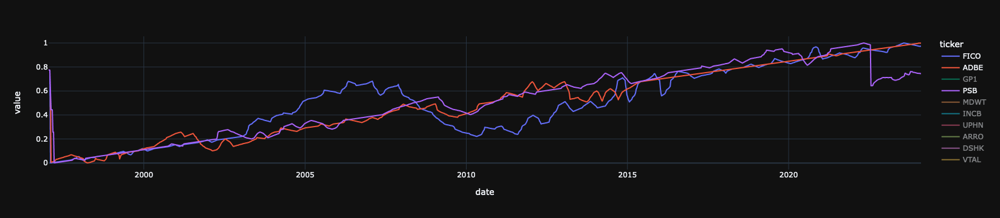

In [521]:
feats.iloc[:,model.causal_order_].iloc[:,:10].plot()

In [518]:
feats.iloc[:,model.causal_order_]

ticker,FICO,ADBE,GP1,PSB,MDWT,INCB,UPHN,ARRO,DSHK,VTAL,PHH,ALLO,DOGZ,PNNT,ITYCQ,BTCS,BTH,FOUR2,CLE,BRR,ADGE,ETSY,MICN,BOX1,FRGT,IBLTZ,SONG,CPLG,PFGC1,MDII1,FLGC,CMTI,BLBX,KNSL,IFRX,LAES,ULY,NN,EWCZ,DNUT,CHPT,APPHQ,FLNC,BLDE,JERT,NCFT,UBNK1,WCG,SLRX,FESX,OM,OPRT,SWCB1,MGN1,WFCF,WHHT,CD,SENS,MCKC,GLBL1,SKE1,BPZRQ,VRNT,PANW,CTRA,LOOP,GPN,PCOR,INBX,SVRA,FKKY,DSPT,CCS,AJSB,DECTF,ARTG,RURL,GGXY,VFC,BGFV,XENT,CBMG,GBTB,DWSN,CAPL,INFI,GIGA,BVH,CRRTQ,CCJ,CWONQ,ANLG,LXR,CFTP,DRAI,ROK,PRXL,CATX1,MTIN,SHSO,RIVL,NEO,ESIC,SGP,LWNTF,SLR,MEAD,NFX,PTN,NLG,CLV1,MYR1,BRLS1,GHC,NVS,FARO,DROV,YUM,SANG1,STRS,MLTC1,MBWM,KNTH,DAWKQ,HBI,VMI,SOSO,KESNQ,FFDB,HOSTQ,HBFW,TXCCQ,BDLSQ,CYBI,BOSA,WNG1,ROAD1,LOUD,LCGI,GMIL,SNTO,ALXN,CRXA,KENT,MSEL,PRKS,ARTT,DFCO1,DSGR1,WEN
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1997-01-17,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362
1997-01-24,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239
1997-01-31,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.

In [525]:
model.adjacency_matrices_.shape

(2, 150, 150)

In [530]:
len(labels)

150

In [ ]:
labels = feats.columns.to_list()


In [614]:
heat_df

,GPN,APPHQ,MTIN,VMI,BVH,ARTT,SWCB1,PNNT,ARRO,IBLTZ,CATX1,ANLG,OPRT,INBX,CFTP,GHC,BRLS1,CRRTQ,CTRA,GBTB,MICN,IFRX,PSB,FLGC,NLG,PCOR,FICO,ADBE,VTAL,GP1
GPN,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001550,0.000000,0.000000,0.000000,0.000000,0.000000,0.120226,0.000000,0.015210,0.000000,0.000000,0.000000,0.000000,0.000000,0.095980,0.116683,0.013627,0.264224
APPHQ,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.017102,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010580,0.000000,0.000000,0.440931
MTIN,0.000000,0.000000,0.000000,0.0,0.071014,0.0,0.168307,0.000000,0.042825,0.103880,-0.083488,-0.166727,0.000000,0.000000,-0.071365,0.000000,0.000000,0.157582,0.000000,-0.044412,0.093087,0.000000,0.067800,0.021683,0.000000,0.083860,0.000000,-0.009535,-0.058100,0.126147
VMI,0.018274,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010920,0.000000,0.000000,0.379153,0.000000,0.018134,0.128458,0.002604,0.006414,0.000000,0.007124,-0.007348,0.000000,0.000000,0.000000,0.043573,0.000000,0.099894
BVH,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.040418,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.227752,0.000000,0.000000,0.066324,0.000000,0.000000,0.020323,0.000000,0.079822,0.049261,0.112799
ARTT,0.023405,0.009361,0.054415,0.0,0.000000,0.0,0.000000,0.000000,0.009218,0.018891,0.000000,0.022898,0.002728,0.000000,-0.001088,0.062473,0.044169,0.000000,0.000000,0.013738,-0.000350,0.005900,0.000000,0.000000,0.083532,0.001910,0.010296,0.000000,0.000000,0.000000
SWCB1,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.009618,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.127583,0.000000,0.000000,0.016972,0.000000,0.000000,0.000000,0.000000,0.000000,0.216779
PNNT,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.100037,0.122522,-0.018016,0.408466
ARRO,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010016,0.133814,0.000000,0.503069
IBLTZ,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.068163,0.000000,0.000000,0.000000,0.000000,0.000000,0.030162,0.000000,0.000000,0.414880


In [619]:
heat_df

,GPN,APPHQ,MTIN,VMI,BVH,ARTT,SWCB1,PNNT,ARRO,IBLTZ,CATX1,ANLG,OPRT,INBX,CFTP,GHC,BRLS1,CRRTQ,CTRA,GBTB,MICN,IFRX,PSB,FLGC,NLG,PCOR,FICO,ADBE,VTAL,GP1
GPN,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001550,0.000000,0.000000,0.000000,0.000000,0.000000,0.120226,0.000000,0.015210,0.000000,0.000000,0.000000,0.000000,0.000000,0.095980,0.116683,0.013627,0.264224
APPHQ,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.017102,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010580,0.000000,0.000000,0.440931
MTIN,0.000000,0.000000,0.000000,0.0,0.071014,0.0,0.168307,0.000000,0.042825,0.103880,-0.083488,-0.166727,0.000000,0.000000,-0.071365,0.000000,0.000000,0.157582,0.000000,-0.044412,0.093087,0.000000,0.067800,0.021683,0.000000,0.083860,0.000000,-0.009535,-0.058100,0.126147
VMI,0.018274,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010920,0.000000,0.000000,0.379153,0.000000,0.018134,0.128458,0.002604,0.006414,0.000000,0.007124,-0.007348,0.000000,0.000000,0.000000,0.043573,0.000000,0.099894
BVH,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.040418,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.227752,0.000000,0.000000,0.066324,0.000000,0.000000,0.020323,0.000000,0.079822,0.049261,0.112799
ARTT,0.023405,0.009361,0.054415,0.0,0.000000,0.0,0.000000,0.000000,0.009218,0.018891,0.000000,0.022898,0.002728,0.000000,-0.001088,0.062473,0.044169,0.000000,0.000000,0.013738,-0.000350,0.005900,0.000000,0.000000,0.083532,0.001910,0.010296,0.000000,0.000000,0.000000
SWCB1,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.009618,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.127583,0.000000,0.000000,0.016972,0.000000,0.000000,0.000000,0.000000,0.000000,0.216779
PNNT,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.100037,0.122522,-0.018016,0.408466
ARRO,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.010016,0.133814,0.000000,0.503069
IBLTZ,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.068163,0.000000,0.000000,0.000000,0.000000,0.000000,0.030162,0.000000,0.000000,0.414880


In [623]:

heat_df = pd.DataFrame(model.adjacency_matrices_[0], columns=labels, index=labels)

# keep_these = heat_df.sum().abs().sort_values().tail(30).index

# heat_df = heat_df.loc[keep_these, keep_these]

scaler = StandardScaler()
heat_df_scaled = pd.DataFrame(scaler.fit_transform(heat_df), columns=heat_df.columns, index=heat_df.index)

In [631]:
heat_df.sum()

ADBE    4.121970
ADGE    0.102146
AJSB    0.206244
ALLO    0.114254
ALXN    0.109133
          ...   
WFCF    0.194593
WHHT    0.030215
WNG1    0.122988
XENT    0.198987
YUM     0.171641
Length: 150, dtype: float64

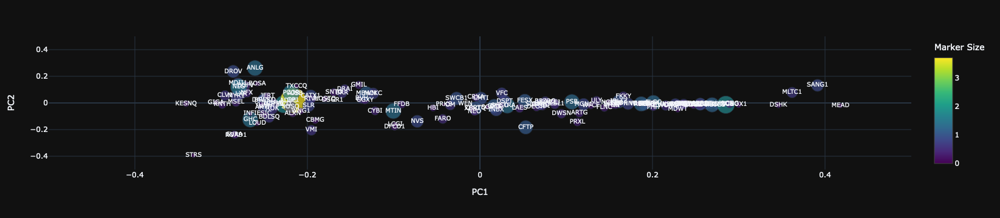

In [660]:
import plotly.express as px
import numpy as np
from sklearn.decomposition import PCA

# Assuming 'heat_df' is your DataFrame

# Perform PCA
pca = PCA(n_components=2)
principalComponents = pca.fit_transform(heat_df)
principalDf = pd.DataFrame(data=principalComponents, columns=['PC1', 'PC2'])

# Calculate the sum of each row in heat_df for the marker sizes
marker_sizes = np.log(1 + heat_df.abs().sum())

# Create a scatter plot with Plotly
# Use size_max to adjust the maximum marker size
fig = px.scatter(principalDf, x='PC1', y='PC2', text=heat_df.index, size=marker_sizes, size_max=30)  # Adjust size_max as needed

# Adjust text size
for trace in fig.data:
    trace.textfont.size = 10

# Add different colors to the markers
fig.update_traces(marker=dict(color=marker_sizes, colorbar=dict(title="Marker Size"),
                              colorscale='Viridis'),
                  selector=dict(mode='markers+text'))

# Set graph layout range between -0.5 and 0.5 for both axes
fig.update_xaxes(range=[-0.5, 0.5])
fig.update_yaxes(range=[-0.5, 0.5])

# Show the plot
fig.show()


In [536]:
!pip install graphviz

In [569]:
dot = make_dot(model.adjacency_matrices_[0], ignore_shape=True, lower_limit=0.50, labels=labels)

dot.format = 'svg'
dot.render('test')

'test.svg'

In [547]:
!pip install pyvis

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 756.0/756.0 kB 11.4 MB/s eta 0:00:0031m5.2 MB/s eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.8/40.8 kB 6.4 MB/s eta 0:00:00


In [550]:
!pip install pydot


In [551]:
import pydot
from graphviz import Digraph
import networkx as nx
from pyvis.network import Network

# Assuming 'dot' is your Graphviz Digraph object
dot_string = dot.source

# Parse the DOT string into a pydot graph
pydot_graph = pydot.graph_from_dot_data(dot_string)[0]


In [552]:
# Convert pydot graph to NetworkX graph
nx_graph = nx.nx_pydot.from_pydot(pydot_graph)


In [566]:
import networkx as nx
from pyvis.network import Network

# Assuming 'nx_graph' is your existing NetworkX graph
# You can load or create your NetworkX graph here

# Create a PyVis network
net = Network(notebook=True)

# Optional: Pre-compute layout with NetworkX (uncomment if needed)
# positions = nx.spring_layout(nx_graph)
# for n, p in positions.items():
#     net.get_node(n)['x'] = p[0] * 1000  # Scale factor for positioning
#     net.get_node(n)['y'] = p[1] * 1000

# Adjust physics settings for faster stabilization
net.options.physics.enabled = True
net.options.physics.solver = 'forceAtlas2Based'

# Fine-tune forceAtlas2Based settings for better layout quality
net.options.physics.forceAtlas2Based.theta = 0.5  # Adjust the Barnes-Hut approximation
net.options.physics.forceAtlas2Based.gravitationalConstant = -50  # Decrease for less repulsion
net.options.physics.forceAtlas2Based.centralGravity = 0.01  # Lower value for less influence of central gravity
net.options.physics.forceAtlas2Based.springLength = 100  # Increase for larger distance between nodes
net.options.physics.forceAtlas2Based.springConstant = 0.08  # Increase for stronger springs
net.options.physics.forceAtlas2Based.damping = 0.4  # Increase for faster stabilization

# Velocity and stabilization adjustments
net.options.physics.maxVelocity = 10  # Decrease for smoother movement
net.options.physics.minVelocity = 0.1  # Adjust as needed
net.options.physics.stabilization.iterations = 1000  # Higher number for more pre-calculations



# net.options.edges.smooth.enabled = False

# Optional: Disable physics after initial layout (uncomment if needed)
# net.options.physics.stabilization.onlyDynamicEdges = False
# net.options.physics.stabilization.fit = True
# net.options.physics.stabilization.updateInterval = 1

# Add nodes and edges from the NetworkX graph
net.from_nx(nx_graph)

# Show the interactive graph in the notebook
net.show('graph.html')


graph.html


In [542]:
p_values = model.get_error_independence_p_values()

Process SpawnPoolWorker-90:
Process SpawnPoolWorker-89:
Traceback (most recent call last):
Traceback (most recent call last):
  File "/opt/homebrew/Cellar/python@3.11/3.11.7_1/Frameworks/Python.framework/Versions/3.11/lib/python3.11/multiprocessing/process.py", line 314, in _bootstrap
    self.run()
  File "/opt/homebrew/Cellar/python@3.11/3.11.7_1/Frameworks/Python.framework/Versions/3.11/lib/python3.11/multiprocessing/process.py", line 108, in run
    self._target(*self._args, **self._kwargs)
  File "/opt/homebrew/Cellar/python@3.11/3.11.7_1/Frameworks/Python.framework/Versions/3.11/lib/python3.11/multiprocessing/pool.py", line 114, in worker
    task = get()
           ^^^^^
  File "/opt/homebrew/Cellar/python@3.11/3.11.7_1/Frameworks/Python.framework/Versions/3.11/lib/python3.11/multiprocessing/queues.py", line 364, in get
    with self._rlock:
  File "/opt/homebrew/Cellar/python@3.11/3.11.7_1/Frameworks/Python.framework/Versions/3.11/lib/python3.11/multiprocessing/synchronize.py",

KeyboardInterrupt: 

In [ ]:
p_values

In [510]:
feats.iloc[:,model.causal_order_]

ticker,ADBE,ALXN,ARTT,BRLS1,ANLG,ADGE,BOSA,ARTG,ARRO,BRR,BDLSQ,BLBX,BLDE,APPHQ,ALLO,BTCS,AJSB,BPZRQ,BGFV,BOX1
date,,,,,,,,,,,,,,,,,,,,
1997-01-17,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362,0.776362
1997-01-24,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239,0.774239
1997-01-31,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531,0.773531
1997-02-07,0.591178,0.591178,0.591178,0.591178,0.591178,0.591178,0.591178,0.591178,0.591178,0.591178,0.591178,0.591178,0.591178,0.591178,0.591178,0.591178,0.591178,0.591178,0.591178,0.591178
1997-02-14,0.005678,0.444272,0.444272,0.444272,0.444272,0.444272,0.444272,0.444272,0.444272,0.444272,0.444272,0.444272,0.444272,0.444272,0.444272,0.444272,0.444272,0.444272,0.444272,0.444272
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-01-12,0.998581,0.746962,0.746962,0.746962,0.746962,0.746962,0.746962,0.746962,0.746962,0.746962,0.746962,0.567073,0.970213,0.746962,0.478648,0.787234,0.746962,0.746962,0.576549,0.746962
2024-01-19,0.998581,0.746938,0.746938,0.746938,0.746938,0.746938,0.746938,0.746938,0.746938,0.746938,0.746938,0.567073,0.970213,0.746938,0.478648,0.787234,0.746938,0.746938,0.576549,0.746938
2024-01-26,0.998581,0.746121,0.746121,0.746121,0.746121,0.746121,0.746121,0.746121,0.746121,0.746121,0.746121,0.567073,0.970213,0.746121,0.478648,0.787234,0.746121,0.746121,0.576549,0.746121


In [493]:
feats.iloc[:,model.causal_order_]

ticker,BOX1,ARRO,BLDE,BTCS,AJSB,BPZRQ,ALXN,APPHQ,BLBX,ALLO,ADGE,ANLG,ADBE,BGFV,BOSA,ARTG,BDLSQ,ARTT,BRLS1,BRR
date,,,,,,,,,,,,,,,,,,,,
1997-01-17,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5,0.500000,0.500000,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5,0.5,0.5
1997-01-24,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5,0.500000,0.500000,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5,0.5,0.5
1997-01-31,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5,0.500000,0.500000,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5,0.5,0.5
1997-02-07,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5,0.500000,0.500000,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5,0.5,0.5
1997-02-14,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5,0.500000,0.500000,0.5,0.5,0.005678,0.500000,0.5,0.5,0.5,0.5,0.5,0.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-01-12,0.5,0.5,0.970213,0.787234,0.5,0.5,0.5,0.5,0.567073,0.478648,0.5,0.5,0.998581,0.576549,0.5,0.5,0.5,0.5,0.5,0.5
2024-01-19,0.5,0.5,0.970213,0.787234,0.5,0.5,0.5,0.5,0.567073,0.478648,0.5,0.5,0.998581,0.576549,0.5,0.5,0.5,0.5,0.5,0.5
2024-01-26,0.5,0.5,0.970213,0.787234,0.5,0.5,0.5,0.5,0.567073,0.478648,0.5,0.5,0.998581,0.576549,0.5,0.5,0.5,0.5,0.5,0.5


[15, 7, 13, 19, 2, 16, 4, 6, 12, 3, 1, 5, 0, 11, 14, 8, 10, 9, 17, 18]

In [488]:
from lingam.utils import make_dot, print_causal_directions, print_dagc

make_dot(np.hstack(model.adjacency_matrices_))

ValueError: 'adjacency_matrix' is not square matrix.

In [492]:
model.adjacency_matrices_[0]

array([[ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  

In [461]:
df_pivoted

ticker,ADBE,ADGE,AJSB,ALLO,ALXN,ANLG,APPHQ,ARRO,ARTG,ARTT,BDLSQ,BGFV,BLBX,BLDE,BOSA,BOX1,BPZRQ,BRLS1,BRR,BTCS,BTH,BVH,CAPL,CATX1,CBMG,CCJ,CCS,CD,CFTP,CHPT,CLE,CLV1,CMTI,CPLG,CRRTQ,CRXA,CTRA,CWONQ,CYBI,DAWKQ,DECTF,DFCO1,DNUT,DOGZ,DRAI,DROV,DSGR1,DSHK,DSPT,DWSN,ESIC,ETSY,EWCZ,FARO,FESX,FFDB,FICO,FKKY,FLGC,FLNC,FOUR2,FRGT,GBTB,GGXY,GHC,GIGA,GLBL1,GMIL,GP1,GPN,HBFW,HBI,HOSTQ,IBLTZ,IFRX,INBX,INCB,INFI,ITYCQ,JERT,KENT,KESNQ,KNSL,KNTH,LAES,LCGI,LOOP,LOUD,LWNTF,LXR,MBWM,MCKC,MDII1,MDWT,MEAD,MGN1,MICN,MLTC1,MSEL,MTIN,MYR1,NCFT,NEO,NFX,NLG,NN,NVS,OM,OPRT,PANW,PCOR,PFGC1,PHH,PNNT,PRKS,PRXL,PSB,PTN,RIVL,ROAD1,ROK,RURL,SANG1,SENS,SGP,SHSO,SKE1,SLR,SLRX,SNTO,SONG,SOSO,STRS,SVRA,SWCB1,TXCCQ,UBNK1,ULY,UPHN,VFC,VMI,VRNT,VTAL,WCG,WEN,WFCF,WHHT,WNG1,XENT,YUM
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1997-01-17,0.500000,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.500000,0.500000,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.500000,0.500000,0.5,0.5,0.500000,0.500000,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.500000,0.500000,0.500000,0.5,0.5,0.500000,0.5,0.500000,0.500,0.5,0.500000,0.5,0.5,0.500000,0.776362,0.5,0.5,0.5,0.500000,0.5,0.500000,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.500000,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.5,0.5,0.500000,0.50000,0.5,0.5,0.500000,0.5,0.5,0.500000,0.5,0.5,0.50000,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5000,0.5,0.500000,0.500000,0.500000,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.500000
1997-01-24,0.500000,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.500000,0.500000,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.500000,0.500000,0.5,0.5,0.500000,0.500000,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.500000,0.500000,0.500000,0.5,0.5,0.500000,0.5,0.500000,0.500,0.5,0.500000,0.5,0.5,0.500000,0.774239,0.5,0.5,0.5,0.500000,0.5,0.500000,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.500000,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.5,0.5,0.500000,0.50000,0.5,0.5,0.500000,0.5,0.5,0.500000,0.5,0.5,0.50000,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5000,0.5,0.500000,0.500000,0.500000,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.500000
1997-01-31,0.500000,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.500000,0.500000,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.500000,0.500000,0.5,0.5,0.500000,0.500000,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.500000,0.500000,0.500000,0.5,0.5,0.500000,0.5,0.500000,0.500,0.5,0.500000,0.5,0.5,0.500000,0.773531,0.5,0.5,0.5,0.500000,0.5,0.500000,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.500000,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.5,0.5,0.500000,0.50000,0.5,0.5,0.500000,0.5,0.5,0.500000,0.5,0.5,0.50000,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5000,0.5,0.500000,0.500000,0.500000,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.500000
1997-02-07,0.500000,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.500000,0.500000,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.500000,0.500000,0.5,0.5,0.500000,0.500000,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.500000,0.500000,0.500000,0.5,0.5,0.000709,0.5,0.500000,0.500,0.5,0.500000,0.5,0.5,0.500000,0.772824,0.5,0.5,0.5,0.500000,0.5,0.500000,0.5,0.5,0.500000,0.500000,0.5,0.5,0.5,0.5,0.5,0.5,0.500000,0.5,0.5,

In [227]:
# !pip install kshape

In [228]:
## let's see what clustering looks like.

In [421]:
df_filtered = df_filtered.select_features()

In [422]:
# df_accounting = df_filtered

In [ ]:
import pandas as pd

# Assuming df_accounting is your DataFrame with MultiIndex (ticker, date)

def remove_ticks(df_accounting):
    # Step 1: Group by 'ticker' and calculate the mean of 'total_revenue'
    ticker_revenue_mean = df_accounting.groupby('ticker')['total_revenue'].mean()
    
    # Step 2: Find tickers where the mean revenue is zero
    tickers_to_remove = ticker_revenue_mean[ticker_revenue_mean == 0].index
    
    # Step 3: Filter out these tickers from the original DataFrame
    df_filtered = df_accounting[~df_accounting.index.get_level_values('ticker').isin(tickers_to_remove)]
    return df_filtered


In [423]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler

# Assuming df_accounting is already defined
# Pivot the DataFrame
df_pivoted = df_filtered.reset_index().pivot(index='date', columns='ticker')

# Handling missing data
df_pivoted.fillna(method='ffill', inplace=True)
df_pivoted.fillna(method='bfill', inplace=True)

# Selecting the last 220 dates
df_selected = df_pivoted.tail(52*3)

# Standardize the features
scaler = StandardScaler()
df_standardized = pd.DataFrame(scaler.fit_transform(df_selected), 
                               index=df_selected.index, 
                               columns=df_selected.columns)

# Reshaping the DataFrame to a 3D NumPy array
num_dates = len(df_standardized)
num_features = len(df_standardized.columns.levels[0])
num_tickers = len(df_standardized.columns.levels[1])

np_array = df_standardized.to_numpy().reshape(num_tickers, num_dates, num_features)


In [429]:
from sovai.extensions.core_kshape import KShapeClusteringCPU

# CPU Model
num_clusters = 9
ksc = KShapeClusteringCPU(num_clusters, centroid_init='zero', max_iter=1000, n_jobs=1)
ksc.fit(np_array)

labels = ksc.labels_
cluster_centroids = ksc.centroids_
    

In [430]:
dicta = {"tickers":df_standardized.columns.levels[1], "labels":labels}

In [431]:
pd.DataFrame(dicta).sort_values("labels")

,tickers,labels
48,DSPT,0.0
52,EWCZ,0.0
51,ETSY,0.0
50,ESIC,0.0
49,DWSN,0.0
...,...,...
105,NN,8.0
106,NVS,8.0
107,OM,8.0
96,MICN,8.0


In [432]:
idx, centroids, distances, result = ksc.predict(np_array)

In [441]:
df_standardized.columns.levels[1]

Index(['ADBE', 'ADGE', 'AJSB', 'ALLO', 'ALXN', 'ANLG', 'APPHQ', 'ARRO', 'ARTG',
       'ARTT',
       ...
       'VMI', 'VRNT', 'VTAL', 'WCG', 'WEN', 'WFCF', 'WHHT', 'WNG1', 'XENT',
       'YUM'],
      dtype='object', name='ticker', length=150)

In [448]:
corr_matrix.sort_values("LXR")

ticker,ADBE,ADGE,AJSB,ALLO,ALXN,ANLG,APPHQ,ARRO,ARTG,ARTT,BDLSQ,BGFV,BLBX,BLDE,BOSA,BOX1,BPZRQ,BRLS1,BRR,BTCS,BTH,BVH,CAPL,CATX1,CBMG,CCJ,CCS,CD,CFTP,CHPT,CLE,CLV1,CMTI,CPLG,CRRTQ,CRXA,CTRA,CWONQ,CYBI,DAWKQ,DECTF,DFCO1,DNUT,DOGZ,DRAI,DROV,DSGR1,DSHK,DSPT,DWSN,ESIC,ETSY,EWCZ,FARO,FESX,FFDB,FICO,FKKY,FLGC,FLNC,FOUR2,FRGT,GBTB,GGXY,GHC,GIGA,GLBL1,GMIL,GP1,GPN,HBFW,HBI,HOSTQ,IBLTZ,IFRX,INBX,INCB,INFI,ITYCQ,JERT,KENT,KESNQ,KNSL,KNTH,LAES,LCGI,LOOP,LOUD,LWNTF,LXR,MBWM,MCKC,MDII1,MDWT,MEAD,MGN1,MICN,MLTC1,MSEL,MTIN,MYR1,NCFT,NEO,NFX,NLG,NN,NVS,OM,OPRT,PANW,PCOR,PFGC1,PHH,PNNT,PRKS,PRXL,PSB,PTN,RIVL,ROAD1,ROK,RURL,SANG1,SENS,SGP,SHSO,SKE1,SLR,SLRX,SNTO,SONG,SOSO,STRS,SVRA,SWCB1,TXCCQ,UBNK1,ULY,UPHN,VFC,VMI,VRNT,VTAL,WCG,WEN,WFCF,WHHT,WNG1,XENT,YUM
ticker,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
FLGC,-0.233333,-0.383333,-0.283333,-0.283333,-0.333333,-0.266667,-0.250000,-0.400000,-0.500000,-0.433333,-0.666667,-0.500000,-0.583333,-0.533333,-0.533333,-0.516667,-0.266667,-0.433333,-0.250000,0.066667,-0.216667,-0.116667,-0.033333,-0.066667,-0.433333,-0.433333,-0.500000,-0.466667,-0.433333,-0.383333,-0.483333,-0.366667,-0.483333,-0.200000,-0.266667,-0.266667,-0.266667,-0.283333,-0.316667,-0.350000,-0.266667,-0.350000,-0.333333,-0.416667,0.050000,0.100000,0.083333,0.166667,0.166667,0.533333,0.750000,0.783333,0.816667,0.783333,0.500000,0.683333,0.900000,1.000000,1.000000,0.850000,0.466667,0.300000,0.200000,0.216667,0.033333,0.033333,0.033333,0.166667,0.183333,0.116667,0.116667,0.183333,0.366667,0.450000,0.183333,0.216667,0.066667,-0.216667,-0.183333,-0.200000,-0.233333,-0.300000,-0.200000,-0.266667,-0.316667,-0.566667,-0.800000,-0.716667,-0.650000,-0.650000,-0.700000,-0.683333,-0.733333,-0.666667,-0.566667,-0.433333,-0.400000,-0.333333,-0.083333,-0.133333,-0.133333,-0.133333,0.000000,-0.033333,0.083333,0.133333,0.183333,0.083333,0.150000,0.200000,0.266667,0.050000,0.050000,-0.100000,-0.300000,-0.266667,-0.400000,-0.400000,-0.633333,-0.600000,-0.616667,-0.550000,-0.516667,-0.466667,-0.516667,-0.233333,-0.100000,0.150000,0.266667,0.433333,0.433333,0.433333,0.483333,0.316667,0.150000,0.366667,0.333333,0.216667,0.166667,0.150000,0.183333,0.166667,0.050000,0.166667,0.200000,0.266667,0.233333,0.266667,0.150000,0.150000
FKKY,-0.233333,-0.383333,-0.283333,-0.283333,-0.333333,-0.266667,-0.250000,-0.400000,-0.500000,-0.433333,-0.666667,-0.500000,-0.583333,-0.533333,-0.533333,-0.516667,-0.266667,-0.433333,-0.250000,0.066667,-0.216667,-0.116667,-0.033333,-0.066667,-0.433333,-0.433333,-0.500000,-0.466667,-0.433333,-0.383333,-0.483333,-0.366667,-0.483333,-0.200000,-0.266667,-0.266667,-0.266667,-0.283333,-0.316667,-0.350000,-0.266667,-0.350000,-0.333333,-0.416667,0.050000,0.100000,0.083333,0.166667,0.166667,0.533333,0.750000,0.783333,0.816667,0.783333,0.500000,0.683333,0.900000,1.000000,1.000000,0.850000,0.466667,0.300000,0.200000,0.216667,0.033333,0.033333,0.033333,0.166667,0.183333,0.116667,0.116667,0.183333,0.366667,0.450000,0.183333,0.216667,0.066667,-0.216667,-0.183333,-0.200000,-0.233333,-0.300000,-0.200000,-0.266667,-0.316667,-0.566667,-0.800000,-0.716667,-0.650000,-0.650000,-0.700000,-0.683333,-0.733333,-0.666667,-0.566667,-0.433333,-0.400000,-0.333333,-0.083333,-0.133333,-0.133333,-0.133333,0.000000,-0.033333,0.083333,0.133333,0.183333,0.083333,0.150000,0.200000,0.266667,0.050000,0.050000,-0.100000,-0.300000,-0.266667,-0.400000,-0.400000,-0.633333,-0.600000,-0.616667,-0.550000,-0.516667,-0.466667,-0.516667,-0.233333,-0.100000,0.150000,0.266667,0.433333,0.433333,0.433333,0.483333,0.316667,0.150000,0.366667,0.333333,0.216667,0.166667,0.150000,0.183333,0.166667,0.050000,0.166667,0.200000,0.266667,0.233333,0.266667,0.150000,0.150000
FLNC,-0.133333,-0.283333,-0.166667,-0.316667,-0.350000,-0.416667,-0.350000,-0.566667,-0.583333,-0.500000,-0.600000,-0.383333,-0.550000,-0.400000,-0.333333,-0.366667,-0.100000,-0.216667,-0.133333,-0.016667,-0.283333,-0

/Users/dereksnow/Sovai/GitHub/SovAI/.venv/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning:

Clustering large matrix with scipy. Installing `fastcluster` may give better performance.



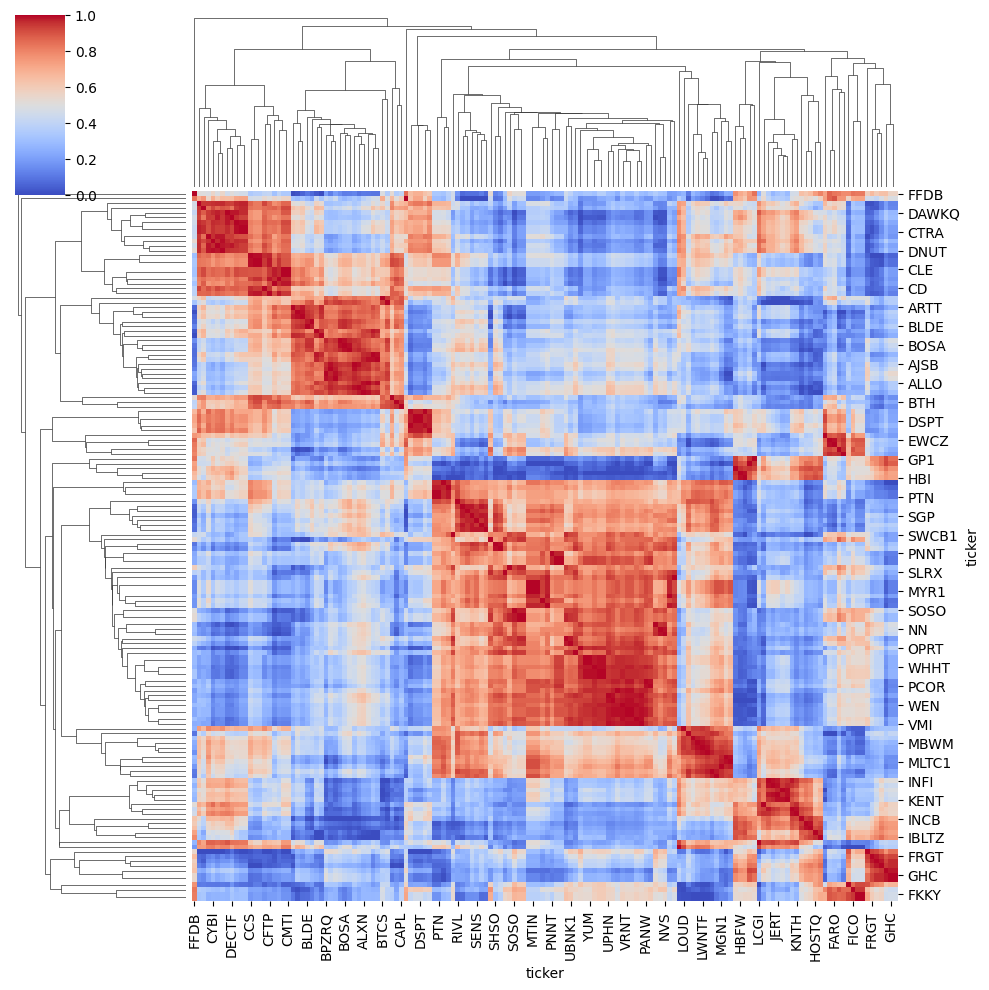

In [442]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage

# Your existing code for df_distances
df_distances = pd.DataFrame(distances, index=df_standardized.columns.levels[1], columns=[f'Centroid {i}' for i in range(distances.shape[1])])
df_distances = df_distances.replace(1, 0.99)

# Calculate the correlation matrix using a robust method
corr_matrix = df_distances.T.corr(method='spearman')

# Replace NaNs, infinities, and negative infinities with 0
corr_matrix = corr_matrix.replace([np.inf, -np.inf], 0).fillna(0)

# Perform hierarchical clustering
linked = linkage(corr_matrix, 'single')

# Create a seaborn clustermap
sns.clustermap(corr_matrix, method='single', cmap='coolwarm', standard_scale=1, figsize=(10, 10))

plt.show()


In [435]:
distances.shape

(150, 9)

In [340]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler

# Assuming df_accounting is already defined and has a 'total_revenue' column
# Filter for 'total_revenue' feature

df_filtered = remove_ticks(df_accounting)
df_total_revenue = df_filtered.reset_index()[['date', 'ticker', 'total_revenue']]

# Pivot the DataFrame
df_pivoted = df_total_revenue.reset_index().pivot(index='date', columns='ticker', values='total_revenue')

# Handling missing data
df_pivoted.fillna(method='ffill', inplace=True)
df_pivoted.fillna(method='bfill', inplace=True)

# Selecting the last 52 dates
df_selected = df_pivoted.tail(52*5)

# Standardize the 'total_revenue' feature
scaler = StandardScaler()
df_standardized = pd.DataFrame(scaler.fit_transform(df_selected), 
                               index=df_selected.index, 
                               columns=df_selected.columns)




In [341]:
zero_sum_columns = df_standardized.columns[df_standardized.sum() == 0]

df_standardized = df_standardized.drop(columns=zero_sum_columns)

# Convert to 2D NumPy array (tickers x dates)
np_array = df_standardized.to_numpy().transpose()  # Transpose to get tickers as rows and dates as columns

np_array = np.expand_dims(np_array, axis=-1)  # Add an extra dimension at the end


In [342]:
np_array.shape

(66, 260, 1)

In [343]:
# CPU Model
from sovai.extensions.core_kshape import KShapeClusteringCPU

num_clusters = 6
ksc = KShapeClusteringCPU(num_clusters, centroid_init='zero', max_iter=100, n_jobs=1)
ksc.fit(np_array)

## Interesting, you might be able to fit it with all your data then predict.

idx, centroids, distances, result = ksc.predict(np_array)
# cluster_centroids = ksc.centroids_

In [373]:
# Generate centroid names
centroids_names = [f"Centroid {i}" for i in range(num_clusters)]

# times = list(range(num_times))

num_records = len(df_selected)

# Generate evenly spaced indices
indices = np.linspace(0, len(result[0]) - 1, num=num_records, dtype=int)

data = [(ticker, centroida, time) for ticker in df_standardized.columns for centroida in centroids_names for time in df_selected.index]

# Create DataFrame
output_df = pd.DataFrame(data, columns=["ticker", "centroid", "date"])

In [374]:
import itertools
long_list = list(itertools.chain.from_iterable(res[indices] for res in result))

long_list = list(itertools.chain.from_iterable(res[:num_records] for res in result))


In [375]:
output_df["distance"] = long_list

In [376]:
output_df = output_df.set_index(["ticker","date"])

In [377]:
output_df.head()

centroid  distance
ticker date                            
ADBE   2019-02-22  Centroid 0 -0.010124
       2019-03-01  Centroid 0 -0.020199
       2019-03-08  Centroid 0 -0.030225
       2019-03-15  Centroid 0 -0.040260
       2019-03-22  Centroid 0 -0.050308

In [378]:
wide_df = output_df.reset_index().pivot_table(index=['ticker', 'date'], columns='centroid', values='distance')

In [379]:
wide_df.columns = [col for col in wide_df.columns]

In [380]:
wide_df

Centroid 0  Centroid 1  Centroid 2  Centroid 3  Centroid 4  \
ticker date                                                                     
ADBE   2019-02-22   -0.010124   -0.004268   -0.002805   -0.004605   -0.005801   
       2019-03-01   -0.020199   -0.008749   -0.008289   -0.009162   -0.012850   
       2019-03-08   -0.030225   -0.015492   -0.019555   -0.012281   -0.019856   
       2019-03-15   -0.040260   -0.023736   -0.033401   -0.015267   -0.026817   
       2019-03-22   -0.050308   -0.032290   -0.049795   -0.018119   -0.033733   
...                       ...         ...         ...         ...         ...   
YUM    2024-01-12    0.731145    0.469585    0.173491    0.710573    0.674689   
       2024-01-19    0.734342    0.460823    0.174463    0.730450    0.686776   
       2024-01-26    0.737271    0.452479    0.175194    0.749832    0.698328   
       2024-02-02    0.739878    0.445052    0.175666    0.768381    0.709061   
       2024-02-09    0.742125    0.438635    0.175878    0.785372    0.718595   

                   Centroid 5  
ticker date                    
ADBE   2019-02-22   -0.001475  
       2019-03-01   -0.002841  
       2019-03-08   -0.004110  
       2019-03-15   -0.005209  
       2019-03-22   -0.006141  
...                       ...  
YUM    2024-01-12    0.038907  
       2024-01-19    0.001994  
       2024-01-26   -0.034669  
       2024-02-02   -0.070773  
       2024-02-09   -0.105709  

[17160 rows x 6 columns]

In [381]:
unique_dates = wide_df.index.get_level_values('date').unique()

cent_df = pd.DataFrame(centroids.T.squeeze(), columns=centroids_names)

# Set these unique dates as the index of centroid_df
cent_df.index = unique_dates


In [382]:
cent_df.head()

,Centroid 0,Centroid 1,Centroid 2,Centroid 3,Centroid 4,Centroid 5
date,,,,,,
2019-02-22,-1.304065,-0.412268,-0.203403,-1.045518,-0.257443,0.289618
2019-03-01,-1.291287,-0.408806,-0.203403,-1.554271,-0.438892,0.298132
2019-03-08,-1.279254,-0.405344,-0.203403,-1.675042,-0.477137,0.306646
2019-03-15,-1.267221,-0.401881,-0.203403,-1.795813,-0.515381,0.315160
2019-03-22,-1.255188,-0.398419,-0.203403,-1.916584,-0.800452,0.323674


In [383]:
# import pandas as pd


# df_aal = wide_df.xs('AAL', level='ticker')
# df_dal = wide_df.xs('DAL', level='ticker')

# # Initialize a DataFrame to store the rolling correlations
# rolling_correlations = pd.DataFrame(index=df_aal.index)

# # Calculate rolling correlation for each centroid
# for centroid in df_aal.columns:
#     # Calculate the rolling 52-week correlation
#     rolling_correlation = df_aal[centroid].rolling(window=105).corr(df_dal[centroid])
    
#     # Store the rolling correlation
#     rolling_correlations[centroid] = rolling_correlation

# # rolling_correlations now contains the rolling correlations between AAL and DAL for each centroid


In [384]:
# rolling_correlations.plot()

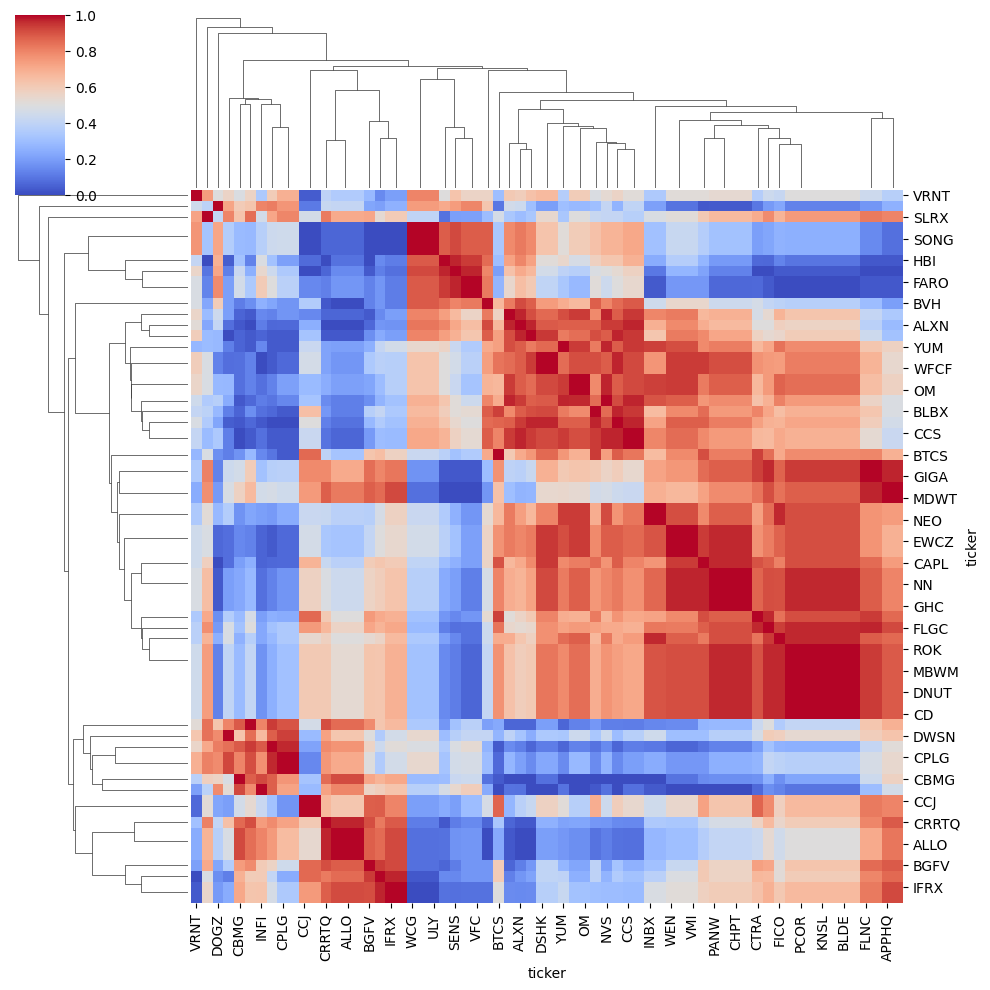

In [418]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage

# Your existing code for df_distances
df_distances = pd.DataFrame(distances, index=df_standardized.columns, columns=[f'Centroid {i}' for i in range(distances.shape[1])])
df_distances = df_distances.replace(1, 0.99)

# Calculate the correlation matrix using a robust method
corr_matrix = df_distances.T.corr(method='spearman')

# Replace NaNs, infinities, and negative infinities with 0
corr_matrix = corr_matrix.replace([np.inf, -np.inf], 0).fillna(0)

# Perform hierarchical clustering
linked = linkage(corr_matrix, 'single')

# Create a seaborn clustermap
sns.clustermap(corr_matrix, method='single', cmap='coolwarm', standard_scale=1, figsize=(10, 10))

plt.show()


In [386]:
## The distances one, does end up giving the best score, it kind of makese sense, get's rid of the noise in the time series.
df_distances.T.corr()

ticker,ADBE,ALLO,ALXN,APPHQ,BGFV,BLBX,BLDE,BTCS,BVH,CAPL,CBMG,CCJ,CCS,CD,CHPT,CPLG,CRRTQ,CTRA,DNUT,DOGZ,DSHK,DWSN,ETSY,EWCZ,FARO,FICO,FLGC,FLNC,GHC,GIGA,GPN,HBI,IFRX,INBX,INFI,KNSL,LAES,LOOP,MBWM,MDWT,NEO,NN,NVS,OM,OPRT,PANW,PCOR,PNNT,PRKS,PSB,PTN,ROK,SENS,SLRX,SONG,STRS,SVRA,ULY,VFC,VMI,VRNT,WCG,WEN,WFCF,XENT,YUM
ticker,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
ADBE,1.000000,-0.642392,0.718810,0.530044,-0.045603,0.836238,0.852341,0.772908,0.442758,0.856680,-0.756424,0.129101,0.911975,0.899444,0.924299,-0.479819,-0.388025,0.606265,0.889748,-0.646074,0.915231,-0.131177,0.889821,0.931278,-0.366572,0.898420,0.647390,0.420409,0.908849,0.492965,0.764688,-0.081780,-0.311818,0.854158,-0.832804,0.892442,-0.067645,-0.081691,0.917425,0.463005,0.969895,0.692494,0.908620,0.988655,-0.517908,0.936566,0.837829,0.296214,0.701283,0.871997,-0.638129,0.821051,-0.235686,0.044707,0.238671,-0.608160,-0.612591,0.055167,-0.398168,0.927708,0.143146,0.140499,0.957915,0.819442,-0.561021,0.914256
ALLO,-0.642392,1.000000,-0.946110,0.221635,0.499336,-0.618721,-0.198028,-0.233304,-0.910369,-0.290126,0.957597,0.351036,-0.760100,-0.313801,-0.358784,0.017204,0.680491,0.016670,-0.286247,-0.010160,-0.705157,-0.217722,-0.817792,-0.413526,-0.458055,-0.321330,0.067846,0.280004,-0.362056,0.109353,-0.939793,-0.570841,0.919712,-0.377469,0.840950,-0.269392,0.768013,0.783822,-0.314093,0.317143,-0.461658,0.068403,-0.850811,-0.639114,0.429732,-0.372182,-0.204711,0.286239,-0.780683,-0.703276,0.989326,-0.151330,-0.539725,-0.054115,-0.887646,0.026688,0.994111,-0.776870,-0.414781,-0.398324,-0.573956,-0.841843,-0.455596,-0.583648,-0.123145,-0.624003
ALXN,0.718810,-0.946110,1.000000,-0.158691,-0.514531,0.761962,0.304539,0.419776,0.929123,0.463142,-0.946807,-0.129850,0.882492,0.394978,0.476302,-0.286380,-0.819773,0.145066,0.387150,-0.150443,0.793542,-0.017480,0.931747,0.532083,0.298810,0.373456,0.010446,-0.214644,0.448271,-0.077820,0.945734,0.596315,-0.804396,0.430854,-0.833222,0.353027,-0.667455,-0.586409,0.414469,-0.154749,0.538674,0.130197,0.915992,0.753168,-0.663336,0.461789,0.287724,-0.081052,0.896178,0.820807,-0.964377,0.282721,0.448778,-0.205768,0.815153,-0.315834,-0.963022,0.657865,0.320841,0.535144,0.302900,0.744388,0.553779,0.691945,-0.153758,0.799796
APPHQ,0.530044,0.221635,-0.158691,1.000000,0.708368,0.382553,0.855417,0.704860,-0.402910,0.699213,-0.001579,0.548398,0.289595,0.825662,0.764253,-0.271363,0.492852,0.832883,0.821000,-0.649761,0.378800,0.007604,0.123831,0.683335,-0.892591,0.819624,0.979355,0.962679,0.777333,0.913496,-0.104649,-0.846403,0.553909,0.660106,-0.241795,0.851813,0.770819,0.593186,0.816337,0.937596,0.712493,0.791450,0.245676,0.473564,0.135422,0.771305,0.883103,0.723940,-0.084100,0.289315,0.221114,0.865938,-0.917989,0.379104,-0.640164,-0.492171,0.288525,-0.761675,-0.968052,0.705350,-0.176519,-0.702440,0.683882,0.224919,-0.653751,0.315588
BGFV,-0.045603,0.499336,-0.514531,0.708368,1.000000,0.095936,0.432677,0.409135,-0.502871,0.308457,0.274421,0.668476,-0.142255,0.382234,0.300187,0.004539,0.775416,0.658853,0.388939,-0.345124,0.026849,0.210781,-0.409144,0.240499,-0.673477,0.249992,0.679662,0.852042,0.362912,0.845927,-0.600937,-0.873353,0.674386,-0.028611,0.003765,0.363961,0.826507,0.562796,0.309290,0.695896,0.126411,0.362106,-0.212336,-0.088817,0.645416,0.280149,0.488541,0.701289,-0.330194,-0.035487,0.450773,0.468574,-0.827546,0.565998,-0.692647,-0.093591,0.563576,-0.776963,-0.713821,0.252061,0.018572,-0.692805,0.200583,-0.150435,-0.293817,-0.272798
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
WCG,0.140499,-0.841843,0.744388,-0.702440,-0.692805,0.218989,-0.347102,-0.239449,0.875798,-0.208430,-0.694097,-0.555023,0.360314,-0.240308,-0.184848,0.217729,-0.696534,-0.470850,-0.262208,0.415561,0.280406,0.248140,0.47

In [393]:
df_distances

,Centroid 0,Centroid 1,Centroid 2,Centroid 3,Centroid 4,Centroid 5
ticker,,,,,,
ADBE,0.030698,0.312074,0.611002,0.141510,0.205032,0.564177
ALLO,0.652989,0.461178,0.057612,0.819565,0.691170,0.681357
ALXN,0.292800,0.434140,0.699032,0.026778,0.171386,0.345927
APPHQ,0.137159,0.127795,0.352386,0.412970,0.390147,0.642019
BGFV,0.494273,0.283628,0.465096,0.649595,0.477070,0.599787
...,...,...,...,...,...,...
WCG,0.624883,0.691000,0.830483,0.379255,0.456020,0.280548
WEN,0.028513,0.251547,0.572546,0.229566,0.141758,0.655808
WFCF,0.318924,0.514392,0.558575,0.385158,0.237225,0.547651


In [395]:
labels = ksc.labels_
cluster_centroids = ksc.centroids_

In [396]:
dicta = {"tickers":df_standardized.columns, "labels":labels}

In [397]:
df_dicta = pd.DataFrame(dicta)

In [398]:
df_dicta

,tickers,labels
0,ADBE,0.0
1,ALLO,2.0
2,ALXN,3.0
3,APPHQ,1.0
4,BGFV,1.0
...,...,...
61,WCG,5.0
62,WEN,0.0
63,WFCF,4.0
64,XENT,5.0


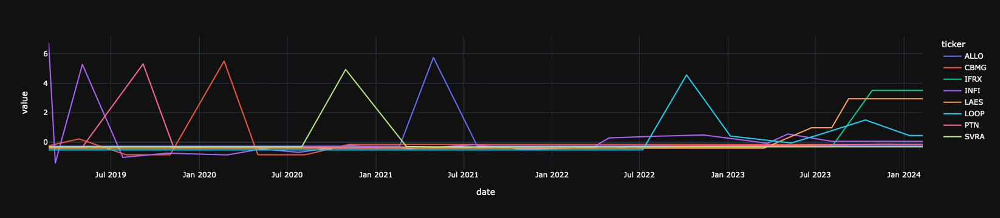

In [390]:
df_standardized[df_dicta[df_dicta["labels"]==2]["tickers"]].head(52*5).plot()

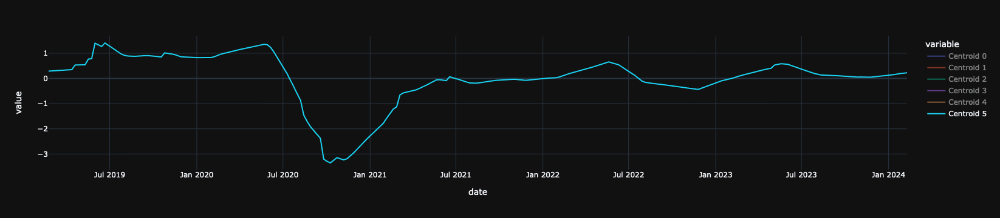

In [391]:
## STUFF like covid revenue response could be interesting.
cent_df.plot()

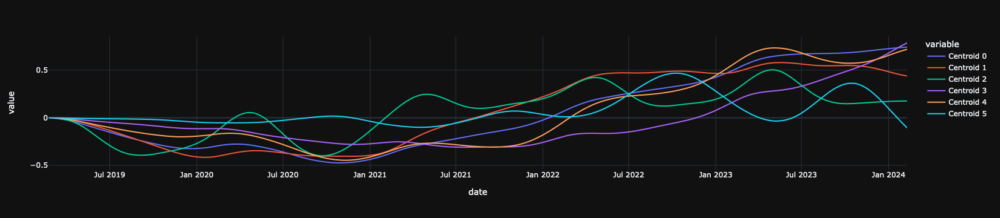

In [394]:
wide_df.query("ticker == 'YUM'").reset_index().set_index("date").drop(columns=["ticker"]).plot()
                                                                                

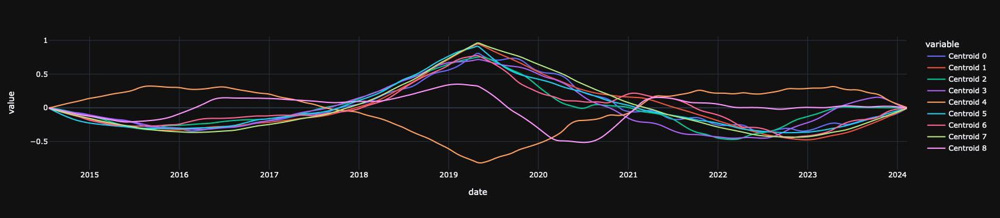

In [123]:
wide_df.query("ticker == 'TSLA'").reset_index().set_index("date").drop(columns=["ticker"]).plot()
                                                                                

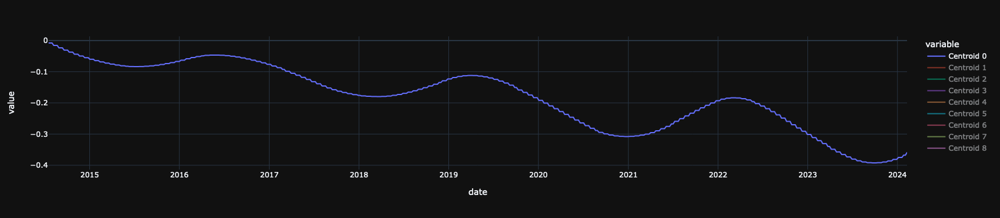

In [88]:
wide_df.query("ticker == 'AAPL'").reset_index().set_index("date").drop(columns=["ticker"]).plot()
                                                                                

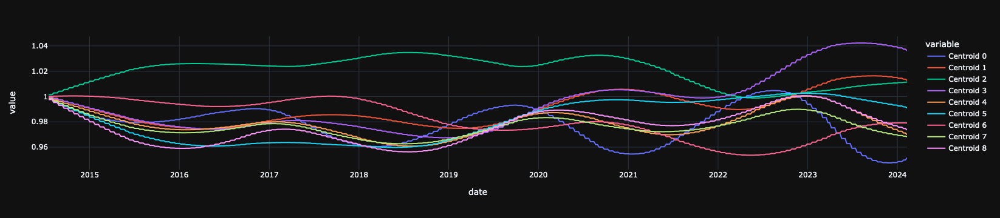

In [32]:
wide_df.query("ticker == 'AAL'").reset_index().set_index("date").drop(columns=["ticker"]).plot()
                                                                                

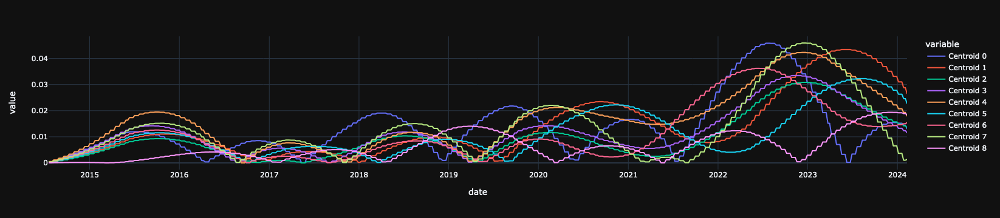

In [116]:
wide_df.query("ticker == 'DAL'").reset_index().set_index("date").drop(columns=["ticker"]).abs().plot()
                                                                                

In [126]:
wide_df.query("date == '2024-02-09'").T.corr()["GOOGL"]

,date,2024-02-09
ticker,date,
A,2024-02-09,0.781779
AAL,2024-02-09,-0.821019
AAPL,2024-02-09,0.989748
AMZN,2024-02-09,0.999869
BAC,2024-02-09,0.986529
DAL,2024-02-09,0.173658
DDD,2024-02-09,-0.963399
GOOGL,2024-02-09,1.000000
IBM,2024-02-09,-0.941890


In [96]:


# Select records using the generated indices
selected_records = result[0][indices]

In [98]:
len(selected_records)

499

In [65]:
output_df

,Ticker,Centroid
0,A,Centroid 1
1,A,Centroid 2
2,A,Centroid 3
3,A,Centroid 4
4,A,Centroid 5
...,...,...
166,V,Centroid 5
167,V,Centroid 6
168,V,Centroid 7
169,V,Centroid 8


In [63]:
distances.shape

(19, 9)

In [62]:
len(result)

171

In [66]:
len(result[0])

499

In [96]:
df_distances

,Centroid 1,Centroid 2,Centroid 3,Centroid 4,Centroid 5,Centroid 6,Centroid 7,Centroid 8,Centroid 9
ticker,,,,,,,,,
A,0.295503,0.675314,0.000000,0.172741,0.276074,4.361806e-01,0.578976,0.106689,0.246636
AAL,0.703101,0.003026,0.660334,0.760789,0.690950,5.117890e-01,0.501692,0.709210,0.597541
AAPL,0.000000,0.668730,0.295503,0.149599,0.279919,4.922840e-01,0.687747,0.234158,0.301845
AMZN,0.127403,0.770971,0.183259,0.004067,0.080543,5.041221e-01,0.609859,0.203847,0.303779
BAC,0.360135,0.469839,0.417384,0.297406,0.124507,6.040424e-01,0.609325,0.449857,0.383915
DAL,0.636236,0.003026,0.663102,0.753188,0.580381,4.900126e-01,0.554650,0.680329,0.567613
DDD,0.698590,0.562125,0.637921,0.671363,0.683648,5.098183e-01,0.091142,0.632848,0.646769
GOOGL,0.141434,0.751841,0.182645,0.004766,0.060988,5.518126e-01,0.617116,0.224042,0.272233
IBM,0.655937,0.425680,0.570951,0.600504,0.623047,5.173222e-01,0.094859,0.623095,0.602565


In [55]:
centroids[:,-2,:]

array([[-0.26257075],
       [ 1.49467929],
       [ 1.63676201],
       [ 1.49987232],
       [ 0.79544824],
       [ 2.0683156 ],
       [ 1.84117905],
       [ 2.28235464],
       [ 1.23353289]])

In [53]:
centroids.shape

(9, 250, 1)

In [46]:
df_distances.T.corr().sort_values("IBM")[["IBM"]]

ticker,IBM
ticker,
V,-0.851150
JPM,-0.840287
TSLA,-0.831157
BAC,-0.829879
KO,-0.809647
MSFT,-0.737199
NVDA,-0.735292
A,-0.660800
MMM,-0.639283


In [25]:
df_distances.T.corr().sort_values("AMZN")[["AMZN"]]

ticker,AMZN
ticker,
BAC,-0.492075
PG,-0.476333
KO,-0.258069
DAL,-0.232758
IBM,-0.211464
AAL,-0.080688
MMM,0.068779
JPM,0.241018
A,0.339333


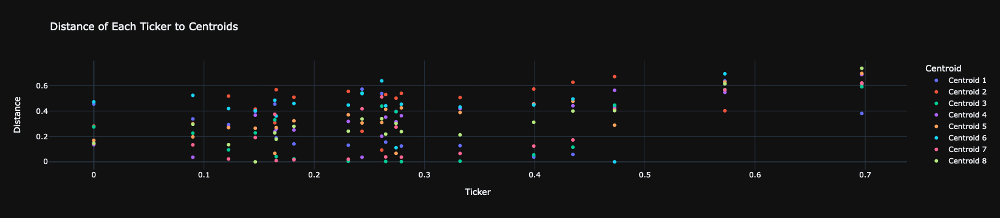

In [16]:
import plotly.express as px
import pandas as pd

# Assuming 'distances' is your array with tickers in the first column and distances in the rest
tickers = distances[:, 0]  # Extract tickers
distances_to_centroids = distances[:, 1:]  # Extract distances

# Convert distances to a DataFrame for easier plotting
df_distances = pd.DataFrame(distances_to_centroids, index=tickers, columns=[f'Centroid {i+1}' for i in range(distances_to_centroids.shape[1])])

# Convert the DataFrame to a long format for Plotly
df_long = df_distances.reset_index().melt(id_vars='index', var_name='Centroid', value_name='Distance')
df_long.rename(columns={'index': 'Ticker'}, inplace=True)

# Create a scatter plot
fig = px.scatter(df_long, x='Ticker', y='Distance', color='Centroid', title="Distance of Each Ticker to Centroids")

# Show the plot
fig.show()


In [8]:
distances.shape

(19, 9)

In [14]:
centroids[:,-1:]

(9, 1, 1)

In [10]:
idx

array([1, 6, 7, 3, 4, 5, 8, 3, 2, 4, 5, 3, 0, 7, 3, 1, 2, 1, 7])

In [360]:
df_standardized

ticker,A,AAL,AAPL,AMZN,BAC,DAL,DDD,GOOGL,IBM,JPM,KO,META,MMM,MSFT,NFLX,NVDA,PG,TSLA,V
date,,,,,,,,,,,,,,,,,,,
2019-05-03,-1.585232,0.278311,-1.552754,-1.922947,-0.038495,0.225894,0.642288,-1.604060,0.582157,-0.764268,-1.295342,-1.813021,-1.110121,-1.718553,-2.100458,-1.103365,-1.992463,-1.393419,-1.026334
2019-05-10,-1.606058,0.306571,-1.570518,-1.912345,-0.034740,0.264130,0.669420,-1.589147,0.606073,-0.769483,-1.173386,-1.790283,-1.050236,-1.691724,-2.074040,-1.103054,-1.962481,-1.373728,-1.002582
2019-05-17,-1.626884,0.334830,-1.588281,-1.901744,-0.030983,0.302366,0.696552,-1.574235,0.629990,-0.774697,-1.051430,-1.767544,-0.990352,-1.664894,-2.047621,-1.096186,-1.932500,-1.354037,-0.978830
2019-05-24,-1.647709,0.363090,-1.606045,-1.891142,-0.027227,0.340603,0.723684,-1.559322,0.653906,-0.779911,-0.929475,-1.744805,-0.930468,-1.638065,-2.021203,-1.089317,-1.902518,-1.334345,-0.955078
2019-05-31,-1.632665,0.391349,-1.623808,-1.880541,-0.023472,0.378839,0.750815,-1.544409,0.677822,-0.785125,-0.807519,-1.722067,-0.870584,-1.611235,-1.994784,-1.082449,-1.872536,-1.314654,-0.931326
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-01-12,0.797044,0.995523,1.590821,2.015552,1.375652,1.043996,-1.236527,1.719465,-0.531070,1.937865,1.614754,2.092984,-0.699602,1.888744,1.485119,2.851438,1.512444,1.470090,1.726121
2024-01-19,0.797044,0.995523,1.717847,2.086985,1.375652,1.027071,-1.236527,1.766654,-0.531070,1.937865,1.614754,2.162607,-0.749986,1.935675,1.502881,2.851438,1.490588,1.488463,1.728352
2024-01-26,0.797044,0.995523,1.844872,2.158419,1.375652,1.010146,-1.236527,1.813844,-0.531070,1.937865,1.614754,2.232230,-0.800369,1.982605,1.502881,2.851438,1.490588,1.506837,1.728352


In [366]:
dicta = {"tickers":df_standardized.columns, "labels":labels}

In [367]:
pd.DataFrame(dicta).sort_values("labels")

,tickers,labels
9,JPM,0.0
10,KO,0.0
4,BAC,1.0
15,NVDA,2.0
17,TSLA,2.0
0,A,3.0
8,IBM,4.0
16,PG,4.0
2,AAPL,5.0
12,MMM,5.0


In [333]:
pd.DataFrame(dicta).sort_values("labels")

,tickers,labels
18,V,1.0
16,PG,1.0
15,NVDA,1.0
14,NFLX,1.0
13,MSFT,1.0
17,TSLA,1.0
0,A,2.0
1,AAL,2.0
11,META,3.0
12,MMM,3.0


Index(['A', 'AAL', 'AAPL', 'AMZN', 'BAC', 'DAL', 'DDD', 'GOOGL', 'IBM', 'JPM',
       'KO', 'META', 'MMM', 'MSFT', 'NFLX', 'NVDA', 'PG', 'TSLA', 'V'],
      dtype='object', name='ticker')

In [324]:
labels

array([1., 1., 1., 1., 1., 2., 2., 2., 0., 2., 2., 0., 0., 0., 1., 1., 1.,
       1., 1.])

In [303]:
labels

array([1., 0., 2., 2., 0., 2., 0., 0., 2.])

In [300]:
labels

array([0., 2., 0., 0., 2., 2., 1., 1., 2.])

In [295]:
labels

array([1., 2., 2., 1., 0., 1., 2., 0., 0.])

In [292]:
labels

array([1., 1., 2., 2., 0., 1., 0., 0., 2.])

In [ ]:
from MFLES.Forecaster import fit_from_df
import dash
from dash import dcc, html, Input, Output, State
import plotly.graph_objs as go
from plotly.subplots import make_subplots
import pandas as pd
from datetime import datetime

df_signal = df_accounting.reset_index()


def scale_predictions(group,selected_feature):
    # Extract the ticker from the group
    ticker = group['ticker'].iloc[0]

    # Use df_signal to get the last actual value and last date for this ticker
    df_signal_group = df_signal[df_signal['ticker'] == ticker]
    last_date = df_signal_group['date'].iloc[-1]
    last_actual_value = df_signal_group[selected_feature].iloc[-1]

    # Check if there are predicted values after the last date
    if any(group["date"] > last_date):
        last_predicted_value = group.loc[group["date"] > last_date, "mfles"].iloc[-1]
        percentage_difference = abs((last_predicted_value - last_actual_value) / last_actual_value) * 100
        scaling_factor = calculate_scaling_factor(percentage_difference)
        
        # Apply scaling to predictions after the last actual value date
        group.loc[group["date"] > last_date, 'mfles'] = group.loc[group["date"] > last_date, 'mfles'].apply(lambda x: ((scaling_factor - 1) * last_actual_value + x) / scaling_factor)
    
    
    return group


# Initialize Dash app
app = dash.Dash(__name__)


app.layout = html.Div([
    html.Div([
        dcc.Dropdown(
            id='feature-dropdown',
            options=[{'label': col, 'value': col} for col in df_signal.columns if col not in ['date', 'ticker']],
            value='total_revenue',  # default value
            style={'width': '50%', 'display': 'inline-block', 'marginRight': '0'}
        ),
        dcc.Checklist(
            id='toggle-predictions',
            options=[{'label': 'Show Only Predictions', 'value': 'only_pred'}],
            value=[],
            style={'width': '50%', 'display': 'inline-block', 'marginLeft': '0'}
        )
    ], style={'display': 'flex'}),
    dcc.Loading(
        id="loading-1",
        type="default",  # You can change the spinner type here
        children=html.Div(dcc.Graph(id='feature-graph'))
    ),
    dcc.Store(id='stored-predictions') 
])


# Callback to update graph based on selected feature
@app.callback(
    Output('stored-predictions', 'data'),
    [Input('feature-dropdown', 'value')]
)
def store_predictions(selected_feature):
    # Fit the forecaster
    output = fit_from_df(df_signal,
                         forecast_horizon=210,
                         freq='W',
                         seasonal_period=[13, 26, 52, 104, 210, 420, 840],
                         id_column='ticker',
                         time_column='date',
                         value_column=selected_feature,
                         floor=0)
    
    output = output.reset_index(drop=True)
    
    # Group by ticker and apply the scaling
    # output = output.groupby('ticker').apply(scale_predictions)

    output = output.groupby('ticker', group_keys=False).apply(lambda group: scale_predictions(group, selected_feature))

    return output.to_json(date_format='iso', orient='split')


# Callback to update graph based on selected feature
@app.callback(
    Output('feature-graph', 'figure'),
    [Input('stored-predictions', 'data'),
     Input('toggle-predictions', 'value')],
    State('feature-dropdown', 'value')
)
def update_graph(output, toggle_state, selected_feature):
    # Fit the forecaster

    output = pd.read_json(output, orient='split')

    ten_years_ago = datetime.today() - pd.DateOffset(years=10)
    filtered_output = output[output['date'] >= ten_years_ago]

    # Today's date for differentiating predictions
    today = datetime.now()

    # Define a color palette
    color_palette = px.colors.qualitative.Plotly

    # Determine the number of rows and columns for the subplots
    num_tickers = len(filtered_output['ticker'].unique())
    cols = 4  # maximum number of columns
    rows = -(-num_tickers // cols)  # ceiling division to get number of rows


    show_only_predictions = 'only_pred' in toggle_state

    # Initialize a figure with subplots
    fig = make_subplots(rows=rows, cols=cols, subplot_titles=filtered_output['ticker'].unique())

    # Loop through each ticker and add traces for actual and predicted data
    for idx, ticker in enumerate(filtered_output['ticker'].unique()):
        color = color_palette[idx % len(color_palette)]
        ticker_data = filtered_output[filtered_output['ticker'] == ticker]

        # Split into actual and predicted data
        actual_data = ticker_data[ticker_data['date'] < today]
        prediction_data = ticker_data[ticker_data['date'] >= today]

        # Calculate row and column index for the current subplot
        row_idx = (idx // cols) + 1
        col_idx = (idx % cols) + 1

        if not show_only_predictions:
            # Add actual data trace
            fig.add_trace(go.Scatter(
                x=actual_data['date'], y=actual_data['mfles'], mode='lines',
                name=f'{ticker} - Actual', line=dict(color=color)),
                row=row_idx, col=col_idx)

        # Add predicted data trace
        if not prediction_data.empty:
            fig.add_trace(go.Scatter(
                x=prediction_data['date'], y=prediction_data['mfles'], mode='lines',
                name=f'{ticker} - Predicted', line=dict(color=color, dash='dot')),
                row=row_idx, col=col_idx)
            
        # # Add actual data trace
        # fig.add_trace(go.Scatter(x=actual_data['date'], y=actual_data['mfles'], mode='lines', name=f'{ticker} - Actual', line=dict(color=color)), row=row_idx, col=col_idx)

        # # Add predicted data trace
        # if not prediction_data.empty:
        #     fig.add_trace(go.Scatter(x=prediction_data['date'], y=prediction_data['mfles'], mode='lines', name=f'{ticker} - Predicted', line=dict(color=color, dash='dot')), row=row_idx, col=col_idx)
    
    
    def format_title(feature):
        """Format the feature string by replacing underscores with spaces and capitalizing the first letter."""
        return ' '.join(word.capitalize() for word in feature.split('_'))
    
    # Inside your update_graph function
    title = f"{format_title(selected_feature)} Nowcasted for Each Ticker"

    # Update layout for the main figure
    fig.update_layout(height=300 * rows, title_text=title, template='plotly_dark', showlegend=False)

    return fig

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True)


100%|██████████████████████████████████████████████████████████████████████| 9/9 [00:01<00:00,  5.60it/s]
/var/folders/tj/2qbc2n2x1234_l7b3z5y06740000gn/T/ipykernel_80710/3895804246.py:43: FutureWarning:

Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)



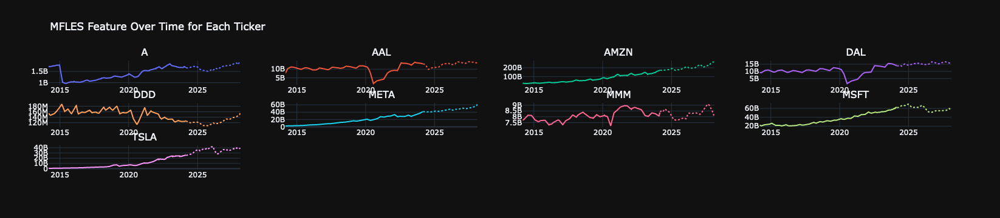

In [223]:
from MFLES.Forecaster import fit_from_df

output = fit_from_df(df_signal,
                      forecast_horizon=210,
                      freq='W',
                      seasonal_period=[13, 26, 52, 104,210,420, 840],
                      id_column='ticker',
                      time_column='date',
                      value_column='total_revenue',
                      floor=0)


output = output.reset_index(drop=True)

def calculate_scaling_factor(percentage_diff):
    # Define the function as before
    base_multiplier = 2
    scaling_factor = 0.01
    return base_multiplier + scaling_factor * percentage_diff


def scale_predictions(group):
    # Extract the ticker from the group
    ticker = group['ticker'].iloc[0]

    # Use df_signal to get the last actual value and last date for this ticker
    df_signal_group = df_signal[df_signal['ticker'] == ticker]
    last_date = df_signal_group['date'].iloc[-1]
    last_actual_value = df_signal_group['total_revenue'].iloc[-1]

    # Check if there are predicted values after the last date
    if any(group["date"] > last_date):
        last_predicted_value = group.loc[group["date"] > last_date, "mfles"].iloc[-1]
        percentage_difference = abs((last_predicted_value - last_actual_value) / last_actual_value) * 100
        scaling_factor = calculate_scaling_factor(percentage_difference)
        
        # Apply scaling to predictions after the last actual value date
        group.loc[group["date"] > last_date, 'mfles'] = group.loc[group["date"] > last_date, 'mfles'].apply(lambda x: ((scaling_factor - 1) * last_actual_value + x) / scaling_factor)

    # deviation = (group["total_revenue"]-group["mfles"]).std()

    # group["upper"]=  group["mfles"] + deviation

    # group["lower"] = group["mfles"] - deviation
    
    
    return group

# Group by ticker and apply the scaling
output = output.groupby('ticker').apply(scale_predictions)


import plotly.graph_objs as go
from plotly.subplots import make_subplots
import pandas as pd
from datetime import datetime

# Filter the DataFrame to include only the last 10 years
ten_years_ago = datetime.today() - pd.DateOffset(years=10)
filtered_output = output[output['date'] >= ten_years_ago]

# Today's date for differentiating predictions
today = datetime.now()

# Define a color palette
color_palette = px.colors.qualitative.Plotly

# Determine the number of rows and columns for the subplots
num_tickers = len(filtered_output['ticker'].unique())
cols = 4  # maximum number of columns
rows = -(-num_tickers // cols)  # ceiling division to get number of rows

# Initialize a figure with subplots
fig = make_subplots(rows=rows, cols=cols, subplot_titles=filtered_output['ticker'].unique())

# Loop through each ticker and add traces for actual and predicted data
for idx, ticker in enumerate(filtered_output['ticker'].unique()):
    color = color_palette[idx % len(color_palette)]
    ticker_data = filtered_output[filtered_output['ticker'] == ticker]

    # Split into actual and predicted data
    actual_data = ticker_data[ticker_data['date'] < today]
    prediction_data = ticker_data[ticker_data['date'] >= today]

    # Calculate row and column index for the current subplot
    row_idx = (idx // cols) + 1
    col_idx = (idx % cols) + 1

    # Add actual data trace
    fig.add_trace(go.Scatter(x=actual_data['date'], y=actual_data['mfles'], mode='lines', name=f'{ticker} - Actual', line=dict(color=color)), row=row_idx, col=col_idx)

    # Add predicted data trace
    if not prediction_data.empty:
        fig.add_trace(go.Scatter(x=prediction_data['date'], y=prediction_data['mfles'], mode='lines', name=f'{ticker} - Predicted', line=dict(color=color, dash='dot')), row=row_idx, col=col_idx)

# Update layout for the main figure
fig.update_layout(height=300 * rows, title_text='MFLES Feature Over Time for Each Ticker', template='plotly_dark',showlegend=False)

# Show the plot
fig.show()


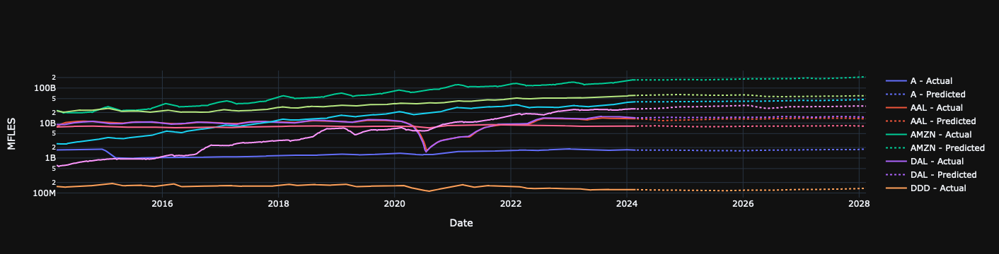

In [211]:
import plotly.graph_objs as go
import pandas as pd
from datetime import datetime

# Filter the DataFrame to include only the last 10 years
ten_years_ago = datetime.today() - pd.DateOffset(years=10)
filtered_output = output[output['date'] >= ten_years_ago]

# Today's date for differentiating predictions
today = datetime.now()

# Define a color palette
color_palette = px.colors.qualitative.Plotly

# Initialize a figure
fig = go.Figure()

# Loop through each ticker and add traces for actual and predicted data
for idx, ticker in enumerate(filtered_output['ticker'].unique()):
    color = color_palette[idx % len(color_palette)]
    ticker_data = filtered_output[filtered_output['ticker'] == ticker]

    # Split into actual and predicted data
    actual_data = ticker_data[ticker_data['date'] < today]
    prediction_data = ticker_data[ticker_data['date'] >= today]

    # Add actual data trace
    fig.add_trace(go.Scatter(x=actual_data['date'], y=actual_data['mfles'], mode='lines', name=f'{ticker} - Actual', line=dict(color=color)))

    # Add predicted data trace
    if not prediction_data.empty:
        fig.add_trace(go.Scatter(x=prediction_data['date'], y=prediction_data['mfles'], mode='lines', name=f'{ticker} - Predicted', line=dict(color=color, dash='dot')))

# Set y-axis to logarithmic scale
fig.update_layout(yaxis_type="log", xaxis_title='Date', yaxis_title='MFLES', template='plotly_dark')

# Show the plot
fig.show()


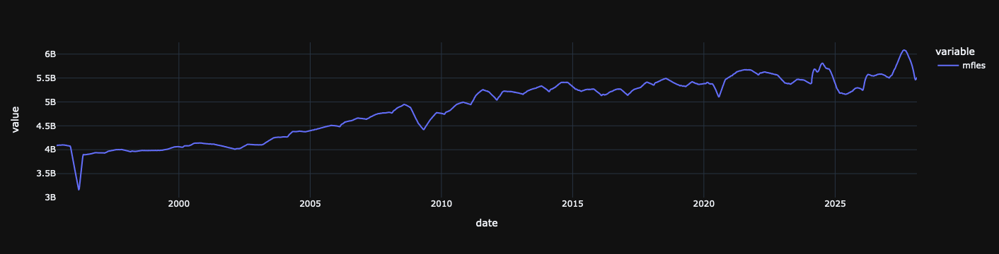

In [175]:
output[["date","mfles"]].set_index("date").plot()

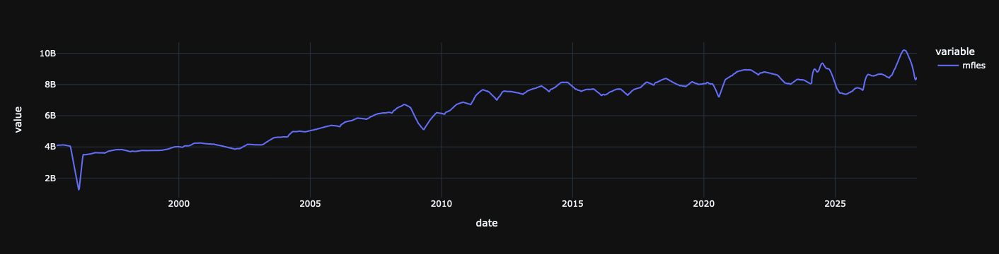

In [173]:
output[["date","mfles"]].set_index("date").plot()

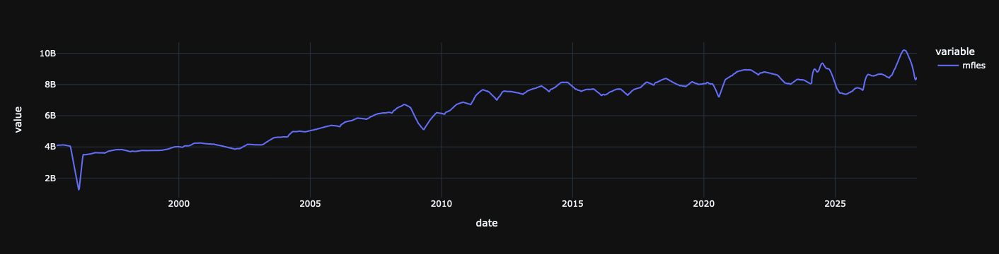

In [169]:
output[["date","mfles"]].set_index("date").plot()

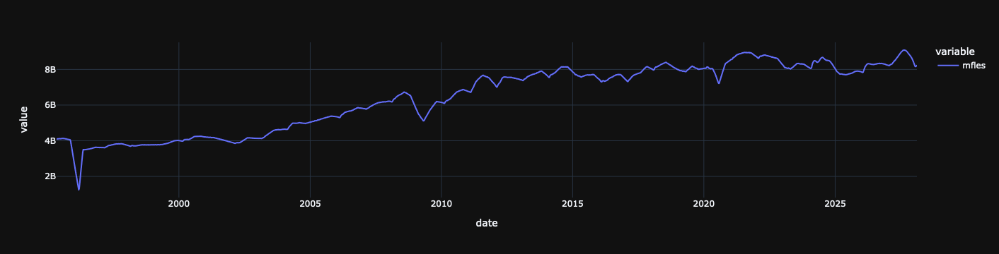

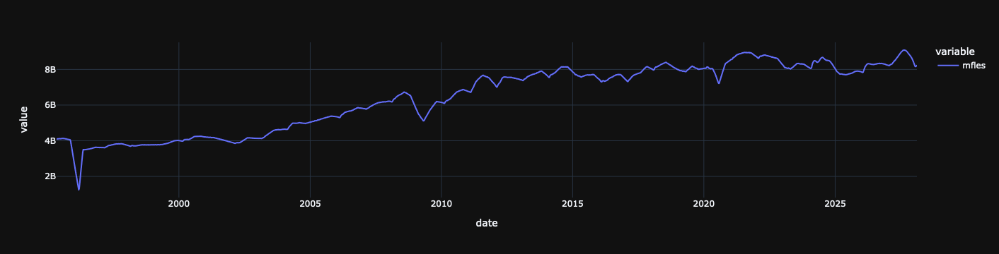

In [147]:
output[["date","mfles"]].set_index("date").plot()

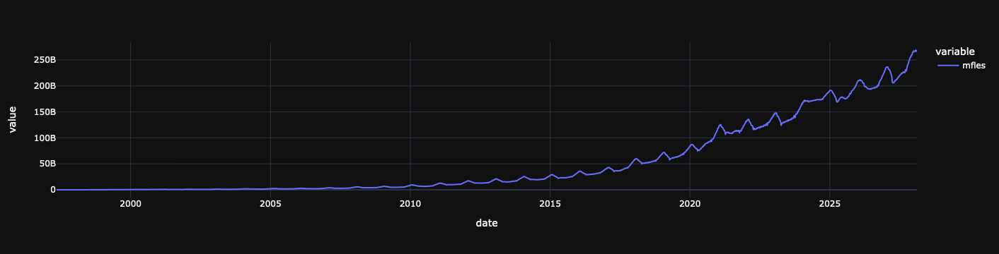

In [135]:
output[["date","mfles"]].set_index("date").plot()

In [124]:
output[output["date"]>last_date]

ticker       date  total_revenue         mfles
ticker                                                  
AMZN   0    AMZN 2024-02-11            NaN  1.707574e+11
       1    AMZN 2024-02-18            NaN  1.719642e+11
       2    AMZN 2024-02-25            NaN  1.728019e+11
       3    AMZN 2024-03-03            NaN  1.720997e+11
       4    AMZN 2024-03-10            NaN  1.712217e+11
       5    AMZN 2024-03-17            NaN  1.723467e+11
       6    AMZN 2024-03-24            NaN  1.729943e+11
       7    AMZN 2024-03-31            NaN  1.687299e+11
       8    AMZN 2024-04-07            NaN  1.696439e+11
       9    AMZN 2024-04-14            NaN  1.713231e+11
       10   AMZN 2024-04-21            NaN  1.716498e+11
       11   AMZN 2024-04-28            NaN  1.717523e+11
       12   AMZN 2024-05-05            NaN  1.723528e+11
       13   AMZN 2024-05-12            NaN  1.717417e+11
       14   AMZN 2024-05-19            NaN  1.727467e+11
       15   AMZN 2024-05-26            NaN  1.729997e+11
       16   AMZN 2024-06-02            NaN  1.737929e+11
       17   AMZN 2024-06-09            NaN  1.744993e+11
       18   AMZN 2024-06-16            NaN  1.739433e+11
       19   AMZN 2024-06-23            NaN  1.749702e+11
       20   AMZN 2024-06-30            NaN  1.743890e+11
       21   AMZN 2024-07-07            NaN  1.762209e+11
       22   AMZN 2024-07-14            NaN  1.764222e+11
       23   AMZN 2024-07-21            NaN  1.766833e+11
       24   AMZN 2024-07-28            NaN  1.770502e+11
       25   AMZN 2024-08-04            NaN  1.774508e+11
       26   AMZN 2024-08-11            NaN  1.761129e+11
       27   AMZN 2024-08-18            NaN  1.769484e+11
       28   AMZN 2024-08-25            NaN  1.777988e+11
       29   AMZN 2024-09-01            NaN  1.770023e+11
       30   AMZN 2024-09-08            NaN  1.760504e+11
       31   AMZN 2024-09-15            NaN  1.777774e+11
       32   AMZN 2024-09-22            NaN  1.800009e+11
       33   AMZN 2024-09-29            NaN  1.775779e+11
       34   AMZN 2024-10-06            NaN  1.811163e+11
       35   AMZN 2024-10-13            NaN  1.851769e+11
       36   AMZN 2024-10-20            NaN  1.871054e+11
       37   AMZN 2024-10-27            NaN  1.886959e+11
       38   AMZN 2024-11-03            NaN  1.913210e+11
       39   AMZN 2024-11-10            NaN  1.927092e+11
       40   AMZN 2024-11-17            NaN  1.959780e+11
       41   AMZN 2024-11-24            NaN  1.976460e+11
       42   AMZN 2024-12-01            NaN  1.996650e+11
       43   AMZN 2024-12-08            NaN  2.018167e+11
       44   AMZN 2024-12-15            NaN  2.027849e+11
       45   AMZN 2024-12-22            NaN  2.062034e+11
       46   AMZN 2024-12-29            NaN  2.067986e+11
       47   AMZN 2025-01-05            NaN  2.099137e+11
       48   AMZN 2025-01-12            NaN  2.097613e+11
       49   AMZN 2025-01-19            NaN  2.091176e+11
       50   AMZN 2025-01-26            NaN  2.080498e+11
       51   AMZN 2025-02-02            NaN  2.061724e+11

In [120]:
output[output["date"]>last_date]

ticker       date  total_revenue         mfles
ticker                                                  
AMZN   0    AMZN 2024-02-11            NaN  1.719851e+11
       1    AMZN 2024-02-18            NaN  1.750520e+11
       2    AMZN 2024-02-25            NaN  1.771812e+11
       3    AMZN 2024-03-03            NaN  1.753964e+11
       4    AMZN 2024-03-10            NaN  1.731649e+11
       5    AMZN 2024-03-17            NaN  1.760242e+11
       6    AMZN 2024-03-24            NaN  1.776700e+11
       7    AMZN 2024-03-31            NaN  1.668323e+11
       8    AMZN 2024-04-07            NaN  1.691550e+11
       9    AMZN 2024-04-14            NaN  1.734228e+11
       10   AMZN 2024-04-21            NaN  1.742530e+11
       11   AMZN 2024-04-28            NaN  1.745136e+11
       12   AMZN 2024-05-05            NaN  1.760398e+11
       13   AMZN 2024-05-12            NaN  1.744866e+11
       14   AMZN 2024-05-19            NaN  1.770407e+11
       15   AMZN 2024-05-26            NaN  1.776839e+11
       16   AMZN 2024-06-02            NaN  1.796998e+11
       17   AMZN 2024-06-09            NaN  1.814951e+11
       18   AMZN 2024-06-16            NaN  1.800819e+11
       19   AMZN 2024-06-23            NaN  1.826917e+11
       20   AMZN 2024-06-30            NaN  1.812148e+11
       21   AMZN 2024-07-07            NaN  1.858703e+11
       22   AMZN 2024-07-14            NaN  1.863821e+11
       23   AMZN 2024-07-21            NaN  1.870456e+11
       24   AMZN 2024-07-28            NaN  1.879780e+11
       25   AMZN 2024-08-04            NaN  1.889963e+11
       26   AMZN 2024-08-11            NaN  1.855959e+11
       27   AMZN 2024-08-18            NaN  1.877194e+11
       28   AMZN 2024-08-25            NaN  1.898806e+11
       29   AMZN 2024-09-01            NaN  1.878562e+11
       30   AMZN 2024-09-08            NaN  1.854371e+11
       31   AMZN 2024-09-15            NaN  1.898263e+11
       32   AMZN 2024-09-22            NaN  1.954771e+11
       33   AMZN 2024-09-29            NaN  1.893192e+11
       34   AMZN 2024-10-06            NaN  1.983119e+11
       35   AMZN 2024-10-13            NaN  2.086319e+11
       36   AMZN 2024-10-20            NaN  2.135331e+11
       37   AMZN 2024-10-27            NaN  2.175754e+11
       38   AMZN 2024-11-03            NaN  2.242471e+11
       39   AMZN 2024-11-10            NaN  2.277752e+11
       40   AMZN 2024-11-17            NaN  2.360827e+11
       41   AMZN 2024-11-24            NaN  2.403219e+11
       42   AMZN 2024-12-01            NaN  2.454531e+11
       43   AMZN 2024-12-08            NaN  2.509216e+11
       44   AMZN 2024-12-15            NaN  2.533823e+11
       45   AMZN 2024-12-22            NaN  2.620703e+11
       46   AMZN 2024-12-29            NaN  2.635829e+11
       47   AMZN 2025-01-05            NaN  2.715001e+11
       48   AMZN 2025-01-12            NaN  2.711127e+11
       49   AMZN 2025-01-19            NaN  2.694768e+11
       50   AMZN 2025-01-26            NaN  2.667630e+11
       51   AMZN 2025-02-02            NaN  2.619914e+11

In [110]:
last_date

1396

In [108]:
output

ticker       date  total_revenue         mfles
ticker                                                  
AMZN   0    AMZN 1997-05-09     16005000.0  1.600500e+07
       1    AMZN 1997-05-16     16916538.0  1.691654e+07
       2    AMZN 1997-05-23     17828076.0  1.661380e+07
       3    AMZN 1997-05-30     18739616.0  1.762070e+07
       4    AMZN 1997-06-06     19651154.0  1.873094e+07
...          ...        ...            ...           ...
       47   AMZN 2025-01-05            NaN  2.715001e+11
       48   AMZN 2025-01-12            NaN  2.711127e+11
       49   AMZN 2025-01-19            NaN  2.694768e+11
       50   AMZN 2025-01-26            NaN  2.667630e+11
       51   AMZN 2025-02-02            NaN  2.619914e+11

[1449 rows x 4 columns]

In [121]:
from MFLES.Forecaster import MFLES
import matplotlib.pyplot as plt
import numpy as np
import plotly.graph_objs as go
import pandas as pd

df_signal = df_accounting.query("ticker == 'AMZN'").reset_index().set_index("date")

mfles = MFLES()

fitted = mfles.fit(df_signal["total_revenue"].values, seasonal_period=[13, 26, 52, 104,210,420, 840],smoother=True,freq="W")
predicted = mfles.predict(365)




# Assuming the rest of your code is as provided

# Create a date range for the predicted values
last_date = df_signal.index[-1]
prediction_dates = pd.date_range(start=last_date, periods=len(scaled_predictions_series) + 1, closed='right')

# Create a Plotly graph
fig = go.Figure()

# Add the actual values
fig.add_trace(go.Scatter(x=df_signal.index, y=df_signal['total_revenue'], mode='lines', name='Actual'))

# Add the scaled predictions
fig.add_trace(go.Scatter(x=prediction_dates, y=scaled_predictions_series, mode='lines', name='Predicted'))

# Update layout
fig.update_layout(title='Total Revenue: Actual vs Predicted',
                  xaxis_title='Date',
                  yaxis_title='Total Revenue',
                  template='plotly_dark')

# Show the plot
fig.show()

# Now, scaled_predictions contains your normalized predictions

plt.plot(np.append(fitted, scaled_predictions_series))
plt.plot(df_signal['total_revenue'].values)

TypeError: MFLES.fit() got an unexpected keyword argument 'freq'

/var/folders/tj/2qbc2n2x1234_l7b3z5y06740000gn/T/ipykernel_80710/3006399856.py:46: FutureWarning:

Argument `closed` is deprecated in favor of `inclusive`.



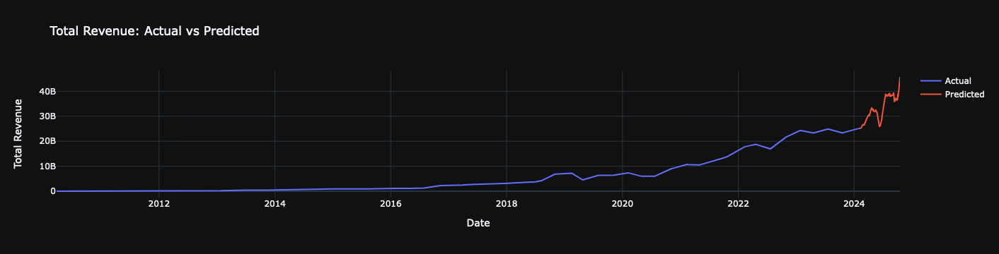

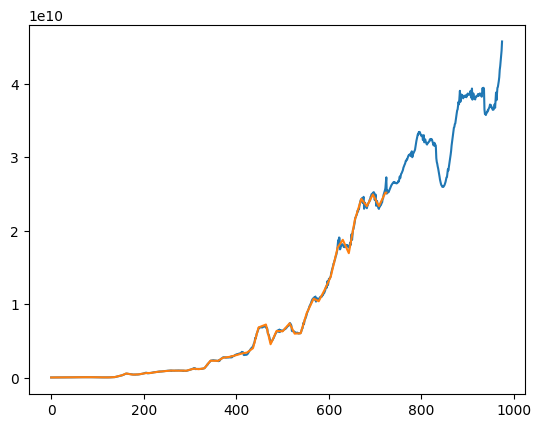

Argument `closed` is deprecated in favor of `inclusive`.


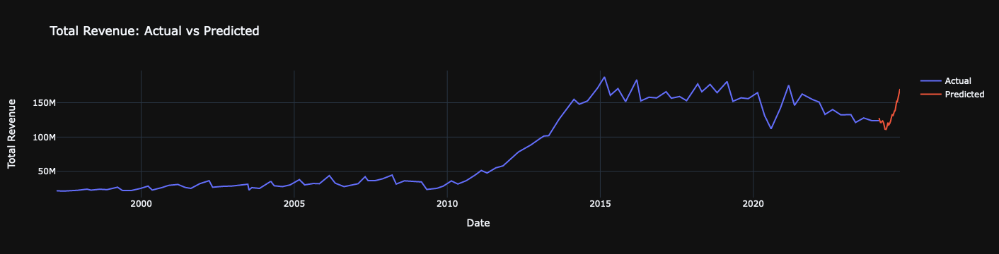

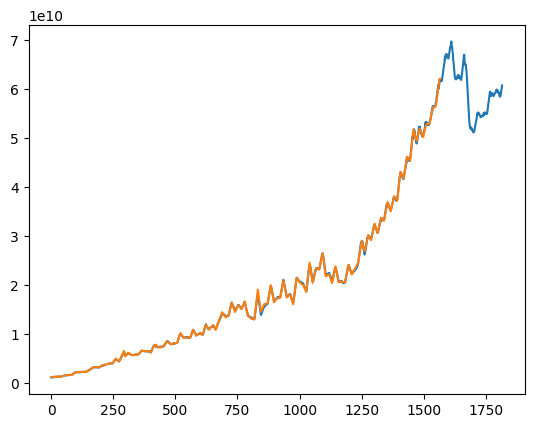

In [83]:
import pandas as pd

# Assuming df_accounting is your existing DataFrame
# Step 1: Reset Index
df_reset = df_accounting.reset_index()

# Step 2: Melt
data_long = df_reset.melt(id_vars=['ticker', 'date'], var_name='unique_id', value_name='y')

# Step 3: Rename Columns
data_long.rename(columns={'date': 'ds', 'ticker': 'id'}, inplace=True)


In [84]:
data_long["unique_id"] = data_long["id"]  + "_" + data_long["unique_id"] 

In [85]:
data_long = data_long.drop(columns=["id"])

In [87]:
data_long = data_long[data_long["unique_id"]=="META_total_revenue"]

In [89]:
!pip install neuralforecast

  Using cached msgpack-1.0.7-cp311-cp311-macosx_11_0_arm64.whl.metadata (9.1 kB)
  Using cached alembic-1.13.1-py3-none-any.whl.metadata (7.4 kB)
  Using cached Mako-1.3.2-py3-none-any.whl.metadata (2.9 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 170.6/170.6 kB 3.9 MB/s eta 0:00:00 MB/s eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 63.6/63.6 MB 33.8 MB/s eta 0:00:00m eta 0:00:010:01:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 413.4/413.4 kB 33.8 MB/s eta 0:00:00
Using cached alembic-1.13.1-py3-none-any.whl (233 kB)
Using cached msgpack-1.0.7-cp311-cp311-macosx_11_0_arm64.whl (231 kB)
Using cached Mako-1.3.2-py3-none-any.whl (78 kB)


In [1]:
!pip install MFLES

NameError: name 'df_accounting' is not defined

In [86]:
## This nowcasting model is probably the best. 
from statsforecast import StatsForecast
from statsforecast.models import (

    RandomWalkWithDrift,
    HoltWinters,
    AutoCES,

)


models = [

    HoltWinters(6, alias="holtadd6", error_type="A"),
    HoltWinters(13, alias="holtadd13", error_type="A"),
    HoltWinters(52, alias="holtadd52", error_type="A"),
    HoltWinters(105, alias="holtadd105", error_type="A"),
    HoltWinters(210, alias="holtadd210", error_type="A"),
    HoltWinters(420, alias="holtadd420", error_type="A"),
    HoltWinters(840, alias="holtadd840", error_type="A"),
    
    

    AutoCES(6, alias="ces6"),
    AutoCES(13, alias="ces13"),
    AutoCES(52, alias="ces52"),
    AutoCES(105, alias="ces105"),
    AutoCES(210, alias="ces210"),
    AutoCES(420, alias="ces420"),
    AutoCES(840, alias="ces840"),
    
    


]

# Instantiate StatsForecast class as sf
sf = StatsForecast(
    models=models,
    freq='W',
    fallback_model = RandomWalkWithDrift(),
    n_jobs=-1,
)

forecasts_df = sf.forecast(df=data_long, h=105)
forecasts_df.head()
forecasts_df_new = forecasts_df.copy()
forecasts_df_new["y"] = forecasts_df_new.drop(columns=["ds"]).median(axis=1)
forecasts_df_new = forecasts_df_new[["ds","y"]]


Forecast:   0%|          | 0/91 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [81]:
data_mot = pd.concat([data_long.set_index("unique_id"),forecasts_df_new],axis=0)

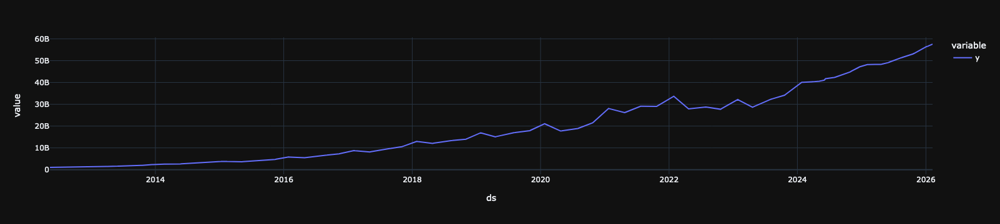

In [82]:
data_mot.set_index("ds", drop=True).plot()

In [15]:
forecasts_df_new

,ds,HOLT
unique_id,,
META_total_revenue,2024-02-11,4.014858e+10
META_total_revenue,2024-02-18,4.018612e+10
META_total_revenue,2024-02-25,4.015711e+10
META_total_revenue,2024-03-03,4.012378e+10
META_total_revenue,2024-03-10,4.008419e+10
...,...,...
META_total_revenue,2026-01-11,5.661476e+10
META_total_revenue,2026-01-18,5.687466e+10
META_total_revenue,2026-01-25,5.718005e+10


In [ ]:
!pip install git+https://github.com/uber/orbit.git@dev


In [ ]:
## uber model https://github.com/uber/orbit
## pretty good bayesian nowcasting https://colab.research.google.com/github/edwinnglabs/ts-playground/blob/master/Orbit_Tutorial.ipynb#scrollTo=cCKbbDQaydlZ

In [54]:
!pip install pyoats

ERROR: Ignored the following versions that require a different python version: 0.1.0 Requires-Python >=3.8,<3.11; 0.1.1 Requires-Python >=3.7.2,<3.11; 0.1.2 Requires-Python >=3.8,<3.11
ERROR: Could not find a version that satisfies the requirement pyoats (from versions: none)
ERROR: No matching distribution found for pyoats


In [ ]:
from oats.models import *
TRAIN_SIZE = 5000
mp_model = MatrixProfileModel(window=48, use_gpu=True) # Try changing the model or window size
# Since Matrix Profile doesn't require fitting, let's just get the scores on the whole set!
mp_scores = mp_model.get_scores(df.values.astype(np.double))
mp_scores[:TRAIN_SIZE] = 0 #To emulate the fact that we only care about points after TRAIN_SIZE

In [18]:
from sovai.extensions.cum_sum_torch import CusumMeanDetector

In [52]:
df_signal = df_accounting.query("ticker == 'META'").reset_index().set_index("date")["total_revenue"]

signal_array = df_signal.values

In [ ]:
## maybe for market data this would be better

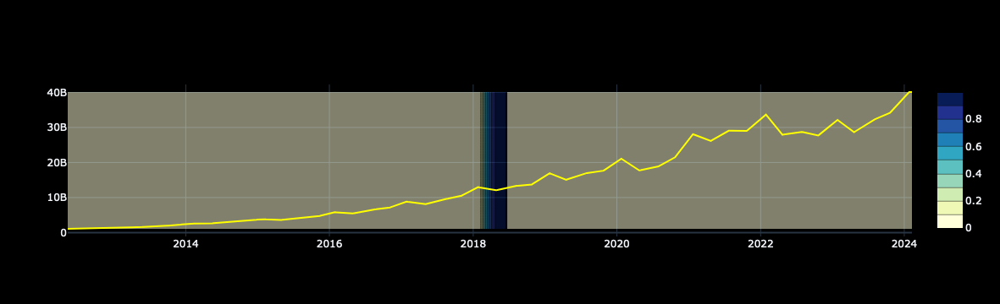

In [53]:
import plotly.graph_objects as go
import numpy as np
import torch

# Assuming the rest of your code (including the definition of y, CusumMeanDetector, etc.) is above this

test = CusumMeanDetector()

y = torch.from_numpy(signal_array)

outs = [test.predict_next(y[i]) for i in range(len(y))]

cps = np.where(list(map(lambda x: x[1], outs)))[0]
probs = np.array(list(map(lambda x: x[0], outs)))
X, Y = np.meshgrid(np.arange(len(y)), np.linspace(torch.min(y).detach().numpy(), torch.max(y).detach().numpy()))
Z = probs[X]

date_strings = df_signal.index.strftime('%Y-%m-%d')

# Creating the contour plot
contour = go.Contour(
    z=Z, 
    x=df_signal.index, 
    y=np.linspace(torch.min(y).detach().numpy(), torch.max(y).detach().numpy()), 
    colorscale='YlGnBu',  # This is a yellow-green-blue scale which should contrast well in dark mode
    opacity=0.5  # Adjust opacity as needed for better contrast
)

# Creating the line plot with a bright color
line = go.Scatter(
    x=df_signal.index, 
    y=y.detach().numpy(), 
    mode='lines', 
    line=dict(color='yellow'),  # Bright yellow line for contrast
    name='Data'
)

# Combining all elements in a figure
fig = go.Figure(data=[contour, line])

# Updating layout for dark mode
fig.update_layout(
    plot_bgcolor='rgba(0,0,0,1)',  # Setting the background to black
    paper_bgcolor='rgba(0,0,0,1)',  # Setting the paper background to black
)

# Adding detected changepoints
shapes = [dict(
    type='line', 
    x0=cp, 
    y0=0, 
    x1=cp, 
    y1=1, 
    line=dict(
        color='red',
        dash='dash',
        width=2
    )) for cp in cps]

fig.update_layout(shapes=shapes)
fig.update_xaxes(showgrid=True, gridwidth=1)
fig.update_yaxes(showgrid=True, gridwidth=1)

min_date = df_signal.index.min()
max_date = df_signal.index.max()
fig.update_xaxes(range=[min_date, max_date])

fig.show()


In [91]:
import numpy as np
from sovai.extensions.change_point_generator import ChangePointGenerator
from sovai.extensions.cusum import CUSUM_Detector, ProbCUSUM_Detector, ChartCUSUM_Detector

In [93]:
# Generate time series data with change points
generator = ChangePointGenerator(num_segments=3, segment_length=1000, change_point_type='sudden_shift')
generator.generate_data()

In [100]:
df_signal = df_accounting.query("ticker == 'META'").reset_index().set_index("date")["total_revenue"]

signal_array = df_signal.pct_change(52).values

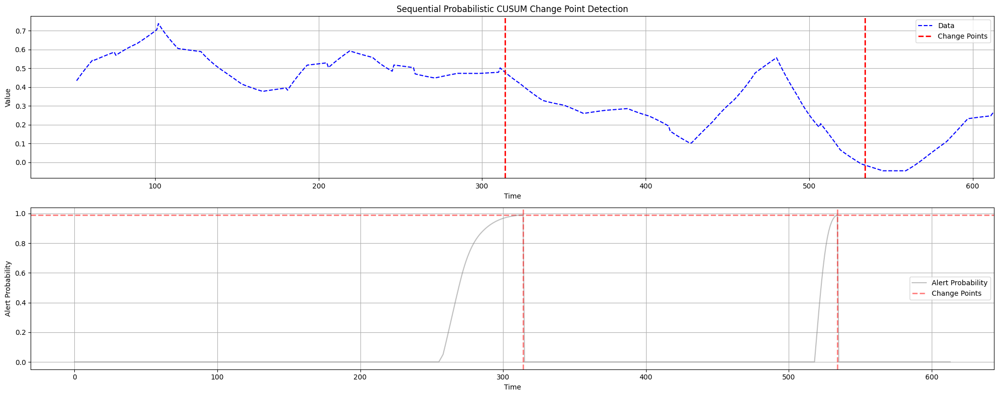

In [101]:
# Detect change points using Probabilistic CUSUM Detector
prob_cusum_detector = ProbCUSUM_Detector(warmup_period=205, threshold_probability=0.01)
prob_probabilities, prob_change_points = prob_cusum_detector.detect_change_points(signal_array)

# Plot the detected change points using Probabilistic CUSUM Detector
prob_cusum_detector.plot_change_points(signal_array, prob_change_points, prob_probabilities)


In [27]:
!pip install ruptures

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 308.1/308.1 kB 1.2 MB/s eta 0:00:001.2 MB/s eta 0:00:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for ruptures: filename=ruptures-1.1.9-cp311-cp311-macosx_14_0_arm64.whl size=475437 sha256=86c573974c13fc8612872002790f72518483f58d0a5e71dd84b7a45ee4e450ed
  Stored in directory: /Users/dereksnow/Library/Caches/pip/wheels/91/4b/b2/08e23635050124c9dfc36d6a86ca63f025a8aa86c31a7e011d
Successfully built ruptures


In [50]:
df_signal

Series([], Name: total_revenue, dtype: float64)

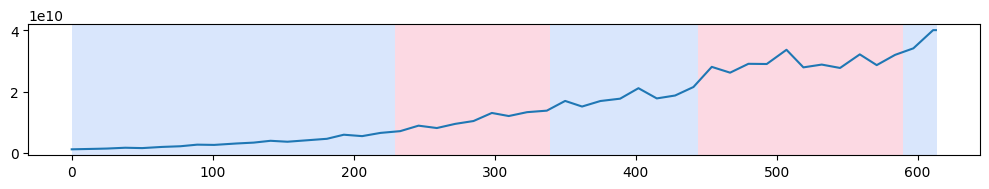

In [54]:
import matplotlib.pyplot as plt
import ruptures as rpt

# generate signal
n_samples, dim, sigma = 1000, 3, 4
n_bkps = 4  # number of breakpoints
df_signal = df_accounting.query("ticker == 'META'").reset_index().set_index("date")["total_revenue"]

signal_array = df_signal.values

# detection
algo = rpt.Pelt(model="rbf").fit(signal_array)
breakpoints = algo.predict(pen=10)

# display
rpt.display(signal_array, breakpoints)
plt.show()




In [55]:
breakpoints = [r-1 for r in breakpoints]

In [ ]:
https://github.com/giobbu/CUSUM/blob/main/example.ipynb
https://sarem-seitz.com/posts/probabilistic-cusum-for-change-point-detection/

## I am a big fan of probabilistic detection (its more complex than ruptures, so create as scientific module)

this is really cool, probabilistic cusom, you can see as it develops.

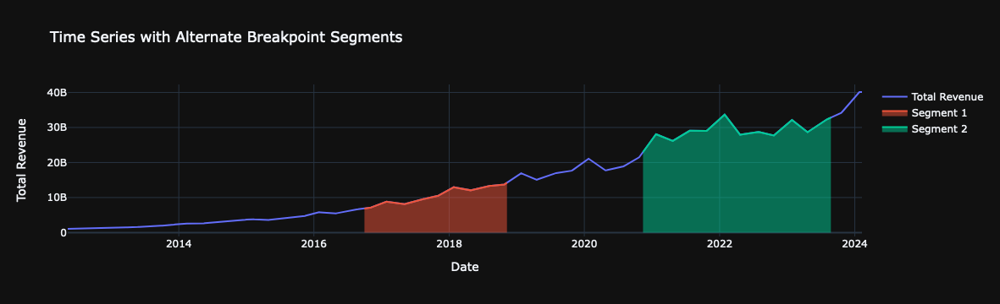

In [56]:

import plotly.graph_objects as go

# Ensure breakpoints are within the range of df_signal's index
dates = df_signal.index.tolist()
max_index = len(dates) - 1  # Maximum valid index
valid_breakpoints = [bp for bp in breakpoints if bp <= max_index]
breakpoint_dates = [dates[idx] for idx in valid_breakpoints]


# Create a Plotly line plot
fig = go.Figure()

# Plot the entire time series
fig.add_trace(go.Scatter(x=df_signal.index, y=df_signal, mode='lines', name='Total Revenue'))

# Highlight every other segment between breakpoints
for i in range(len(breakpoint_dates) - 1):
    if i % 2 == 0:  # Highlight segments at even indices (0, 2, 4, ...)
        start_date = breakpoint_dates[i]
        end_date = breakpoint_dates[i + 1]
        segment = df_signal[start_date:end_date]
        fig.add_trace(go.Scatter(x=segment.index, y=segment, mode='lines', name=f'Segment {i//2 + 1}', fill='tozeroy'))

# Update layout
fig.update_layout(title='Time Series with Alternate Breakpoint Segments',
                  xaxis_title='Date',
                  yaxis_title='Total Revenue',
                  showlegend=True)

# Show the figure
fig.show()


In [68]:
breakpoints

[135, 250, 360, 430, 505, 575, 614]

In [79]:
import matplotlib.pyplot as plt
import ruptures as rpt


df_signal = df_accounting.query("ticker == 'META'").reset_index().set_index("date").drop(columns=["ticker"])

signal_array = df_signal.values

# detection
algo = rpt.Pelt(model="rbf").fit(signal_array)
breakpoints = algo.predict(pen=10)

# # display
# rpt.display(signal_array, breakpoints)
# plt.show()



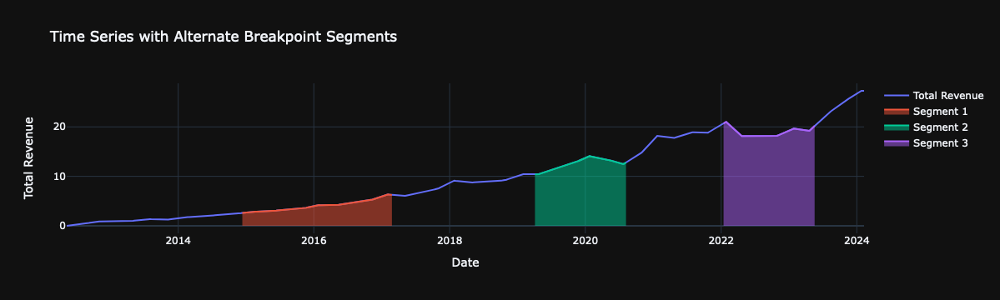

In [86]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Scale the data
scaler = StandardScaler()

# df_signal = df_accounting.query("ticker == 'META'").reset_index().set_index("date").drop(columns=["ticker"])
df_scaled = scaler.fit_transform(df_signal)

# Apply PCA
pca = PCA(n_components=1)  # Reduce to 1 dimension
df_pca = pca.fit_transform(df_scaled)

# Shift PCA values to be positive
min_pca_value = df_pca.min()
if min_pca_value < 0:
    df_pca -= min_pca_value

# Convert to DataFrame for easier handling
df_pca = pd.DataFrame(df_pca, columns=['PC1'], index=df_signal.index)["PC1"]


import plotly.graph_objects as go

# Ensure breakpoints are within the range of df_signal's index
dates = df_pca.index.tolist()
max_index = len(dates) - 1  # Maximum valid index
valid_breakpoints = [bp for bp in breakpoints if bp <= max_index]
breakpoint_dates = [dates[idx] for idx in valid_breakpoints]


# Create a Plotly line plot
fig = go.Figure()

# Plot the entire time series
fig.add_trace(go.Scatter(x=df_pca.index, y=df_pca, mode='lines', name='Total Revenue'))

# Highlight every other segment between breakpoints
for i in range(len(breakpoint_dates) - 1):
    if i % 2 == 0:  # Highlight segments at even indices (0, 2, 4, ...)
        start_date = breakpoint_dates[i]
        end_date = breakpoint_dates[i + 1]
        segment = df_pca[start_date:end_date]
        fig.add_trace(go.Scatter(x=segment.index, y=segment, mode='lines', name=f'Segment {i//2 + 1}', fill='tozeroy'))

# Update layout
fig.update_layout(title='Time Series with Alternate Breakpoint Segments',
                  xaxis_title='Date',
                  yaxis_title='Total Revenue',
                  showlegend=True)

# Show the figure
fig.show()


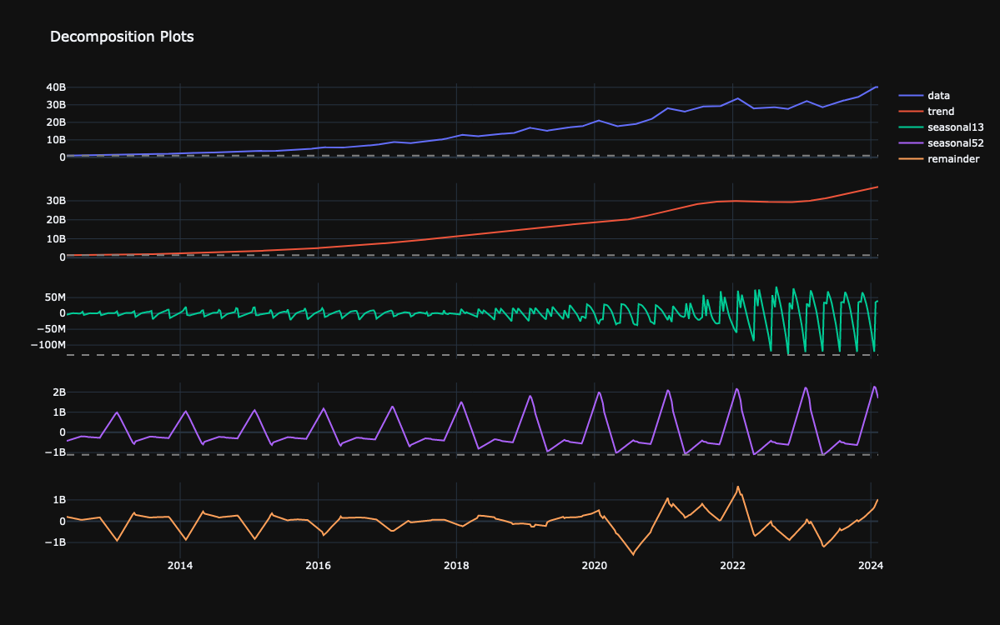

In [57]:
## It is plateuaing, but there is some variability in quarterly seasonaility, so watch out.
import numpy as np
from statsforecast.models import MSTL

# generate serie
seasonal_periods = [13, 52]

df_accounting

model = MSTL(season_length=seasonal_periods).fit(df_accounting.query("ticker == 'META'").reset_index().set_index("date")["total_revenue"])


import plotly.graph_objs as go
from plotly.subplots import make_subplots
import pandas as pd

def create_line_subplots(df, height_per_subplot=150):
    """
    Create line subplots for each column in a pandas DataFrame with the index as x-axis.
    Add horizontal lines to distinguish different subplots.

    :param df: pandas DataFrame containing the data, with date as index.
    :param height_per_subplot: Height in pixels for each subplot.
    :return: Plotly figure object.
    """

    num_plots = len(df.columns)
    total_height = num_plots * height_per_subplot

    fig = make_subplots(rows=num_plots, cols=1, shared_xaxes=True, vertical_spacing=0.05)

    for i, column in enumerate(df.columns, start=1):
        fig.add_trace(go.Scatter(x=df.index, y=df[column], mode='lines', name=column), row=i, col=1)
        
        # Add horizontal lines at the top and bottom of each subplot
        if i < num_plots:  # Add line at the bottom of each subplot except the last one
            fig.add_hline(y=df[column].min(), row=i, col=1, line_dash="dash", line_color="grey")

    fig.update_layout(height=total_height, title_text="Decomposition Plots")

    return fig


# Example usage
# df = your_dataframe  # DataFrame with date as index
plot_fig = create_line_subplots(model.model_)
plot_fig.show()


In [13]:
!pip install esig -v

Using pip 24.0 from /Users/dereksnow/Sovai/GitHub/SovAI/.venv/lib/python3.11/site-packages/pip (python 3.11)
  Using cached esig-0.9.8.3.tar.gz (154 kB)
  Running command pip subprocess to install build dependencies
    Using cached setuptools-69.1.1-py3-none-any.whl.metadata (6.2 kB)
    Using cached wheel-0.42.0-py3-none-any.whl.metadata (2.2 kB)
    Using cached scikit_build-0.17.6-py3-none-any.whl.metadata (14 kB)
    Using cached cmake-3.28.3-py2.py3-none-macosx_10_10_universal2.macosx_10_10_x86_64.macosx_11_0_arm64.macosx_11_0_universal2.whl.metadata (6.3 kB)
    Using cached ninja-1.11.1.1-py2.py3-none-macosx_10_9_universal2.macosx_10_9_x86_64.macosx_11_0_arm64.macosx_11_0_universal2.whl.metadata (5.3 kB)
    Using cached oldest_supported_numpy-2023.12.21-py3-none-any.whl.metadata (9.8 kB)
    Using cached distro-1.9.0-py3-none-any.whl.metadata (6.8 kB)
    Using cached packaging-23.2-py3-none-any.whl.metadata (3.2 kB)
    Using cached numpy-1.23.2-cp311-cp311-macosx_11_0_arm64.

In [11]:
!pip install git+https://github.com/datasciencecampus/SigNow_ONS_Turing

  Cloning https://github.com/datasciencecampus/SigNow_ONS_Turing to /private/var/folders/tj/2qbc2n2x1234_l7b3z5y06740000gn/T/pip-req-build-bs70l1cw
  Running command git clone --filter=blob:none --quiet https://github.com/datasciencecampus/SigNow_ONS_Turing /private/var/folders/tj/2qbc2n2x1234_l7b3z5y06740000gn/T/pip-req-build-bs70l1cw
  Resolved https://github.com/datasciencecampus/SigNow_ONS_Turing to commit 9a38fc0dcf8c177fb1819bd206387e5d05a51c2b
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached esig-0.9.8.3.tar.gz (154 kB)
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for signow: filename=signow-1.0.0-py3-none-any.whl size=26269 sha256=1b8efa5e2d666a35049099a94d2a6bc4aa6f732e47e6edad930cb839d0902e4c
  Stored in directory: /private/var/fo

In [5]:
!pip install iisignature

  Using cached iisignature-0.24.tar.gz (1.3 MB)
  Installing build dependencies ... done
  Getting requirements to build wheel ... error
  error: subprocess-exited-with-error
  
  × Getting requirements to build wheel did not run successfully.
  │ exit code: 1
  ╰─> [20 lines of output]
      Traceback (most recent call last):
        File "/Users/dereksnow/Sovai/GitHub/SovAI/.venv/lib/python3.11/site-packages/pip/_vendor/pyproject_hooks/_in_process/_in_process.py", line 353, in <module>
          main()
        File "/Users/dereksnow/Sovai/GitHub/SovAI/.venv/lib/python3.11/site-packages/pip/_vendor/pyproject_hooks/_in_process/_in_process.py", line 335, in main
          json_out['return_val'] = hook(**hook_input['kwargs'])
                                   ^^^^^^^^^^^^^^^^^^^^^^^^^^^^
        File "/Users/dereksnow/Sovai/GitHub/SovAI/.venv/lib/python3.11/site-packages/pip/_vendor/pyproject_hooks/_in_process/_in_process.py", line 118, in get_requires_for_build_wheel
          return h

In [34]:
import pandas as pd
import iisignature

# Assuming df_accounting is your pandas DataFrame with multi-index ('Ticker', 'Date')

# Function to compute path signatures for each ticker
def compute_signatures(df, sig_depth):
    signatures = []
    tickers = []

    for ticker, group in df.groupby(level='Ticker'):
        # Dropping the 'Ticker' level and sorting by 'Date'
        group = group.droplevel('Ticker').sort_index()
        # Store ticker
        tickers.append(ticker)
        # Compute signature for this group
        path = group.values
        signature = iisignature.sig(path, sig_depth)
        signatures.append(signature)

    # Create a DataFrame with signatures
    signature_df = pd.DataFrame(signatures, columns=[f'Sig_{i+1}' for i in range(len(signatures[0]))])
    signature_df['Ticker'] = tickers
    return signature_df

# Set the signature depth
sig_depth = 2  # You can adjust this based on your needs

# Compute the signatures
signature_features_df = compute_signatures(df_accounting, sig_depth)

# Now, signature_features_df contains the path signatures for each ticker


ModuleNotFoundError: No module named 'iisignature'

In [31]:
df_enhanced.tail()

cash_short_term  operating_working_capital  \
ticker date                                                     
TSLA   2024-01-12     2.866300e+10              -5.834571e+09   
       2024-01-19     2.887850e+10              -5.843786e+09   
       2024-01-26     2.909400e+10              -5.853000e+09   
       2024-02-02     2.909400e+10              -5.853000e+09   
       2024-02-09     2.909400e+10              -5.853000e+09   

                   total_nonoperating_assets  total_operating_assets  \
ticker date                                                            
TSLA   2024-01-12               3.207343e+10            5.237071e+10   
       2024-01-19               3.239571e+10            5.280536e+10   
       2024-01-26               3.271800e+10            5.324000e+10   
       2024-02-02               3.271800e+10            5.324000e+10   
       2024-02-09               3.271800e+10            5.324000e+10   

                   accounts_receivable  cash_equiv_usd  cash_equivalents  \
ticker date                                                                
TSLA   2024-01-12         3.366857e+09    1.633143e+10      1.633143e+10   
       2024-01-19         3.437428e+09    1.636471e+10      1.636471e+10   
       2024-01-26         3.508000e+09    1.639800e+10      1.639800e+10   
       2024-02-02         3.508000e+09    1.639800e+10      1.639800e+10   
       2024-02-09         3.508000e+09    1.639800e+10      1.639800e+10   

                   current_assets  current_investments  intangible_assets  \
ticker date                                                                 
TSLA   2024-01-12    4.896029e+10         1.233157e+10        432428576.0   
       2024-01-19    4.928814e+10         1.251379e+10        431714272.0   
       2024-01-26    4.961600e+10         1.269600e+10        431000000.0   
       2024-02-02    4.961600e+10         1.269600e+10        431000000.0   
       2024-02-09    4.961600e+10         1.269600e+10        431000000.0   

                   inventory_amount  non_current_assets  \
ticker date                                               
TSLA   2024-01-12      1.363957e+10        5.584672e+10   
       2024-01-19      1.363279e+10        5.642436e+10   
       2024-01-26      1.362600e+10        5.700200e+10   
       2024-02-02      1.362600e+10        5.700200e+10   
       2024-02-09      1.362600e+10        5.700200e+10   

                   non_current_investments  property_plant_equipment_net  \
ticker date                                                                
TSLA   2024-01-12              184000000.0                  4.479014e+10   
       2024-01-19              184000000.0                  4.495657e+10   
       2024-01-26              184000000.0                  4.512300e+10   
       2024-02-02              184000000.0                  4.512300e+10   
       2024-02-09              184000000.0                  4.512300e+10   

                     tax_assets  total_assets  total_investments  \
ticker date                                                        
TSLA   2024-01-12  5.771143e+09  1.048070e+11       1.251557e+10   
       2024-01-19  6.252071e+09  1.057125e+11       1.269779e+10   
       2024-01-26  6.733000e+09  1.066180e+11       1.288000e+10   
       2024-02-02  6.733000e+09  1.066180e+11       1.288000e+10   
       2024-02-09  6.733000e+09  1.066180e+11       1.288000e+10   

                   accum_other_comp_income  adjusted_parent_equity  \
ticker date                                                          
TSLA   2024-01-12             -221428576.0            6.709543e+10   
       2024-01-19             -182214288.0            6.823121e+10   
       2024-01-26             -143000000.0            6.936700e+10   
       2024-02-02             -143000000.0            6.936700e+10   
       2024-02-09             -143000000.0            6.936700e+10   

                   book_equity_value    equity_usd  retained_earnings 

In [4]:
df_accounting.head()

cash_short_term  operating_working_capital  \
ticker date                                                     
A      1999-11-12              0.0               1.789000e+09   
       1999-11-19              0.0               1.795800e+09   
       1999-11-26              0.0               1.802600e+09   
       1999-12-03              0.0               1.809400e+09   
       1999-12-10              0.0               1.816200e+09   

                   total_nonoperating_assets  total_operating_assets  \
ticker date                                                            
A      1999-11-12               1.431000e+09            4.687000e+09   
       1999-11-19               1.440400e+09            4.724600e+09   
       1999-11-26               1.449800e+09            4.762200e+09   
       1999-12-03               1.459200e+09            4.799800e+09   
       1999-12-10               1.468600e+09            4.837400e+09   

                   accounts_receivable  cash_equiv_usd  cash_equivalents  \
ticker date                                                                
A      1999-11-12         1.297000e+09             0.0               0.0   
       1999-11-19         1.330800e+09             0.0               0.0   
       1999-11-26         1.364600e+09             0.0               0.0   
       1999-12-03         1.398400e+09             0.0               0.0   
       1999-12-10         1.432200e+09             0.0               0.0   

                   current_assets  current_investments  intangible_assets  \
ticker date                                                                 
A      1999-11-12    3.256000e+09                  0.0                0.0   
       1999-11-19    3.284200e+09                  0.0                0.0   
       1999-11-26    3.312400e+09                  0.0                0.0   
       1999-12-03    3.340600e+09                  0.0                0.0   
       1999-12-10    3.368800e+09                  0.0                0.0   

                   inventory_amount  non_current_assets  \
ticker date                                               
A      1999-11-12      1.597000e+09        1.794000e+09   
       1999-11-19      1.587200e+09        1.805200e+09   
       1999-11-26      1.577400e+09        1.816400e+09   
       1999-12-03      1.567600e+09        1.827600e+09   
       1999-12-10      1.557800e+09        1.838800e+09   

                   non_current_investments  property_plant_equipment_net  \
ticker date                                                                
A      1999-11-12                      0.0                  1.378000e+09   
       1999-11-19                      0.0                  1.378900e+09   
       1999-11-26                      0.0                  1.379800e+09   
       1999-12-03                      0.0                  1.380700e+09   
       1999-12-10                      0.0                  1.381600e+09   

                   tax_assets  total_assets  total_investments  \
ticker date                                                      
A      1999-11-12         0.0  5.050000e+09                0.0   
       1999-11-19         0.0  5.089400e+09                0.0   
       1999-11-26         0.0  5.128800e+09                0.0   
       1999-12-03         0.0  5.168200e+09                0.0   
       1999-12-10         0.0  5.207600e+09                0.0   

                   accum_other_comp_income  adjusted_parent_equity  \
ticker date                                                          
A      1999-11-12                      0.0            3.220000e+09   
       1999-11-19                      0.0            3.236200e+09   
       1999-11-26                      0.0            3.252400e+09   
       1999-12-03                      0.0            3.268600e+09   
       1999-12-10                      0.0            3.284800e+09   

                   book_equity_value    equity_usd  retained_earnings  \
ticker date

In [21]:
df_accounting.fractional_difference().select_features(0.80).feature_importance().sum().sort_values(ascending=False)

/Users/dereksnow/Sovai/GitHub/SovAI/sovai/extensions/pandas_extensions.py:188: FutureWarning:

Not prepending group keys to the result index of transform-like apply. In the future, the group keys will be included in the index, regardless of whether the applied function returns a like-indexed object.
To preserve the previous behavior, use

	>>> .groupby(..., group_keys=False)

To adopt the future behavior and silence this warning, use 

	>>> .groupby(..., group_keys=True)



ebit                               5210.636230
cash_short_term                    4895.095703
equity_usd                         4393.904785
operating_cash_flow                3009.286377
cash_operating_profit              2902.539795
comprehensive_net_income           2833.792236
net_cash_flow_financing            2613.719238
total_assets                       2267.156982
selling_general_admin_expenses     2225.377686
revenue_usd                        2117.227295
net_cash_acquisitions_disposals    1956.989258
inventory_amount                   1944.946045
tangible_assets                    1847.902100
net_cash_flow_investing            1480.264160
current_liabilities                1469.250244
bank_deposits                      1313.650146
operating_accruals                 1245.523926
research_development_expenses      1164.266968
net_income_discontinued_ops        1105.188721
debt_usd                           1026.035156
net_cash_flow_dividends             777.207886
total_liabili

/breakout/median
Requesting URL: https://fastapi-sovai-y7o724zyfq-uc.a.run.app/breakout/median with params: None
Response Status: 200
Response Content-Type: application/json
tickers is None
None
tickers is: 
All ticker Initialized
https://s3.wasabisys.com/sovai-breakout-price/frames/df_test_summary_median.park?AWSAccessKeyId=KI07G4DK9XP5EC0NH1VU&Signature=bToO98e%2F53DVstMHvHhO3NVUEMo%3D&Expires=1709064601  (download link)
File is up-to-date, no need to download.
/breakout/median
Requesting URL: https://fastapi-sovai-y7o724zyfq-uc.a.run.app/breakout/median with params: None
Response Status: 200
Response Content-Type: application/json
tickers is None
None
tickers is: 
All ticker Initialized
https://s3.wasabisys.com/sovai-breakout-price/frames/df_test_summary_median.park?AWSAccessKeyId=KI07G4DK9XP5EC0NH1VU&Signature=bToO98e%2F53DVstMHvHhO3NVUEMo%3D&Expires=1709064601  (download link)
File is up-to-date, no need to download.
/breakout/median
Requesting URL: https://fastapi-sovai-y7o724zyf

In [20]:
# df_frac_diff.query("ticker=='MSFT'").reset_index().set_index("date")[["total_revenue"]].plot()

In [150]:
df_independant = df_accounting[df_accounting.select_features(0.80).feature_importance().sum().sort_values(ascending=False).index.to_list()].orthogonalize_features()

In [154]:
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Assuming df_accounting and df_independant are already defined

# Prepare the data
# Prepare the data
X = df_independant.drop("working_capital", axis=1, errors='ignore')  # Predictors

y = df_accounting["working_capital"]  # Target variable

# Fit the linear regression model
model = LinearRegression()
model.fit(X, y)

# Print the coefficients
print("Coefficients:")
for feature, coef in zip(X.columns, model.coef_):
    print(f"{feature}: {coef}")

# Predict and calculate residuals
y_pred = model.predict(X)
residuals = y - y_pred

# Measure the size of residuals
mse = mean_squared_error(y, y_pred)
print(f"Mean Squared Error: {mse}")

# You can also analyze the residuals in more detail, for example:
print("Residuals summary:")
print(residuals.describe())


Coefficients:
adjusted_parent_equity: 32.24862910163902
non_current_debt: -6.976190401582406
operating_income: 135.5728851491908
revenue_usd: -33.637081100375084
cash_equivalents: 22.529557338549644
retained_earnings: 1.5908098495460161
total_liabilities: -5.008213633914761
tax_liabilities: 14.052838039070009
free_cash_flow: -10.55674559106307
net_cash_flow_fx: -18.16283387379029
total_operating_assets: -5.932212313869621
Mean Squared Error: 4.0965911400581263e+18
Residuals summary:
count    5.479000e+03
mean     2.410660e-05
std      2.024188e+09
min     -1.491552e+10
25%     -1.204464e+09
50%     -2.033193e+08
75%      1.271031e+09
max      6.229737e+09
Name: working_capital, dtype: float64
/breakout/median
Requesting URL: https://fastapi-sovai-y7o724zyfq-uc.a.run.app/breakout/median with params: None
Response Status: 200
Response Content-Type: application/json
tickers is None
None
tickers is: 
All ticker Initialized
https://s3.wasabisys.com/sovai-breakout-price/frames/df_test_summar

In [155]:
df_accounting["working_capital_preds"]= y_pred

In [156]:
df_accounting[["working_capital_preds","working_capital"]]

working_capital_preds  working_capital
ticker date                                              
A      2008-04-04           3.296875e+09     2.297923e+09
       2008-04-11           3.307900e+09     2.278308e+09
       2008-04-18           3.318925e+09     2.258692e+09
       2008-04-25           3.329949e+09     2.239077e+09
       2008-05-02           3.340974e+09     2.219462e+09
...                                  ...              ...
TSLA   2024-01-12           1.810275e+10     2.051343e+10
       2024-01-19           1.844630e+10     2.069071e+10
       2024-01-26           1.878985e+10     2.086800e+10
       2024-02-02           1.878985e+10     2.086800e+10
       2024-02-09           1.878985e+10     2.086800e+10

[5479 rows x 2 columns]

In [152]:
df_independant[["retained_earnings","tax_liabilities"]].head()

retained_earnings  tax_liabilities
ticker date                                          
A      2008-04-04       1.611896e+10     2.146660e+09
       2008-04-11       1.611958e+10     2.146384e+09
       2008-04-18       1.612020e+10     2.146107e+09
       2008-04-25       1.612082e+10     2.145831e+09
       2008-05-02       1.612144e+10     2.145554e+09

In [95]:
df_accounting.select_features(0.80).feature_importance().sum().sort_values(ascending=False)

retained_earnings         4441.710938
tax_liabilities           4330.373047
revenue_usd               3753.781250
cash_equivalents          3422.397949
non_current_debt          3287.654785
net_cash_flow_fx          2804.214355
operating_income          2741.605957
free_cash_flow            1896.300537
total_liabilities         1827.065796
adjusted_parent_equity    1771.631348
total_operating_assets     981.479614
dtype: float32

In [107]:
df_accounting.select_features(0.85).feature_importance().sum().sort_values(ascending=False)

current_investments           3675.244629
total_operating_net_income    3651.322754
cash_short_term               3438.181641
preferred_dividends           2664.523193
operating_accruals            2170.972900
non_current_investments       2121.062256
intangible_assets             2049.669678
ebitda                        1825.533447
deferred_revenue              1481.359985
ebit                          1003.942688
equity_usd                     995.182434
retained_earnings              784.819946
debt_usd                       684.629578
total_liabilities              649.272339
net_cash_flow                  147.911362
dtype: float32

/breakout/median
Requesting URL: https://fastapi-sovai-y7o724zyfq-uc.a.run.app/breakout/median with params: None
Response Status: 200
Response Content-Type: application/json
tickers is None
None
tickers is: 
All ticker Initialized
https://s3.wasabisys.com/sovai-breakout-price/frames/df_test_summary_median.park?AWSAccessKeyId=KI07G4DK9XP5EC0NH1VU&Signature=mffU9kcdMkISyx%2FiG%2BGdGJ6rMpI%3D&Expires=1708974058  (download link)
File is up-to-date, no need to download.
/breakout/median
Requesting URL: https://fastapi-sovai-y7o724zyfq-uc.a.run.app/breakout/median with params: None
Response Status: 200
Response Content-Type: application/json
tickers is None
None
tickers is: 
All ticker Initialized
https://s3.wasabisys.com/sovai-breakout-price/frames/df_test_summary_median.park?AWSAccessKeyId=KI07G4DK9XP5EC0NH1VU&Signature=XqHYeYRTelcdgNWlibGRrZ73o2A%3D&Expires=1708974082  (download link)
File is up-to-date, no need to download.
/breakout/median
Requesting URL: https://fastapi-sovai-y7o724zyf

In [99]:
df_accounting.select_features(0.90).feature_importance().sum().sort_values(ascending=False)

deferred_revenue               2866.042480
current_assets                 2821.840576
bank_deposits                  2075.986816
ebitda                         1899.224121
revenue_usd                    1876.584961
tax_assets                     1850.477295
operating_accruals             1505.621826
accum_other_comp_income        1299.957520
cash_short_term                1070.767578
non_current_liabilities        1067.521240
net_cash_flow_financing        1029.273682
total_investments              1015.421265
net_cash_flow_business          965.109497
ebit                            890.484619
non_current_investments         825.503174
gross_profit                    766.286865
net_cash_flow_common            626.862427
net_cash_flow_debt              532.737549
current_liabilities             532.464355
operating_cash_flow             530.547485
non_current_assets              458.126312
stock_based_compensation        447.297607
retained_earnings               312.861908
depreciatio

current_investments        7723.073730
net_cash_flow_fx           7539.269043
total_operating_assets     7261.035645
net_income_common_stock    4801.521484
tax_liabilities            4477.333984
dtype: float32

In [75]:
df_accounting.feature_importance()

cash_short_term  operating_working_capital  \
ticker date                                                     
A      2008-04-04         0.401912                   0.038924   
       2008-04-11         0.426825                   0.042362   
       2008-04-18         0.436048                   0.030993   
       2008-04-25         0.415506                   0.041248   
       2008-05-02         0.438769                   0.037661   
...                            ...                        ...   
TSLA   2024-01-12         0.435820                   0.036439   
       2024-01-19         0.424075                   0.036351   
       2024-01-26         0.404554                   0.032042   
       2024-02-02         0.437459                   0.038512   
       2024-02-09         0.428488                   0.029662   

                   total_nonoperating_assets  total_operating_assets  \
ticker date                                                            
A      2008-04-04                   0.100994                0.055105   
       2008-04-11                   0.125835                0.146838   
       2008-04-18                   0.125848                0.148962   
       2008-04-25                   0.126512                0.146912   
       2008-05-02                   0.126120                0.147117   
...                                      ...                     ...   
TSLA   2024-01-12                   0.126120                0.063935   
       2024-01-19                   0.126860                0.063986   
       2024-01-26                   0.124743                0.057974   
       2024-02-02                   0.126048                0.062995   
       2024-02-09                   0.126120                0.064088   

                   accounts_receivable  cash_equiv_usd  cash_equivalents  \
ticker date                                                                
A      2008-04-04             0.088919        0.022939               0.0   
       2008-04-11             0.121513        0.028454               0.0   
       2008-04-18             0.122056        0.028456               0.0   
       2008-04-25             0.090059        0.030105               0.0   
       2008-05-02             0.106145        0.028183               0.0   
...                                ...             ...               ...   
TSLA   2024-01-12             0.084568        0.028183               0.0   
       2024-01-19             0.083141        0.028182               0.0   
       2024-01-26             0.105964        0.021771               0.0   
       2024-02-02             0.072795        0.026739               0.0   
       2024-02-09             0.091401        0.024358               0.0   

                   current_assets  current_investments  intangible_assets  \
ticker date                                                                 
A      2008-04-04        0.250633             0.182332           0.462608   
       2008-04-11        0.321317             0.286335           0.540684   
       2008-04-18        0.315297             0.150169           0.538447   
       2008-04-25        0.241480             0.299972           0.456087   
       2008-05-02        0.322571             0.291927           0.496751   
...                           ...                  ...                ...   
TSLA   2024-01-12        0.347299             0.215995           0.498657   
       2024-01-19        0.358661             0.222293           0.501184   
       2024-01-26        0.226613             0.163966           0.477776   
       2024-02-02        0.445182             0.262093           0.460883   
       2024-02-09        0.378871             0.166602           0.452619   

                   inventory_amount  non_current_assets  \
ticker date                                               
A      2008-04-04          0.317156            0.035694   
       2008-04-11          0.259665            0.035754   
       20

In [72]:
df_accounting.feature_importance()

cash_short_term  operating_working_capital  \
ticker date                                                     
A      2008-04-04         0.241266                   0.183551   
       2008-04-11         0.302017                   0.177766   
       2008-04-18         0.320732                   0.178445   
       2008-04-25         0.273695                   0.181998   
       2008-05-02         0.303358                   0.181998   
...                            ...                        ...   
TSLA   2024-01-12         0.304769                   0.183552   
       2024-01-19         0.285565                   0.177842   
       2024-01-26         0.279680                   0.257363   
       2024-02-02         0.349620                   0.197688   
       2024-02-09         0.356743                   0.182842   

                   total_nonoperating_assets  total_operating_assets  \
ticker date                                                            
A      2008-04-04                   0.040343                0.020763   
       2008-04-11                   0.040838                0.012478   
       2008-04-18                   0.040857                0.012478   
       2008-04-25                   0.040912                0.012629   
       2008-05-02                   0.041173                0.012478   
...                                      ...                     ...   
TSLA   2024-01-12                   0.041177                0.010983   
       2024-01-19                   0.040953                0.010983   
       2024-01-26                   0.035909                0.017967   
       2024-02-02                   0.040544                0.010983   
       2024-02-09                   0.041173                0.010939   

                   accounts_receivable  cash_equiv_usd  cash_equivalents  \
ticker date                                                                
A      2008-04-04             0.128766        0.035937               0.0   
       2008-04-11             0.134129        0.041231               0.0   
       2008-04-18             0.134678        0.041231               0.0   
       2008-04-25             0.130132        0.033455               0.0   
       2008-05-02             0.134120        0.041231               0.0   
...                                ...             ...               ...   
TSLA   2024-01-12             0.117689        0.041231               0.0   
       2024-01-19             0.120768        0.043120               0.0   
       2024-01-26             0.126433        0.031257               0.0   
       2024-02-02             0.111507        0.041323               0.0   
       2024-02-09             0.124650        0.040364               0.0   

                   current_assets  current_investments  intangible_assets  \
ticker date                                                                 
A      2008-04-04        0.319026             0.223297           0.370724   
       2008-04-11        0.364370             0.208526           0.465622   
       2008-04-18        0.348707             0.178089           0.458264   
       2008-04-25        0.290216             0.255162           0.367822   
       2008-05-02        0.365652             0.243296           0.430714   
...                           ...                  ...                ...   
TSLA   2024-01-12        0.386418             0.243296           0.432175   
       2024-01-19        0.378397             0.243250           0.432175   
       2024-01-26        0.302499             0.183360           0.359250   
       2024-02-02        0.428975             0.212291           0.379423   
       2024-02-09        0.440479             0.197935           0.367136   

                   inventory_amount  non_current_assets  \
ticker date                                               
A      2008-04-04          0.251236            0.078777   
       2008-04-11          0.262714            0.160226   
       20

In [62]:
average_shap_values.head()

cash_short_term  operating_working_capital  \
ticker date                                                     
A      2008-04-04         0.248555                   0.071583   
       2008-04-11         0.203456                   0.080142   
       2008-04-18         0.217285                   0.090266   
       2008-04-25         0.215801                   0.095587   
       2008-05-02         0.196001                   0.088490   

                   total_nonoperating_assets  total_operating_assets  \
ticker date                                                            
A      2008-04-04                   0.052577                0.052919   
       2008-04-11                   0.066338                0.039080   
       2008-04-18                   0.066666                0.034310   
       2008-04-25                   0.067422                0.040271   
       2008-05-02                   0.067624                0.040803   

                   accounts_receivable  cash_equiv_usd  cash_equivalents  \
ticker date                                                                
A      2008-04-04             0.110136        0.040142               0.0   
       2008-04-11             0.105754        0.035556               0.0   
       2008-04-18             0.104930        0.036184               0.0   
       2008-04-25             0.112417        0.038067               0.0   
       2008-05-02             0.109870        0.036437               0.0   

                   current_assets  current_investments  intangible_assets  \
ticker date                                                                 
A      2008-04-04        0.223128             0.055263           0.338474   
       2008-04-11        0.202121             0.069976           0.309952   
       2008-04-18        0.206258             0.055025           0.311294   
       2008-04-25        0.209808             0.055087           0.308004   
       2008-05-02        0.259592             0.106689           0.306865   

                   inventory_amount  non_current_assets  \
ticker date                                               
A      2008-04-04          0.610566            0.069708   
       2008-04-11          0.530324            0.080775   
       2008-04-18          0.540611            0.215975   
       2008-04-25          0.558582            0.072776   
       2008-05-02          0.521682            0.088682   

                   non_current_investments  property_plant_equipment_net  \
ticker date                                                                
A      2008-04-04                 0.023748                      0.135949   
       2008-04-11                 0.028181                      0.216193   
       2008-04-18                 0.028549                      0.219732   
       2008-04-25                 0.056261                      0.212939   
       2008-05-02                 0.029784                      0.212861   

                   tax_assets  total_assets  total_investments  \
ticker date                                                      
A      2008-04-04    0.320013      0.063599           0.147575   
       2008-04-11    0.336200      0.060187           0.141755   
       2008-04-18    0.328280      0.066699           0.143980   
       2008-04-25    0.362716      0.074158           0.144540   
       2008-05-02    0.329601      0.055520           0.143816   

                   accum_other_comp_income  adjusted_parent_equity  \
ticker date                                                          
A      2008-04-04                 0.104585                0.042187   
       2008-04-11                 0.101529                0.046284   
       2008-04-18                 0.106321                0.043001   
       2008-04-25                 0.093854                0.044925   
       2008-05-02                 0.150584                0.048591   

                   book_equity_value  equity_usd  retained_earnings  \
ticker date  

/breakout/median
Requesting URL: https://fastapi-sovai-y7o724zyfq-uc.a.run.app/breakout/median with params: None
Response Status: 200
Response Content-Type: application/json
tickers is None
None
tickers is: 
All ticker Initialized
https://s3.wasabisys.com/sovai-breakout-price/frames/df_test_summary_median.park?AWSAccessKeyId=KI07G4DK9XP5EC0NH1VU&Signature=dOendFcDMoH7kU1sH%2Fm2JydxBeo%3D&Expires=1708969339  (download link)
File is up-to-date, no need to download.
/breakout/median
Requesting URL: https://fastapi-sovai-y7o724zyfq-uc.a.run.app/breakout/median with params: None
Response Status: 200
Response Content-Type: application/json
tickers is None
None
tickers is: 
All ticker Initialized
https://s3.wasabisys.com/sovai-breakout-price/frames/df_test_summary_median.park?AWSAccessKeyId=KI07G4DK9XP5EC0NH1VU&Signature=z2UF3JmpE0FEmO9LePwkC%2Fxw%2B6s%3D&Expires=1708969356  (download link)
File is up-to-date, no need to download.
/breakout/median
Requesting URL: https://fastapi-sovai-y7o724z

In [59]:
average_shap_values["importance"] = average_shap_values.mean(axis=1)

In [40]:
average_shap_values.sum().sort_values(ascending=False).head(30)

inventory_amount                     2587.007324
current_assets                       2203.759521
cash_short_term                      1683.978760
intangible_assets                    1519.975098
tax_assets                           1430.209717
dividends_total                      1421.052979
accounts_payable                     1379.758911
property_plant_equipment_net          798.147461
cost_of_revenue                       694.858337
depreciation_amortization             664.207764
working_capital                       607.641968
tangible_assets                       598.263733
selling_general_admin_expenses        525.225342
tax_liabilities                       500.200470
operating_working_capital             490.879456
accounts_receivable                   425.582672
accum_other_comp_income               416.640869
total_investments                     403.464111
deferred_revenue                      384.775940
total_nonoperating_assets             381.771973
cash_operating_profi

In [49]:
df_accounting.select_features(0.80)

current_assets  net_cash_flow_fx  book_equity_value  \
ticker date                                                              
A      2008-04-04       -0.612625          0.266176          -0.491345   
       2008-04-11       -0.612448          0.263227          -0.491491   
       2008-04-18       -0.612271          0.260277          -0.491637   
       2008-04-25       -0.612095          0.257328          -0.491784   
       2008-05-02       -0.611918          0.254378          -0.491930   
...                           ...               ...                ...   
TSLA   2024-01-12        0.263126          1.173817           0.302742   
       2024-01-19        0.269675          1.340893           0.312702   
       2024-01-26        0.276223          1.507968           0.322663   
       2024-02-02        0.276223          1.507968           0.322663   
       2024-02-09        0.276223          1.507968           0.322663   

                   total_investments  free_cash_flow  
ticker date                                           
A      2008-04-04          -0.543331       -0.533695  
       2008-04-11          -0.542399       -0.528117  
       2008-04-18          -0.541468       -0.522540  
       2008-04-25          -0.540536       -0.516962  
       2008-05-02          -0.539605       -0.511385  
...                              ...             ...  
TSLA   2024-01-12           0.584413       -0.107072  
       2024-01-19           0.601129       -0.086389  
       2024-01-26           0.617845       -0.065706  
       2024-02-02           0.617845       -0.065706  
       2024-02-09           0.617845       -0.065706  

[5479 rows x 5 columns]

In [ ]:
inventory_amount                     2587.007324
current_assets                       2203.759521
cash_short_term                      1683.978760
intangible_assets                    1519.975098
tax_assets                           1430.209717
dividends_total                      1421.052979
accounts_payable                     1379.758911
property_plant_equipment_net          798.147461
cost_of_revenue                       694.858337
depreciation_amortization             664.207764

In [43]:
all_runs.tail(20)

,Feature,Mean_Score,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99
61,working_capital,0.842134,0.809369,0.841079,0.866384,0.838578,0.787073,0.862410,0.828881,0.883684,0.866384,0.841483,0.866427,0.866384,0.882764,0.883684,0.882165,0.784544,0.836744,0.809369,0.842457,0.845858,0.777314,0.838578,0.866427,0.788855,0.823427,0.860925,0.847895,0.798549,0.866384,0.866427,0.866384,0.792784,0.866427,0.788657,0.850808,0.882764,0.883684,0.802237,0.841079,0.866384,0.857893,0.862925,0.882165,0.789598,0.787073,0.801695,0.847329,0.805280,0.797260,0.858581,0.882764,0.866384,0.804299,0.792784,0.882764,0.857893,0.805500,0.845858,0.818871,0.882764,0.794192,0.882764,0.857893,0.836744,0.809369,0.882764,0.866384,0.866384,0.866384,0.866384,0.859357,0.862925,0.813377,0.801695,0.857893,0.857914,0.787073,0.858712,0.812530,0.866427,0.866427,0.866384,0.866384,0.845858,0.845858,0.843484,0.866427,0.847329,0.883684,0.857026,0.801695,0.791703,0.891145,0.845858,0.824744,0.788550,0.799896,0.882165,0.866384,0.793827
62,net_cash_flow_business,0.839747,0.808183,0.835214,0.868986,0.853917,0.889979,0.881659,0.822636,0.831694,0.822636,0.801491,0.819933,0.868986,0.827095,0.935248,0.819933,0.802195,0.842723,0.808183,0.800822,0.835214,0.820660,0.872500,0.823353,0.838478,0.825459,0.903573,0.889979,0.837428,0.840929,0.819933,0.806574,0.819160,0.818220,0.847786,0.826361,0.819600,0.932946,0.843347,0.824564,0.841328,0.808183,0.858688,0.835323,0.824612,0.887800,0.890573,0.837911,0.808183,0.847351,0.910424,0.827095,0.852700,0.835214,0.819160,0.822636,0.804469,0.840473,0.835214,0.833718,0.822636,0.848644,0.819600,0.808183,0.827251,0.808183,0.806853,0.819600,0.822636,0.822693,0.822636,0.827949,0.893829,0.808183,0.858688,0.826033,0.824715,0.872121,0.842825,0.837911,0.819933,0.819933,0.817917,0.806574,0.835214,0.835214,0.899504,0.825536,0.847420,0.935248,0.842723,0.858688,0.840646,0.899504,0.835214,0.796734,0.857472,0.887800,0.817557,0.822693,0.843347
63,accum_other_comp_income,0.838721,0.953045,0.924248,0.787378,0.752343,0.953045,0.707631,0.953045,0.772189,0.787378,0.953045,0.782886,0.787378,0.775036,0.772189,0.771635,0.821109,0.682887,0.953045,0.953045,0.953045,0.953045,0.721027,0.782886,0.953045,0.723875,0.713278,0.953045,0.953045,0.787378,0.782886,0.787378,0.953045,0.782886,0.953045,0.953045,0.775036,0.772189,0.953045,0.831263,0.787378,0.804427,0.724310,0.771635,0.953045,0.953045,0.725528,0.953045,0.896032,0.846020,0.916128,0.775036,0.787378,0.953045,0.953045,0.775036,0.804427,0.953045,0.953045,0.718410,0.775036,0.953045,0.775036,0.804427,0.682887,0.953045,0.775036,0.787378,0.787378,0.787378,0.787378,0.798556,0.953045,0.953045,0.724310,0.804427,0.924248,0.953045,0.671142,0.882617,0.782886,0.782886,0.787378,0.787378,0.953045,0.953045,0.679960,0.782886,0.953045,0.772189,0.819765,0.724310,0.953045,0.748689,0.953045,0.953045,0.953045,0.655410,0.771635,0.787378,0.902415
64,operating_accruals,0.832989,0.826356,0.789967,0.874699,0.818604,0.870927,0.848605,0.833752,0.791495,0.871902,0.809066,0.798500,0.874699,0.881033,0.843471,0.798500,0.866780,0.871385,0.826356,0.876757,0.789967,0.863931,0.844235,0.772613,0.800988,0.788229,0.830017,0.870927,0.774620,0.876070,0.798500,0.876757,0.769714,0.771487,0.879521,0.865891,0.882401,0.851937,0.788229,0.797463,0.875179,0.866780,0.848251,0.795930,0.796041,0.877072,0.828361,0.788023,0.830849,0.804873,0.854119,0.881033,0.877475,0.789967,0.769714,0.871902,0.864319,0.788229,0.789967,0.879137,0.871902,0.813822,0.882401,0.866780,0.890733,0.826356,0.876757,0.882401,0.871902,0.805337,0.871902,0.761640,0.861864,0.835042,0.848251,0.775987,0.791659,0.876601,0.804661,0.788023,0.798500,0.798500,0.864624,0.879104,0.789967,0.789967,0.866530,0.795930,0.790390,0.843471,0.871385,0.848251,0.869049,0.866530,0.789967,0.841490,0.812

In [34]:
all_runs.head(20)

,Feature,Mean_Score,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99
0,net_income_discontinued_ops,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,preferred_dividends,0.973208,0.085323,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.083645,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.151852,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
2,net_income_non_controlling_int,0.972300,1.000000,0.065123,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.036869,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.128058,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
3,ebit,0.932932,0.895217,0.964563,0.925023,0.904857,0.907995,0.898971,0.956526,0.962520,0.916426,0.939593,0.904857,0.890535,0.884403,0.910399,0.961963,0.961963,0.949199,0.961963,0.931332,0.929239,0.953139,0.910489,0.961963,0.931370,0.946938,0.961963,0.946938,0.961963,0.916426,0.946938,0.962520,0.916426,0.961963,0.892532,0.953804,0.919152,0.947290,0.946938,0.939056,0.946938,0.961963,0.955533,0.962520,0.910489,0.912788,0.916426,0.903902,0.904255,0.891933,0.926970,0.921433,0.953804,0.904857,0.928473,0.950339,0.925234,0.903768,0.961963,0.961963,0.904732,0.895041,0.916334,0.909899,0.949437,0.956483,0.906056,0.928488,0.946938,0.961963,0.955533,0.912442,0.909899,0.926571,0.931370,0.928542,0.961963,0.953804,0.953804,0.947290,0.905469,0.953804,0.946938,0.946938,0.907995,0.946938,0.904857,0.941393,0.936982,0.961963,0.961963,0.904857,0.928473,0.904857,0.946938,0.909899,0.92854

In [33]:
all_runs.tail(20)

,Feature,Mean_Score,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99
61,dividends_total,0.760841,0.771360,0.781005,0.777617,0.772116,0.728377,0.722987,0.756458,0.777205,0.722597,0.725264,0.770924,0.777770,0.772193,0.766887,0.787536,0.723531,0.771360,0.756237,0.785549,0.782427,0.762921,0.741719,0.779328,0.774649,0.771360,0.781005,0.732718,0.791641,0.746729,0.777770,0.783199,0.741719,0.756237,0.781005,0.766887,0.777617,0.777205,0.771360,0.805575,0.766887,0.790422,0.730510,0.759347,0.794174,0.687244,0.731019,0.751003,0.725455,0.766887,0.780154,0.781005,0.780983,0.766887,0.788861,0.771482,0.703514,0.737021,0.745460,0.750468,0.759742,0.771360,0.762060,0.738834,0.747379,0.740329,0.720283,0.728164,0.755274,0.808748,0.725956,0.789676,0.775072,0.774288,0.779699,0.733935,0.756058,0.766887,0.758272,0.729240,0.791428,0.791507,0.717703,0.803723,0.728377,0.732718,0.728205,0.718116,0.759742,0.795838,0.783773,0.741719,0.766887,0.723531,0.771360,0.777205,0.762487,0.771360,0.793856,0.773085,0.771360
62,operating_working_capital,0.758191,0.734697,0.840663,0.858746,0.738719,0.727377,0.722095,0.686104,0.759235,0.730331,0.696058,0.738719,0.743399,0.789106,0.739090,0.778050,0.864618,0.759235,0.765846,0.917030,0.735840,0.815036,0.731351,0.685274,0.705011,0.775023,0.787753,0.723133,0.752616,0.730331,0.753648,0.754123,0.730331,0.765846,0.815036,0.815521,0.727278,0.702154,0.772649,0.711949,0.781327,0.752307,0.752278,0.754123,0.731351,0.836048,0.730331,0.737466,0.735796,0.815521,0.836048,0.778050,0.836048,0.738719,0.774439,0.765133,0.815036,0.722528,0.864618,0.775790,0.732735,0.723528,0.815036,0.732840,0.698400,0.795830,0.729418,0.735910,0.775023,0.743831,0.754123,0.730474,0.732840,0.720424,0.705011,0.721739,0.736651,0.853989,0.796684,0.702154,0.725092,0.805419,0.728103,0.705958,0.727377,0.723133,0.738719,0.774326,0.797625,0.769745,0.825277,0.738719,0.753805,0.738719,0.783145,0.732840,0.721739,0.727597,0.699227,0.689346,0.864618
63,intangible_assets,0.756097,0.767964,0.747364,0.775313,0.764578,0.770614,0.743553,0.732291,0.731786,0.757866,0.765436,0.764578,0.742094,0.786722,0.766842,0.754706,0.799829,0.737709,0.727727,0.764070,0.747628,0.736935,0.757036,0.752284,0.739844,0.749505,0.747364,0.764749,0.752606,0.757866,0.742094,0.731786,0.757866,0.727727,0.747364,0.779650,0.775313,0.748498,0.730626,0.751561,0.781701,0.746981,0.739960,0.731786,0.757036,0.720159,0.757866,0.763457,0.779173,0.779650,0.749646,0.747364,0.750425,0.764578,0.747491,0.768254,0.766368,0.771807,0.799829,0.733089,0.759436,0.743980,0.728665,0.762216,0.746481,0.728496,0.769205,0.756840,0.749505,0.753508,0.739960,0.752042,0.762216,0.738622,0.746072,0.761348,0.718259,0.790950,0.780761,0.741225,0.773273,0.739457,0.758010,0.804604,0.770614,0.764749,0.764578,0.721081,0.771002,0.752944,0.754948,0.764578,0.733490,0.764578,0.775668,0.762216,0.761348,0.766234,0.768158,0.752548,0.799829
64,capital_expenditures,0.736790,0.708678,0.799042,0.764255,0.707874,0.731215,0.733682,0.738564,0.703214,0.722481,0.705599,0.707874,0.798828,0.808164,0.717844,0.772299,0.754467,0.694799,0.694896,0.739837,0.825289,0.801036,0.711668,0.744259,0.741575,0.689359,0.692048,0.720670,0.703758,0.722481,0.729966,0.724305,0.722481,0.694896,0.801036,0.772561,0.720588,0.703214,0.736651,0.747125,0.725021,0.723518,0.723677,0.719324,0.711668,0.802684,0.722481,0.697508,0.726814,0.772561,0.802684,0.772299,0.802684,0.707874,0.708174,0.689847,0.801036,0.735102,0.754467,0.699142,0.718274,0.721596,0.801036,0.756076,0.723248,0.798739,0.720667,0.803828,0.689359,0.715202,0.707716,0.703384,0.696579,0.765221,0.738140,0.734898,0.700486,0.765349,0.828680,0.721823,0.720207,0.779546,0.718456,0.750056,0.731215,0.720670,0.707874,0.773459,0.718274,0.723169,0.795715,0.707874,0.711091,0.707874,0.712712,0.703214,0.7288

In [22]:
feature_importance_df

,Feature,Score
0,net_income_discontinued_ops,1.000000
1,net_cash_acquisitions_disposals,1.000000
2,net_cash_flow,1.000000
3,gross_profit,0.937534
4,current_liabilities,0.925074
...,...,...
76,total_accruals,0.491330
77,net_cash_flow_fx,0.488246
78,net_income_non_controlling_int,0.432248
79,accum_other_comp_income,0.422566


cash_short_term  preferred_dividends  book_equity_value  \
ticker date                                                                  
A      2008-04-04        -0.563654            -0.145612          -0.491027   
       2008-04-11        -0.563311            -0.145612          -0.491174   
       2008-04-18        -0.562968            -0.145612          -0.491321   
       2008-04-25        -0.562625            -0.145612          -0.491468   
       2008-05-02        -0.562282            -0.145612          -0.491616   
...                            ...                  ...                ...   
TSLA   2023-12-29         0.112338            -0.145612           0.288396   
       2024-01-05         0.118163            -0.145612           0.298424   
       2024-01-12         0.123988            -0.145612           0.308452   
       2024-01-19         0.129813            -0.145612           0.318480   
       2024-01-26         0.135638            -0.145612           0.328508   

                   adjusted_parent_equity  net_cash_flow_fx  
ticker date                                                  
A      2008-04-04               -0.648580          0.294880  
       2008-04-11               -0.648608          0.291957  
       2008-04-18               -0.648637          0.289033  
       2008-04-25               -0.648665          0.286109  
       2008-05-02               -0.648693          0.283186  
...                                   ...               ...  
TSLA   2023-12-29                0.682332          0.863306  
       2024-01-05                0.706849          1.028905  
       2024-01-12                0.731366          1.194505  
       2024-01-19                0.755882          1.360104  
       2024-01-26                0.780399          1.525703  

[5465 rows x 5 columns]

In [24]:
df_accounting.reset_index(drop=False).to_csv("file.csv")

In [16]:
# df_accounting.to_parquet("file.parquet")

In [4]:
df_accounting.head()

cash_short_term  operating_working_capital  \
ticker date                                                     
A      2008-04-04     3.222461e+09                672384640.0   
       2008-04-11     3.235154e+09                659461568.0   
       2008-04-18     3.247846e+09                646538432.0   
       2008-04-25     3.260538e+09                633615360.0   
       2008-05-02     3.273231e+09                620692288.0   

                   total_nonoperating_assets  total_operating_assets  \
ticker date                                                            
A      2008-04-04               1.270231e+09            3.162000e+09   
       2008-04-11               1.278077e+09            3.166000e+09   
       2008-04-18               1.285923e+09            3.170000e+09   
       2008-04-25               1.293769e+09            3.174000e+09   
       2008-05-02               1.301615e+09            3.178000e+09   

                   accounts_receivable  cash_equiv_usd  cash_equivalents  \
ticker date                                                                
A      2008-04-04          751000000.0    3.105077e+09      3.105077e+09   
       2008-04-11          756000000.0    3.128692e+09      3.128692e+09   
       2008-04-18          761000000.0    3.152308e+09      3.152308e+09   
       2008-04-25          766000000.0    3.175923e+09      3.175923e+09   
       2008-05-02          771000000.0    3.199538e+09      3.199538e+09   

                   current_assets  current_investments  intangible_assets  \
ticker date                                                                 
A      2008-04-04    5.114231e+09          117384616.0        851000000.0   
       2008-04-11    5.123077e+09          106461536.0        853000000.0   
       2008-04-18    5.131923e+09           95538464.0        855000000.0   
       2008-04-25    5.140769e+09           84615384.0        857000000.0   
       2008-05-02    5.149616e+09           73692304.0        859000000.0   

                   inventory_amount  non_current_assets  \
ticker date                                               
A      2008-04-04       674000000.0        2.427462e+09   
       2008-04-11       674000000.0        2.435154e+09   
       2008-04-18       674000000.0        2.442846e+09   
       2008-04-25       674000000.0        2.450538e+09   
       2008-05-02       674000000.0        2.458231e+09   

                   non_current_investments  property_plant_equipment_net  \
ticker date                                                                
A      2008-04-04              105384616.0                   804076928.0   
       2008-04-11              126461536.0                   804692288.0   
       2008-04-18              147538464.0                   805307712.0   
       2008-04-25              168615392.0                   805923072.0   
       2008-05-02              189692304.0                   806538432.0   

                   tax_assets  total_assets  total_investments  \
ticker date                                                      
A      2008-04-04         0.0  7.541692e+09        222769232.0   
       2008-04-11         0.0  7.558231e+09        232923072.0   
       2008-04-18         0.0  7.574769e+09        243076928.0   
       2008-04-25         0.0  7.591308e+09        253230768.0   
       2008-05-02         0.0  7.607846e+09        263384608.0   

                   accum_other_comp_income  adjusted_parent_equity  \
ticker date                                                          
A      2008-04-04              453615392.0            3.166461e+09   
       2008-04-11              456538464.0            3.165154e+09   
       2008-04-18              459461536.0            3.163846e+09   
       2008-04-25              462384608.0            3.162538e+09   
       2008-05-02              465307680.0            3.161231e+09   

                   book_equity_value    equity_usd  retained_earnings  \
ticker date

In [18]:
# df_accounting = sov.data("accounting/weekly", start_date="2008-03-30")

In [ ]:
import random

# Global dictionary to keep track of apps and their ports
app_ports = {}

def get_unique_port(app_name):
    global app_ports
    min_port = 8050  # define the range of ports you want to use
    max_port = 8099

    if app_name in app_ports:
        # Return the previously assigned port for this app
        return app_ports[app_name]
    else:
        # Generate a unique port for the new app
        while True:
            port = random.randint(min_port, max_port)
            if port not in app_ports.values():  # check if the port is not already in use
                app_ports[app_name] = port
                return port


In [19]:
# import pandas as pd
# import requests
# from bs4 import BeautifulSoup

# url = "https://docs.sov.ai/datasets/breakout-1#data-dictionary"
# headers = {'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/58.0.3029.110 Safari/537.3'}

# response = requests.get(url, headers=headers)

# if response.status_code == 200:
#     soup = BeautifulSoup(response.content, 'html.parser')
#     # Use header=0 to specify that the first row should be used as the header
#     tables = pd.read_html(str(soup), header=0)
# else:
#     print(f"Error: Unable to access the page. Status code: {response.status_code}")

# # Now, tables is a list of DataFrames with the first row set as the header.
# # You can process these tables as needed.


In [20]:
# tables[0][["Unnamed: 0","Unnamed: 3"]].to_markdown()

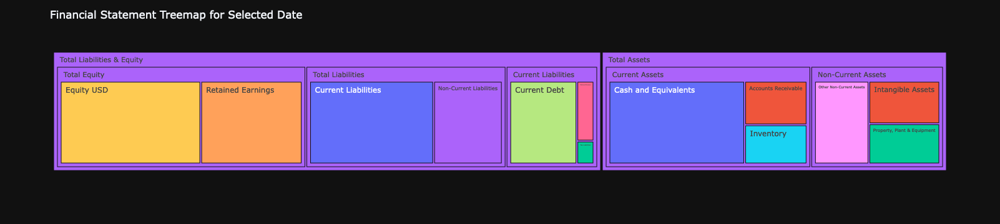

In [21]:
import pandas as pd
import plotly.express as px

# Assuming df_accounting is your DataFrame
selected_data = df_accounting.iloc[0]

# Prepare the data for Plotly Express with hierarchical relationships
data_for_plot = [
    # Assets
    {"level_1": "Total Assets", "level_2": "Current Assets", "level_3": "Cash and Equivalents", "value": selected_data["cash_equiv_usd"]},
    {"level_1": "Total Assets", "level_2": "Current Assets", "level_3": "Accounts Receivable", "value": selected_data["accounts_receivable"]},
    {"level_1": "Total Assets", "level_2": "Current Assets", "level_3": "Inventory", "value": selected_data["inventory_amount"]},
    {"level_1": "Total Assets", "level_2": "Non-Current Assets", "level_3": "Property, Plant & Equipment", "value": selected_data["property_plant_equipment_net"]},
    {"level_1": "Total Assets", "level_2": "Non-Current Assets", "level_3": "Intangible Assets", "value": selected_data["intangible_assets"]},
    {"level_1": "Total Assets", "level_2": "Non-Current Assets", "level_3": "Other Non-Current Assets", "value": selected_data["total_nonoperating_assets"]},

    # Liabilities & Equity
    {"level_1": "Total Liabilities & Equity", "level_2": "Total Equity", "level_3": "Retained Earnings", "value": selected_data["retained_earnings"]},
    {"level_1": "Total Liabilities & Equity", "level_2": "Total Equity", "level_3": "Equity USD", "value": selected_data["equity_usd"]},
    {"level_1": "Total Liabilities & Equity", "level_2": "Total Liabilities", "level_3": "Current Liabilities", "value": selected_data["current_liabilities"]},
    {"level_1": "Total Liabilities & Equity", "level_2": "Total Liabilities", "level_3": "Non-Current Liabilities", "value": selected_data["non_current_liabilities"]},
    {"level_1": "Total Liabilities & Equity", "level_2": "Current Liabilities", "level_3": "Current Debt", "value": selected_data["current_debt"]},
    {"level_1": "Total Liabilities & Equity", "level_2": "Current Liabilities", "level_3": "Deferred Revenue", "value": selected_data["deferred_revenue"]},
    {"level_1": "Total Liabilities & Equity", "level_2": "Current Liabilities", "level_3": "Tax Liabilities", "value": selected_data["tax_liabilities"]}
]

df_for_plot = pd.DataFrame(data_for_plot)

# Creating the treemap
fig = px.treemap(df_for_plot, 
                 path=['level_1', 'level_2', 'level_3'], 
                 values='value',
                 color='level_3')

fig.update_layout(title='Financial Statement Treemap for Selected Date')
fig.show()


In [82]:
import dash
from dash import dcc, html, Input, Output
import plotly.graph_objects as go
import pandas as pd

# Initialize the Dash app with a dark theme
app = dash.Dash(__name__, external_stylesheets=['https://codepen.io/chriddyp/pen/bWLwgP.css'])

# Custom styles for a dark theme
dark_theme_style = {
    'backgroundColor': '#1e1e1e',
    'color': '#ffffff',
    'padding': '10px',
    'borderRadius': '5px',
    'textAlign': 'center'  # Center text in buttons
}

# Custom style for reducing padding and margins
compact_layout_style = {
    'padding': '5px',
    'margin': '10px'
}

# Custom CSS for dark theme dropdown
dropdown_dark_theme_css = {
    'color': '#fff',
    'backgroundColor': '#333',
    'borderColor': '#555'
}

# App layout with updated styling
app.layout = html.Div([
    html.Div([
        dcc.Dropdown(
            id='ticker-dropdown',
            options=[{'label': ticker, 'value': ticker} for ticker in df_accounting.index.get_level_values('ticker').unique()],
            value=['AMZN'],  # Default value
            multi=True,
            style={'width': '40%', 'display': 'inline-block', 'marginRight': '10px', **dropdown_dark_theme_css}
        ),
        html.Button('Show All Cash Flows', id='show-all-btn', n_clicks=0, style=dark_theme_style),
        html.Button('Show Last 5 Years', id='show-5yrs-btn', n_clicks=0, style=dark_theme_style),
        html.Button('Toggle Cash Flow Categories', id='toggle-cf-btn', n_clicks=0, style=dark_theme_style)
    ], style=compact_layout_style),
    dcc.Graph(id='cash-flow-graph', style={'backgroundColor': '#1e1e1e'})
], style={'backgroundColor': '#1e1e1e', 'padding': '5px'})

# Callbacks and rest of the code remains the same


# Callback for updating the graph
@app.callback(
    Output('cash-flow-graph', 'figure'),
    [Input('ticker-dropdown', 'value'),
     Input('show-all-btn', 'n_clicks'),
     Input('show-5yrs-btn', 'n_clicks'),
     Input('toggle-cf-btn', 'n_clicks')],
    State('cash-flow-graph', 'figure')
)
def update_graph(selected_tickers, show_all_clicks, show_5yrs_clicks, toggle_cf_clicks, existing_figure):
    fig = go.Figure()

    for ticker in selected_tickers:
        filtered_df = df_accounting.xs(ticker, level='ticker')[[
            'net_cash_flow_operating', 'net_cash_flow_investing', 'net_cash_flow_financing', 'net_cash_flow'
        ]] / 13  # Adjusting for quarterly representation

        # Adding total net cash flow and highlighting it for each ticker
        fig.add_trace(go.Waterfall(
            name=f'{ticker} Total',
            measure=['relative'] * len(filtered_df),
            x=filtered_df.index,
            y=filtered_df['net_cash_flow'],
            textposition='outside',
            totals=dict(marker=dict(color='red'))  # Highlighting the total in red
        ))
        
        # Adding traces for operating, investing, and financing activities for each ticker
        for category in ['net_cash_flow_operating', 'net_cash_flow_investing', 'net_cash_flow_financing']:
            fig.add_trace(go.Waterfall(
                name=f'{ticker} {category}',
                measure=['relative'] * len(filtered_df),
                x=filtered_df.index,
                y=filtered_df[category],
                textposition='outside',
                visible='legendonly'  # Set to false if you want them hidden by default
            ))

    # Updating layout for readability
    fig.update_layout(
        title=f'{" & ".join(selected_tickers)} Cumulative Cash Flow',
        xaxis_title='Date',
        yaxis_title='Amount ($)',
        waterfallgroupgap=0.5,
        showlegend=True
    )

    # Determine which button was last clicked
    ctx = dash.callback_context
    if not ctx.triggered:
        button_id = 'No clicks yet'
    else:
        button_id = ctx.triggered[0]['prop_id'].split('.')[0]

    # Update the figure based on the button clicked
    if button_id == 'show-5yrs-btn':
        # Update the x-axis to show only the last 5 years
        fig.update_layout(xaxis_range=[datetime.now() - timedelta(weeks=260), datetime.now()])

    if button_id == 'toggle-cf-btn':
        # Toggle visibility of cash flow categories
        new_visibility = not existing_figure['data'][1]['visible']
        for trace in fig.data[1:]:
            trace.visible = new_visibility

    fig.update_layout(
        plot_bgcolor='#1e1e1e',
        paper_bgcolor='#1e1e1e',
        font=dict(color='white')
    )

    return fig

# Example usage
app_name = "cummulative_cash"

app.run_server(debug=True, port=get_unique_port(app_name))  # Use a different port for each app



In [84]:
import dash
from dash import dcc, html, Input, Output
import plotly.graph_objects as go
import pandas as pd

# Load your DataFrame here
# df_accounting = pd.read_csv('your_dataframe.csv')

app = dash.Dash(__name__, external_stylesheets=['https://codepen.io/chriddyp/pen/bWLwgP.css'])

app.layout = html.Div([
    html.Div([
        dcc.Dropdown(
            id='ticker-dropdown',
            options=[{'label': ticker, 'value': ticker} for ticker in df_accounting.index.get_level_values('ticker').unique()],
            value=['A'],  # Default value
            multi=True,
            style={'width': '40%', 'display': 'inline-block', 'marginRight': '10px'}
        ),
        dcc.Dropdown(
            id='asset-dropdown',
            options=[{'label': asset, 'value': asset} for asset in ['current_assets', 'non_current_assets', 'intangible_assets', 'cash_equiv_usd', 'inventory_amount', 'property_plant_equipment_net']],
            value=['current_assets', 'non_current_assets'],  # Default value
            multi=True,
            style={'width': '40%', 'display': 'inline-block'}
        ),
        dcc.RadioItems(
            id='plot-type',
            options=[
                {'label': 'Stacked Bar Plot', 'value': 'bar'},
                {'label': 'Line Plot', 'value': 'line'}
            ],
            value='bar',
            style={'width': '20%', 'display': 'inline-block'}
        )
    ]),
    html.Div(id='graphs-container')
])

@app.callback(
    Output('graphs-container', 'children'),
    [Input('ticker-dropdown', 'value'),
     Input('asset-dropdown', 'value'),
     Input('plot-type', 'value')]
)
def update_graph(selected_tickers, selected_assets, plot_type):
    graphs = []
    for ticker in selected_tickers:
        ticker_data = df_accounting.xs(ticker, level='ticker')
        grouped_data = ticker_data.groupby(ticker_data.index).mean()

        fig = go.Figure()

        if plot_type == 'bar':
            for asset_type in selected_assets:
                fig.add_trace(go.Bar(
                    x=grouped_data.index,
                    y=grouped_data[asset_type],
                    name=asset_type
                ))
            fig.update_layout(barmode='stack')
        elif plot_type == 'line':
            for asset_type in selected_assets:
                fig.add_trace(go.Scatter(
                    x=grouped_data.index,
                    y=grouped_data[asset_type],
                    mode='lines+markers',
                    name=asset_type
                ))

        fig.update_layout(
            title=f'{ticker} Asset Trends Over Time',
            xaxis_title='Date',
            yaxis_title='Asset Value (USD)',
            yaxis_type='linear',  # Change to 'log' if necessary
            legend_title='Asset Type'
        )

        graphs.append(dcc.Graph(figure=fig))
        graphs.append(html.Div(style={'borderBottom': '2px solid #ddd', 'margin': '20px 0'}))

    return graphs

# Example usage
app_name = "my_dash_app_2"

app.run_server(debug=True, port=get_unique_port(app_name))  # Use a different port for each app


In [83]:
import dash
from dash import dcc, html, Input, Output
import plotly.graph_objects as go
import pandas as pd

# Load your DataFrame here
# df_accounting = pd.read_csv('your_dataframe.csv')

app = dash.Dash(__name__, external_stylesheets=['https://codepen.io/chriddyp/pen/bWLwgP.css'])

app.layout = html.Div([
    html.Div([
        dcc.Dropdown(
            id='ticker-dropdown',
            options=[{'label': ticker, 'value': ticker} for ticker in df_accounting.index.get_level_values('ticker').unique()],
            value=['A'],  # Default value
            multi=True,
            style={'width': '40%', 'display': 'inline-block', 'marginRight': '10px'}
        ),
        dcc.Dropdown(
            id='asset-dropdown',
            options=[{'label': asset, 'value': asset} for asset in ['current_assets', 'non_current_assets', 'intangible_assets', 'cash_equiv_usd', 'inventory_amount', 'property_plant_equipment_net']],
            value=['current_assets', 'non_current_assets'],  # Default value
            multi=True,
            style={'width': '40%', 'display': 'inline-block'}
        )
    ]),
    html.Div(id='graphs-container')
])



@app.callback(
    Output('graphs-container', 'children'),
    [Input('ticker-dropdown', 'value'),
     Input('asset-dropdown', 'value')]
)
def update_graph(selected_tickers, selected_assets):
    graphs = []
    for i, ticker in enumerate(selected_tickers):
        ticker_data = df_accounting.xs(ticker, level='ticker')
        grouped_data = ticker_data.groupby(ticker_data.index).mean()

        fig = go.Figure()
        for asset_type in selected_assets:
            fig.add_trace(go.Bar(
                x=grouped_data.index,
                y=grouped_data[asset_type],
                name=asset_type,
                hoverinfo='y+name'
            ))

        fig.update_layout(
            title=f'Asset Composition Over Time for {ticker}',
            barmode='stack',
            xaxis_title='Date',
            yaxis_title='Asset Value',
            legend_title='Asset Type'
        )

        # Add each graph to the list
        graphs.append(dcc.Graph(figure=fig))

        # Add a horizontal line as a separator, except after the last graph
        if i < len(selected_tickers) - 1:
            graphs.append(html.Div(style={'borderBottom': '2px solid #ddd', 'margin': '20px 0'}))

    return graphs

@app.callback(
    Output('graphs-container', 'children'),
    [Input('ticker-dropdown', 'value'),
     Input('asset-dropdown', 'value')]
)
def update_graph(selected_tickers, selected_assets):
    graphs = []
    for ticker in selected_tickers:
        ticker_data = df_accounting.xs(ticker, level='ticker')
        grouped_data = ticker_data.groupby(ticker_data.index).mean()

        fig = go.Figure()
        for asset_type in selected_assets:
            fig.add_trace(go.Scatter(
                x=grouped_data.index,
                y=grouped_data[asset_type],
                mode='lines+markers',
                name=asset_type,
                hoverinfo='y+name'
            ))

        fig.update_layout(
            title=f'Asset Trends Over Time for {ticker}',
            xaxis_title='Date',
            yaxis_title='Asset Value (USD)',
            yaxis_type='log',  # Optional: set to 'linear' or 'log'
            legend_title='Asset Type'
        )

        graphs.append(dcc.Graph(figure=fig))
        graphs.append(html.Div(style={'borderBottom': '2px solid #ddd', 'margin': '20px 0'}))

    return graphs


# Example usage
app_name = "my_dash_app"

app.run_server(debug=True, port=get_unique_port(app_name))  # Use a different port for each app



In [64]:
import dash
from dash import dcc, html, Input, Output
import plotly.graph_objects as go
import pandas as pd
from datetime import datetime, timedelta

# Assuming df_accounting is your DataFrame containing the accounting data
# Read or prepare your dataframe here...

app = dash.Dash(__name__, external_stylesheets=['https://codepen.io/chriddyp/pen/bWLwgP.css'])

app.layout = html.Div([
    html.Div([
        dcc.Dropdown(
            id='ticker-dropdown',
            options=[{'label': ticker, 'value': ticker} for ticker in df_accounting.index.get_level_values('ticker').unique()],
            value=['A'],  # Default value
            multi=True,
            style={'width': '40%', 'display': 'inline-block', 'marginRight': '10px'}
        )
    ]),
    dcc.Graph(id='asset-composition-graph')
])

@app.callback(
    Output('asset-composition-graph', 'figure'),
    [Input('ticker-dropdown', 'value')]
)
def update_graph(selected_tickers):
    fig = go.Figure()

    for ticker in selected_tickers:
        ticker_data = df_accounting.xs(ticker, level='ticker')

        # Calculate total assets if not already present in the data
        if 'total_assets' not in ticker_data.columns:
            ticker_data['total_assets'] = ticker_data['current_assets'] + ticker_data['non_current_assets']

        fig.add_trace(go.Pie(
            labels=['Current Assets', 'Non-Current Assets', 'Intangible Assets'],
            values=[
                ticker_data['current_assets'].mean(),
                ticker_data['non_current_assets'].mean(),
                ticker_data['intangible_assets'].mean()
            ],
            name=ticker
        ))

    fig.update_layout(
        title='Asset Composition Analysis',
        showlegend=True
    )

    return fig

if __name__ == '__main__':
    app.run_server(debug=True)


In [43]:
import vizro.models as vm
import vizro.plotly.express as px
from vizro import Vizro
import pandas as pd

# Assuming 'df_accounting' is your DataFrame
# df_accounting = pd.read_csv('your_dataframe.csv')

# For demonstration, I'm using a sample dataset. Replace this with your actual data
df_accounting = px.data.gapminder().query("year == 2007")

# Creating a sunburst chart as an example. Replace with your actual chart logic
figure = px.sunburst(df_accounting, path=["continent", "country"], values="pop", color="lifeExp")

page = vm.Page(
    title="Financial Dashboard",
    description="Dashboard showing cash flows and other financial data",
    components=[
        vm.Graph(
            id="cash-flow-graph",
            figure=figure
        )
    ],
    controls=[
        vm.Filter(column="continent", targets=["cash-flow-graph"]),
        vm.Parameter(
            targets=["cash-flow-graph.color"], 
            selector=vm.RadioItems(options=["lifeExp", "pop"], title="Color")
        ),
    ],
)

dashboard = vm.Dashboard(pages=[page])

Vizro().build(dashboard).run()


In [14]:
df_accounting.query("ticker == 'AMZN'")

cash_short_term  operating_working_capital  \
ticker date                                                     
AMZN   2008-04-04     2.343200e+09              -9.972000e+08   
       2008-04-11     2.247100e+09              -9.141000e+08   
       2008-04-18     2.151000e+09              -8.310000e+08   
       2008-04-25     2.168615e+09              -8.377692e+08   
       2008-05-02     2.186231e+09              -8.445384e+08   
...                            ...                        ...   
       2023-12-29     6.416900e+10              -6.638800e+10   
       2024-01-05     6.416900e+10              -6.638800e+10   
       2024-01-12     6.416900e+10              -6.638800e+10   
       2024-01-19     6.416900e+10              -6.638800e+10   
       2024-01-26     6.416900e+10              -6.638800e+10   

                   total_nonoperating_assets  total_operating_assets  \
ticker date                                                            
AMZN   2008-04-04               7.856000e+08            2.647200e+09   
       2008-04-11               8.268000e+08            2.664600e+09   
       2008-04-18               8.680000e+08            2.682000e+09   
       2008-04-25               8.636154e+08            2.680846e+09   
       2008-05-02               8.592308e+08            2.679692e+09   
...                                      ...                     ...   
       2023-12-29               3.076170e+11            3.864430e+11   
       2024-01-05               3.076170e+11            3.864430e+11   
       2024-01-12               3.076170e+11            3.864430e+11   
       2024-01-19               3.076170e+11            3.864430e+11   
       2024-01-26               3.076170e+11            3.864430e+11   

                   accounts_receivable  cash_equiv_usd  cash_equivalents  \
ticker date                                                                
AMZN   2008-04-04         6.058000e+08    1.704600e+09      1.704600e+09   
       2008-04-11         5.934000e+08    1.600300e+09      1.600300e+09   
       2008-04-18         5.810000e+08    1.496000e+09      1.496000e+09   
       2008-04-25         5.813846e+08    1.500000e+09      1.500000e+09   
       2008-05-02         5.817692e+08    1.504000e+09      1.504000e+09   
...                                ...             ...               ...   
       2023-12-29         4.342000e+10    4.960500e+10      4.960500e+10   
       2024-01-05         4.342000e+10    4.960500e+10      4.960500e+10   
       2024-01-12         4.342000e+10    4.960500e+10      4.960500e+10   
       2024-01-19         4.342000e+10    4.960500e+10      4.960500e+10   
       2024-01-26         4.342000e+10    4.960500e+10      4.960500e+10   

                   current_assets  current_investments  intangible_assets  \
ticker date                                                                 
AMZN   2008-04-04    4.204800e+09         6.386000e+08       3.580000e+08   
       2008-04-11    4.084900e+09         6.468000e+08       3.750000e+08   
       2008-04-18    3.965000e+09         6.550000e+08       3.920000e+08   
       2008-04-25    3.985846e+09         6.686154e+08       3.926154e+08   
       2008-05-02    4.006692e+09         6.822308e+08       3.932308e+08   
...                           ...                  ...                ...   
       2023-12-29    1.429950e+11         1.456400e+10       2.274900e+10   
       2024-01-05    1.429950e+11         1.456400e+10       2.274900e+10   
       2024-01-12    1.429950e+11         1.456400e+10       2.274900e+10   
       2024-01-19    1.429950e+11         1.456400e+10       2.274900e+10   
       2024-01-26    1.429950e+11         1.456400e+10       2.274900e+10   

                   inventory_amount  non_current_assets  \
ticker date                                               
AMZN   2008-04-04      1.101600e+09        1.798600e+09   
       2008-04-11      1.089300e+09        1.858300e+09   
       20

In [6]:
df_accounting.head()

cash_short_term  operating_working_capital  \
ticker date                                                     
A      2008-04-04     3.222461e+09                672384640.0   
       2008-04-11     3.235154e+09                659461568.0   
       2008-04-18     3.247846e+09                646538432.0   
       2008-04-25     3.260538e+09                633615360.0   
       2008-05-02     3.273231e+09                620692288.0   

                   total_nonoperating_assets  total_operating_assets  \
ticker date                                                            
A      2008-04-04               1.270231e+09            3.162000e+09   
       2008-04-11               1.278077e+09            3.166000e+09   
       2008-04-18               1.285923e+09            3.170000e+09   
       2008-04-25               1.293769e+09            3.174000e+09   
       2008-05-02               1.301615e+09            3.178000e+09   

                   accounts_receivable  cash_equiv_usd  cash_equivalents  \
ticker date                                                                
A      2008-04-04          751000000.0    3.105077e+09      3.105077e+09   
       2008-04-11          756000000.0    3.128692e+09      3.128692e+09   
       2008-04-18          761000000.0    3.152308e+09      3.152308e+09   
       2008-04-25          766000000.0    3.175923e+09      3.175923e+09   
       2008-05-02          771000000.0    3.199538e+09      3.199538e+09   

                   current_assets  current_investments  intangible_assets  \
ticker date                                                                 
A      2008-04-04    5.114231e+09          117384616.0        851000000.0   
       2008-04-11    5.123077e+09          106461536.0        853000000.0   
       2008-04-18    5.131923e+09           95538464.0        855000000.0   
       2008-04-25    5.140769e+09           84615384.0        857000000.0   
       2008-05-02    5.149616e+09           73692304.0        859000000.0   

                   inventory_amount  non_current_assets  \
ticker date                                               
A      2008-04-04       674000000.0        2.427462e+09   
       2008-04-11       674000000.0        2.435154e+09   
       2008-04-18       674000000.0        2.442846e+09   
       2008-04-25       674000000.0        2.450538e+09   
       2008-05-02       674000000.0        2.458231e+09   

                   non_current_investments  property_plant_equipment_net  \
ticker date                                                                
A      2008-04-04              105384616.0                   804076928.0   
       2008-04-11              126461536.0                   804692288.0   
       2008-04-18              147538464.0                   805307712.0   
       2008-04-25              168615392.0                   805923072.0   
       2008-05-02              189692304.0                   806538432.0   

                   tax_assets  total_assets  total_investments  \
ticker date                                                      
A      2008-04-04         0.0  7.541692e+09        222769232.0   
       2008-04-11         0.0  7.558231e+09        232923072.0   
       2008-04-18         0.0  7.574769e+09        243076928.0   
       2008-04-25         0.0  7.591308e+09        253230768.0   
       2008-05-02         0.0  7.607846e+09        263384608.0   

                   accum_other_comp_income  adjusted_parent_equity  \
ticker date                                                          
A      2008-04-04              453615392.0            3.166461e+09   
       2008-04-11              456538464.0            3.165154e+09   
       2008-04-18              459461536.0            3.163846e+09   
       2008-04-25              462384608.0            3.162538e+09   
       2008-05-02              465307680.0            3.161231e+09   

                   book_equity_value    equity_usd  retained_earnings  \
ticker date

In [ ]:
might be better off treating each of the 4 quarters as independent and predicting them separately.

In [10]:
import pandas as pd
from darts.models import TiDEModel
from darts.dataprocessing.transformers import Scaler
from darts import TimeSeries

def neural_forecast(df_accounting, variable='total_revenue', weeks=52):
    # Prepare the Data
    df_wide = df_accounting.unstack(level='ticker')[variable].astype('float32')  # Ensure data is float32

    df_wide = df_wide.where(df_wide.notna(), df_wide.mean(axis=1), axis=0)


    # Scale the Data
    scaler = Scaler()
    all_data = TimeSeries.from_dataframe(df_wide)
    scaled_all_data = scaler.fit_transform(all_data)

    # Set lookback period to be five times the horizon
    lookback = weeks * 5

    # Initialize and Train TiDEModel
    tide = TiDEModel(input_chunk_length=lookback, output_chunk_length=weeks)
    tide.fit(scaled_all_data, epochs=1000)  # Increase epochs for better performance

    # Make Prediction
    scaled_pred_tide = tide.predict(n=weeks)
    pred_tide = scaler.inverse_transform(scaled_pred_tide)

    # Post-Processing
    preds_df = pred_tide.pd_dataframe()

    # Melt the wide DataFrame to long format
    long_df = preds_df.reset_index().melt(
        id_vars=['date'], var_name='ticker', value_name=variable
    )

    return preds_df

# Example usage
# forecasts_df = neural_forecast(df_accounting, variable='total_revenue', months=12)


# Example usage
forecasts_df = neural_forecast(df_accounting, variable='total_revenue', weeks=52)


GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs

  | Name             | Type             | Params
------------------------------------------------------
0 | criterion        | MSELoss          | 0     
1 | train_metrics    | MetricCollection | 0     
2 | val_metrics      | MetricCollection | 0     
3 | encoders         | Sequential       | 482 K 
4 | decoders         | Sequential       | 231 K 
5 | temporal_decoder | _ResidualBlock   | 894   
6 | lookback_skip    | Linear           | 13.6 K
------------------------------------------------------
728 K     Trainable params
0         Non-trainable params
728 K     Total params
2.913     Total estimated model params size (MB)


Training: |                                                                                                   …

`Trainer.fit` stopped: `max_epochs=1000` reached.
GPU available: True (mps), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs


Predicting: |                                                                                                 …

In [14]:
df_wide = df_accounting.unstack(level='ticker')["total_revenue"].astype('float32')  # Ensure data is float32

df_wide = df_wide.where(df_wide.notna(), df_wide.mean(axis=1), axis=0)

In [16]:
df_total = pd.concat((df_wide, forecasts_df),axis=0)

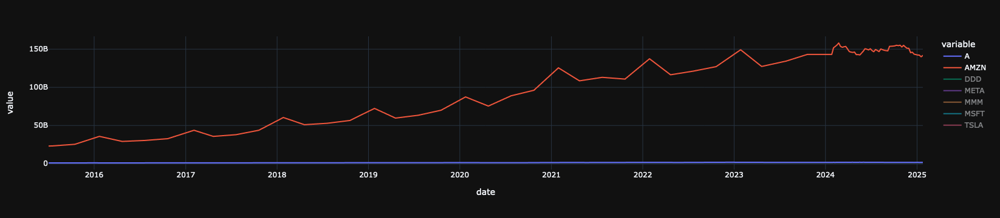

[rank: 0] Received SIGTERM: 15


In [19]:
df_total.tail(500).plot()

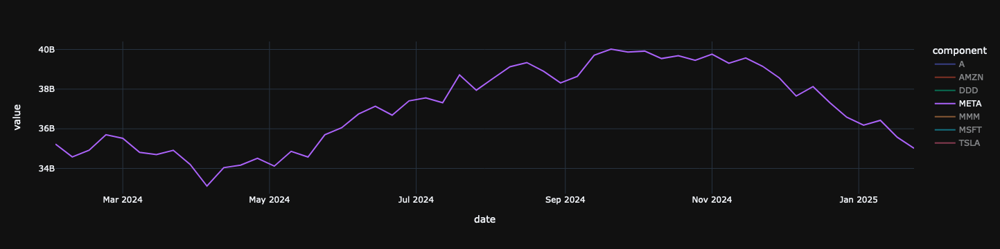

In [12]:
forecasts_df.plot()

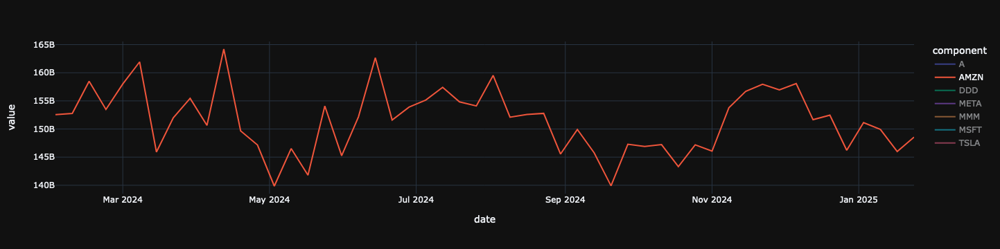

In [9]:
forecasts_df.plot()

In [6]:
df_accounting.get_latest()

,,accounts_receivable,cash_equiv_usd,cash_equivalents,current_assets,current_investments,intangible_assets,inventory_amount,non_current_assets,non_current_investments,property_plant_equipment_net,tax_assets,total_assets,total_investments,accum_other_comp_income,equity_usd,retained_earnings,total_equity,accounts_payable,bank_deposits,current_debt,current_liabilities,debt_usd,deferred_revenue,non_current_debt,non_current_liabilities,tax_liabilities,total_debt,total_liabilities,capital_expenditures,depreciation_amortization,net_cash_acquisitions_disposals,net_cash_flow,net_cash_flow_business,net_cash_flow_common,net_cash_flow_debt,net_cash_flow_dividends,net_cash_flow_financing,net_cash_flow_fx,net_cash_flow_investing,net_cash_flow_operating,stock_based_compensation,basic_shares,share_factor,stock_price,diluted_eps,earnings_per_share,eps_usd,weighted_avg_diluted_shares,weighted_avg_shares,cost_of_revenue,dividends_per_share,interest_expense,operating_expenses,preferred_dividends,research_development_expenses,selling_general_admin_expenses,tax_expenses,consolidated_income,ebit,ebit_usd,gross_profit,net_income,net_income_common_stock,net_income_common_stock_usd,net_income_discontinued_ops,net_income_non_controlling_int,operating_income,revenue_usd,total_revenue,tangible_assets,working_capital,free_cash_flow,book_value_per_share,forex_usd,free_cash_flow_per_share,sales_per_share,tangible_book_value_per_share,invested_capital,current_ratio,dividend_payout_ratio,earnings_before_tax,ebitda,ebitda_margin,ebitda_usd,gross_profit_margin,net_profit_margin,de_ratio,dividend_yield,enterprise_value,ev_to_ebit,ev_to_ebitda,market_capitalization,price_to_book_ratio,price_to_earnings_ratio,price_to_earnings_ratio1,price_to_sales_ratio,price_to_sales_ratio1,average_assets
ticker,date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
AMZN,2023-11-30,4.342000e+10,4.960500e+10,4.960500e+10,1.429950e+11,1.456400e+10,2.274900e+10,3.540600e+10,3.438880e+11,0.000000e+00,2.672260e+11,0.0,4.868830e+11,1.456400e+10,-5.003000e+09,1.829730e+11,1.029940e+11,1.829730e+11,7.200400e+10,0.0,0.000000e+00,1.452140e+11,1.369890e+11,1.439800e+10,1.369890e+11,1.586960e+11,0.000000e+00,1.369890e+11,3.039100e+11,-1.129800e+10,1.213100e+10,1.174000e+09,1.400000e+07,-1.629000e+09,0.000000e+00,-8.948000e+09,0.000000e+00,-8.948000e+09,-502000000.0,-1.175300e+10,2.121700e+10,5.829000e+09,1.033403e+10,1.0,127.739998,0.94,0.96,0.96,1.055800e+10,1.032200e+10,7.502200e+10,0.00,806000000.0,5.687300e+10,0.0,2.120300e+10,1.311200e+10,2.306000e+09,9.879000e+09,1.299100e+10,1.299100e+10,6.806100e+10,9.879000e+09,9.879000e+09,9.879000e+09,0.0,0.0,1.118800e+10,1.430830e+11,1.430830e+11,4.641340e+11,-2.219000e+09,9.919000e+09,17.726999,1.0,0.961,13.862,44.966000,4.063040e+11,0.985,0.000,1.218500e+10,2.512200e+10,0.176,2.512200e+10,0.476,0.069,1.661,0.000,1.407453e+12,54.0,19.004000,1.320069e+12,7.215,65.744003,65.508003,2.383,2.380,4.728858e+11
MSFT,2023-11-30,3.695300e+10,1.439510e+11,1.439510e+11,2.075860e+11,0.000000e+00,7.668500e+10,3.000000e+09,2.381990e+11,1.142300e+10,1.179370e+11,0.0,4.457850e+11,1.142300e+10,-6.937000e+09,2.207140e+11,1.321430e+11,2.207140e+11,1.930700e+10,0.0,2.955600e+10,1.247920e+11,8.498900e+10,4.918800e+10,5.543300e+10,1.002790e+11,3.148800e+10,8.498900e+10,2.250710e+11,-9.917000e+09,3.921000e+09,1.258800e+10,4.574800e+10,-1.186000e+09,-4.146000e+09,2.426500e+10,-5.051000e+09,1.476100e+10,-99000000.0,5.030000e+08,3.058300e+10,2.507000e+09,7.432262e+09,1.0,330.529999,2.99,3.00,3.00,7.462000e+09,7.429000e+09,1.630200e+10,0.68,525000000.0,1.332000e+10,0.0,6.659000e+09,6.661000e+09,4.993000e+09,2.229100e+10,2.780900e+10,2.780900e+10,4.021500e+10,2.229100e+10,2.229100e+10,2.229100e+10,0.0,0.0,2.689500e+10,5.651700e+10,5.651700e+10,3.691000e+11,8.279400e+10,2.066600e+10,29.709999,1.0,2.782,7.608,49.683998,1.853460e+11,1.663,0.227,2.728400e+10,3.173000e+10,0.561,3.173000e+10,0.712,0.394,1.020,0.008,2.397624e+12,25.0

In [8]:
df_accounting.percentile()

accounts_receivable  cash_equiv_usd  cash_equivalents  \
ticker date                                                                
AMZN   2008-03-31             0.500000        0.500000          0.500000   
       2008-04-30             0.500000        0.500000          0.500000   
       2008-05-31             0.500000        0.500000          0.500000   
       2008-06-30             0.500000        0.500000          0.500000   
       2008-07-31             0.500000        0.500000          0.500000   
...                                ...             ...               ...   
TSLA   2023-07-31             0.333333        0.333333          0.333333   
       2023-08-31             0.333333        0.333333          0.333333   
       2023-09-30             0.333333        0.333333          0.333333   
       2023-10-31             0.333333        0.333333          0.333333   
       2023-11-30             0.333333        0.333333          0.333333   

                   current_assets  current_investments  intangible_assets  \
ticker date                                                                 
AMZN   2008-03-31        0.500000             1.000000           0.500000   
       2008-04-30        0.500000             1.000000           0.500000   
       2008-05-31        0.500000             1.000000           0.500000   
       2008-06-30        0.500000             1.000000           0.500000   
       2008-07-31        0.500000             1.000000           0.500000   
...                           ...                  ...                ...   
TSLA   2023-07-31        0.333333             0.666667           0.333333   
       2023-08-31        0.333333             0.666667           0.333333   
       2023-09-30        0.333333             0.666667           0.333333   
       2023-10-31        0.333333             0.666667           0.333333   
       2023-11-30        0.333333             0.666667           0.333333   

                   inventory_amount  non_current_assets  \
ticker date                                               
AMZN   2008-03-31          1.000000            0.500000   
       2008-04-30          1.000000            0.500000   
       2008-05-31          1.000000            0.500000   
       2008-06-30          1.000000            0.500000   
       2008-07-31          1.000000            0.500000   
...                             ...                 ...   
TSLA   2023-07-31          0.666667            0.333333   
       2023-08-31          0.666667            0.333333   
       2023-09-30          0.666667            0.333333   
       2023-10-31          0.666667            0.333333   
       2023-11-30          0.666667            0.333333   

                   non_current_investments  property_plant_equipment_net  \
ticker date                                                                
AMZN   2008-03-31                 0.500000                      0.500000   
       2008-04-30                 0.500000                      0.500000   
       2008-05-31                 0.500000                      0.500000   
       2008-06-30                 0.500000                      0.500000   
       2008-07-31                 0.500000                      0.500000   
...                                    ...                           ...   
TSLA   2023-07-31                 0.666667                      0.333333   
       2023-08-31                 0.666667                      0.333333   
       2023-09-30                 0.666667                      0.333333   
       2023-10-31                 0.666667                      0.333333   
       2023-11-30                 0.666667                      0.333333   

                   tax_assets  total_assets  total_investments  \
ticker date                                                      
AMZN   2008-03-31    0.500000      0.500000           0.500000   
       2008-04-30    0.500000      0.500000           0.500000   
       

In [11]:
df_accounting.distance(on="ticker")

ticker,AMZN,MSFT,TSLA
ticker,,,
AMZN,9.323334e-15,0.586671,0.707295
MSFT,5.866706e-01,0.000000,1.000000
TSLA,7.072949e-01,1.000000,0.000000


In [10]:
df_accounting.distance(on="date")

date,2008-03-31,2008-04-30,2008-05-31,2008-06-30,2008-07-31,2008-08-31,2008-09-30,2008-10-31,2008-11-30,2008-12-31,2009-01-31,2009-02-28,2009-03-31,2009-04-30,2009-05-31,2009-06-30,2009-07-31,2009-08-31,2009-09-30,2009-10-31,2009-11-30,2009-12-31,2010-01-31,2010-02-28,2010-03-31,2010-04-30,2010-05-31,2010-06-30,2010-07-31,2010-08-31,2010-09-30,2010-10-31,2010-11-30,2010-12-31,2011-01-31,2011-02-28,2011-03-31,2011-04-30,2011-05-31,2011-06-30,2011-07-31,2011-08-31,2011-09-30,2011-10-31,2011-11-30,2011-12-31,2012-01-31,2012-02-29,2012-03-31,2012-04-30,2012-05-31,2012-06-30,2012-07-31,2012-08-31,2012-09-30,2012-10-31,2012-11-30,2012-12-31,2013-01-31,2013-02-28,2013-03-31,2013-04-30,2013-05-31,2013-06-30,2013-07-31,2013-08-31,2013-09-30,2013-10-31,2013-11-30,2013-12-31,2014-01-31,2014-02-28,2014-03-31,2014-04-30,2014-05-31,2014-06-30,2014-07-31,2014-08-31,2014-09-30,2014-10-31,2014-11-30,2014-12-31,2015-01-31,2015-02-28,2015-03-31,2015-04-30,2015-05-31,2015-06-30,2015-07-31,2015-08-31,2015-09-30,2015-10-31,2015-11-30,2015-12-31,2016-01-31,2016-02-29,2016-03-31,2016-04-30,2016-05-31,2016-06-30,2016-07-31,2016-08-31,2016-09-30,2016-10-31,2016-11-30,2016-12-31,2017-01-31,2017-02-28,2017-03-31,2017-04-30,2017-05-31,2017-06-30,2017-07-31,2017-08-31,2017-09-30,2017-10-31,2017-11-30,2017-12-31,2018-01-31,2018-02-28,2018-03-31,2018-04-30,2018-05-31,2018-06-30,2018-07-31,2018-08-31,2018-09-30,2018-10-31,2018-11-30,2018-12-31,2019-01-31,2019-02-28,2019-03-31,2019-04-30,2019-05-31,2019-06-30,2019-07-31,2019-08-31,2019-09-30,2019-10-31,2019-11-30,2019-12-31,2020-01-31,2020-02-29,2020-03-31,2020-04-30,2020-05-31,2020-06-30,2020-07-31,2020-08-31,2020-09-30,2020-10-31,2020-11-30,2020-12-31,2021-01-31,2021-02-28,2021-03-31,2021-04-30,2021-05-31,2021-06-30,2021-07-31,2021-08-31,2021-09-30,2021-10-31,2021-11-30,2021-12-31,2022-01-31,2022-02-28,2022-03-31,2022-04-30,2022-05-31,2022-06-30,2022-07-31,2022-08-31,2022-09-30,2022-10-31,2022-11-30,2022-12-31,2023-01-31,2023-02-28,2023-03-31,2023-04-30,2023-05-31,2023-06-30,2023-07-31,2023-08-31,2023-09-30,2023-10-31,2023-11-30
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2008-03-31,4.334036e-15,8.497275e-04,5.756876e-03,1.960968e-02,4.577914e-02,0.060784,0.081397,0.109400,0.162861,0.237237,0.338349,0.283657,0.239226,0.203537,0.172005,0.148726,0.131672,0.102954,0.081556,0.065827,0.069071,0.074638,0.082313,0.069681,0.058492,0.052485,0.079835,0.119613,0.175573,0.174862,0.175704,0.177943,0.173418,0.171186,0.170642,0.193306,0.219787,0.249276,0.253549,0.257889,0.265150,0.293442,0.322191,0.353695,0.362074,0.373635,0.387416,0.401545,0.336295,0.285250,0.306882,0.333348,0.364243,0.367747,0.370628,0.374797,0.419943,0.470133,0.523881,0.532163,0.541854,0.543289,0.486613,0.436422,0.393430,0.357104,0.333024,0.311266,0.338915,0.355734,0.373683,0.358845,0.367782,0.377950,0.374479,0.356075,0.340187,0.339778,0.345646,0.351977,0.353391,0.358210,0.363942,0.363946,0.359932,0.357838,0.321773,0.293535,0.270001,0.250276,0.233963,0.219508,0.233604,0.250615,0.268615,0.245758,0.222825,0.203227,0.201891,0.201730,0.202117,0.232681,0.267166,0.303846,0.283498,0.269305,0.259544,0.261390,0.244691,0.228970,0.222537,0.216870,0.211683,0.224614,0.238514,0.253821,0.225230,0.199520,0.180190,0.166778,0.156604,0.149537,0.138995,0.130514,0.123711,0.123974,0.129655,0.137354,0.136095,0.135444,0.134989,0.128885,0.132543,0.140755,0.140237,0.139924,0.139802,0.141417,0.145148,0.149571,0.136848,0.128099,0.122303,0.120915,0.120461,0.120487,0.121339,0.125345,0.132129,0.132497,0.132957,0.133502,0.136552,0.140021,0.143764,0.148692,0.151617,0.154887,0.152078,0.149696,0.147720,0.154718,0.161771,0.168806,0.162242,0.156271,0.150978,0.147619,0.147172,0.148360,0.147664,0.147225,0.147046,0.147659,0.151993,0.161297,0.168057,0.176182,0.185766,0.183161,0.181136,0.179777,0.163529,0.154455,1.502477e-01,1.493257e-01,1.505363e

In [12]:
df_accounting.relative_distance(on="ticker")

ticker,AMZN,MSFT,TSLA
ticker,,,
AMZN,0.000000,0.619859,0.762533
MSFT,0.619859,0.000000,1.000000
TSLA,0.762533,1.000000,0.000000


In [13]:
df_accounting.relative_distance(on="date")

date,2008-03-31,2008-04-30,2008-05-31,2008-06-30,2008-07-31,2008-08-31,2008-09-30,2008-10-31,2008-11-30,2008-12-31,2009-01-31,2009-02-28,2009-03-31,2009-04-30,2009-05-31,2009-06-30,2009-07-31,2009-08-31,2009-09-30,2009-10-31,2009-11-30,2009-12-31,2010-01-31,2010-02-28,2010-03-31,2010-04-30,2010-05-31,2010-06-30,2010-07-31,2010-08-31,2010-09-30,2010-10-31,2010-11-30,2010-12-31,2011-01-31,2011-02-28,2011-03-31,2011-04-30,2011-05-31,2011-06-30,2011-07-31,2011-08-31,2011-09-30,2011-10-31,2011-11-30,2011-12-31,2012-01-31,2012-02-29,2012-03-31,2012-04-30,2012-05-31,2012-06-30,2012-07-31,2012-08-31,2012-09-30,2012-10-31,2012-11-30,2012-12-31,2013-01-31,2013-02-28,2013-03-31,2013-04-30,2013-05-31,2013-06-30,2013-07-31,2013-08-31,2013-09-30,2013-10-31,2013-11-30,2013-12-31,2014-01-31,2014-02-28,2014-03-31,2014-04-30,2014-05-31,2014-06-30,2014-07-31,2014-08-31,2014-09-30,2014-10-31,2014-11-30,2014-12-31,2015-01-31,2015-02-28,2015-03-31,2015-04-30,2015-05-31,2015-06-30,2015-07-31,2015-08-31,2015-09-30,2015-10-31,2015-11-30,2015-12-31,2016-01-31,2016-02-29,2016-03-31,2016-04-30,2016-05-31,2016-06-30,2016-07-31,2016-08-31,2016-09-30,2016-10-31,2016-11-30,2016-12-31,2017-01-31,2017-02-28,2017-03-31,2017-04-30,2017-05-31,2017-06-30,2017-07-31,2017-08-31,2017-09-30,2017-10-31,2017-11-30,2017-12-31,2018-01-31,2018-02-28,2018-03-31,2018-04-30,2018-05-31,2018-06-30,2018-07-31,2018-08-31,2018-09-30,2018-10-31,2018-11-30,2018-12-31,2019-01-31,2019-02-28,2019-03-31,2019-04-30,2019-05-31,2019-06-30,2019-07-31,2019-08-31,2019-09-30,2019-10-31,2019-11-30,2019-12-31,2020-01-31,2020-02-29,2020-03-31,2020-04-30,2020-05-31,2020-06-30,2020-07-31,2020-08-31,2020-09-30,2020-10-31,2020-11-30,2020-12-31,2021-01-31,2021-02-28,2021-03-31,2021-04-30,2021-05-31,2021-06-30,2021-07-31,2021-08-31,2021-09-30,2021-10-31,2021-11-30,2021-12-31,2022-01-31,2022-02-28,2022-03-31,2022-04-30,2022-05-31,2022-06-30,2022-07-31,2022-08-31,2022-09-30,2022-10-31,2022-11-30,2022-12-31,2023-01-31,2023-02-28,2023-03-31,2023-04-30,2023-05-31,2023-06-30,2023-07-31,2023-08-31,2023-09-30,2023-10-31,2023-11-30
date,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2008-03-31,7.462022e-09,1.851831e-02,7.584089e-02,1.347501e-01,1.963829e-01,0.223194,0.252879,0.287078,0.361851,0.452745,0.570220,0.512028,0.465233,0.426503,0.391775,0.365495,0.344459,0.314439,0.287236,0.261633,0.270534,0.277514,0.282883,0.268013,0.249483,0.233700,0.283572,0.335828,0.394159,0.392899,0.391508,0.389806,0.385835,0.381487,0.376571,0.400197,0.423257,0.445937,0.449695,0.452586,0.457349,0.483610,0.509921,0.538738,0.545282,0.553016,0.561296,0.577231,0.515037,0.463821,0.487606,0.513027,0.540467,0.547634,0.553198,0.558978,0.597818,0.640574,0.686902,0.692959,0.699757,0.697725,0.640025,0.590389,0.548911,0.516202,0.494629,0.474869,0.494999,0.503767,0.512350,0.499115,0.504336,0.509641,0.506799,0.491220,0.477003,0.477086,0.481804,0.486563,0.485413,0.485916,0.486333,0.481593,0.472324,0.463160,0.434196,0.409798,0.387094,0.374592,0.363832,0.353265,0.360435,0.368119,0.375418,0.356589,0.336548,0.317653,0.314923,0.313053,0.310830,0.323484,0.337812,0.353482,0.338180,0.321106,0.303983,0.304496,0.286132,0.266792,0.262858,0.259813,0.256820,0.256558,0.254167,0.250723,0.233072,0.215870,0.200772,0.194564,0.187004,0.180289,0.177053,0.174755,0.173727,0.173658,0.176863,0.183143,0.183965,0.184980,0.185949,0.183597,0.177167,0.184322,0.182740,0.181436,0.180370,0.179357,0.179702,0.180482,0.179339,0.182287,0.188897,0.197976,0.204735,0.212198,0.234836,0.277132,0.319641,0.318589,0.317646,0.316805,0.338829,0.360225,0.380874,0.406419,0.413335,0.420533,0.404265,0.388903,0.374406,0.401241,0.427123,0.452012,0.424166,0.396696,0.369717,0.349185,0.332881,0.317211,0.307788,0.298729,0.290029,0.256602,0.225896,0.199318,0.189711,0.181594,0.175033,0.175327,0.179474,0.184223,0.206842,0.234218,2.641362e-01,0.256413,0.231409,2.09

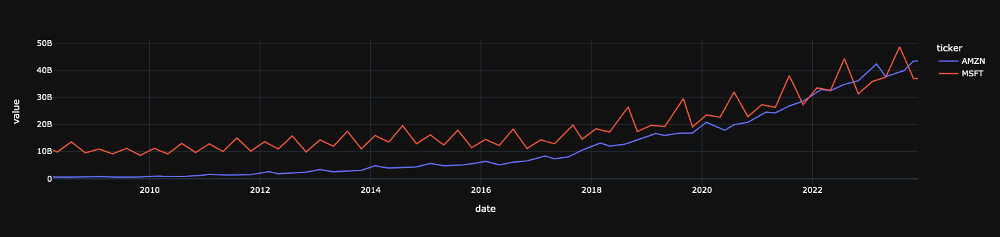

In [7]:
df_accounting.loc[['AMZN', 'MSFT'], 'accounts_receivable'].unstack(level=0).plot()

In [8]:
df_accounting = sov.data("accounting/monthly")

/accounting/monthly
Requesting URL: https://fastapi-sovai-y7o724zyfq-uc.a.run.app/accounting/monthly with params: None
Response Status: 200
Response Content-Type: application/json
tickers is None
None
tickers is: 
All ticker Initialized
https://s3.wasabisys.com/sovai-accounting/processed/accounting_monthly_interpolated.parq?AWSAccessKeyId=KI07G4DK9XP5EC0NH1VU&Signature=8iPAmoE3EDRv9mS%2B9g60bOaWPjk%3D&Expires=1706733046  (download link)


In [11]:
df_accounting.shape

(1762124, 100)